In [1]:
import lightkurve as lk
from lightkurve_ext import of_sector, of_sectors, of_2min_cadences, of_lcs
import lightkurve_ext as lke
import lightkurve_ext_tess as lket
import tic_plot as tplt
from lightkurve_ext import TransitTimeSpec, TransitTimeSpecList
import lightkurve_ext_pg as lke_pg
import lightkurve_ext_pg_runner as lke_pg_runner

import asyncio_compat

import math
import time
from types import SimpleNamespace
import warnings

import numpy as np
import matplotlib.pyplot as plt
import matplotlib as matplotlib

import pandas as pd
import astropy as astropy
from astropy import units as u
from astropy.time import Time
from astropy.io import fits

from matplotlib.ticker import (FormatStrFormatter, AutoMinorLocator)

import sys
if "../src" not in sys.path:
    sys.path.append("../src")

import catalog_utils  # from ../src , for accessing various metadata about a TIC

import vetting_utils  # helpers specific for vetting

from importlib import reload # useful during development to reload packages

from IPython.display import display, HTML, Javascript, Markdown
display(HTML("<style>.container { width:99% !important; }</style>"));

display(Javascript("""
// export notebook url to Python for bokeh-based interactive features
IPython.notebook.kernel.execute(`notebook_url = "${window.location.origin}"`);
"""));

%matplotlib inline


<IPython.core.display.Javascript object>

In [2]:
%%javascript
// TODO: revise menu, add keyboard shortcut

// a menu to jump to specific section easily
function addSideNav() {
    let ctr = document.getElementById('nav-ctr');
    if (ctr) { ctr.remove(); }
    const sections = [
        ['#input-tic', 'Enter TIC...'],
        ['#tic-metadata', ['TIC Metadata']],
        ['#lc-all', 'Lightcurves - all'],
        ['#lc-interactive', 'Interactive'],
        ['#lc-zoomed-in', 'Zoomed-in'],
        ['#lc-fold', 'Folded LC'],
        ['#lc-period', "Add. Variability"],
        ['#lc-background-sso', 'Background'],
        ['#tpf_download', 'TPF Download'],
        ['#tpf_zoom_in', 'TPF Zoom in'],
        ['#reports', 'Reports'],
        ['#external_docs', "External Info"]
    ];
    // avoid and arrow functions and string with backslash n 
    // they cause parsing failure with jupyter's display(HTML())
    function toASection(sec) {
      return `              <li><a href="${sec[0]}">${sec[1]}</a></li>`;
    }
    const sectionsHTML = 
        sections.map(toASection).join(`
`);
    document.body.insertAdjacentHTML('beforeend', `
<div id="nav-ctr">
    <style>
        #nav-side {
            position: fixed; right: 2.5vh; top: 2.5em; z-index: 999;
            background-color: #feefc3; border: 1px solid lightgray; border-radius: 10%;
            padding: 0.25em 2ch 0.25em 0.5ch;        
        }
        #nav-side.expand {
            padding: 0.25em 2ch;                
        }
        #nav-side-expand {
            display: none;
        }
        .expand #nav-side-expand {
            display: block;
        }
        #nav-side-ctl-hideshow:before {
            content: "<<";
        }
        .expand #nav-side-ctl-hideshow:before {
            content: ">>";
        }
    </style>
    <div id="nav-side" class="expand"
         style="">
        <div id="nav-side-ctl-hideshow" style="float: right; cursor: pointer;" onclick="this.parentElement.classList.toggle('expand');"></div>
        <div id="nav-side-expand">
            EB Vetting
            <ol>
${sectionsHTML}
            </ol>
        <div id="nav-side-expand">
    </div>
</div>
`);

    // Assign keyboard shortcut to jump to the sections, Alt-1, 2, etc.
    Array.from(document.querySelectorAll('#nav-side-expand li > a'), (a, i) => {
        if (i <= 8) {
          a.accessKey = i + 1;        
        }
    });    
}
addSideNav();

<IPython.core.display.Javascript object>

## Enter TIC, sector, subject
<a name="input-tic">

In [13]:
# lightkurve config
lk_download_dir = "data"

# Run All Above and this cell to start
#
# TIC   : the TIC to be vetted
# sector: the sector that the notebook would use by default as the focus,
#         the lightcurves from all other sectors would be downloaded as well.
#         TPF of the given sector will be downloaded
# subject: an example subject on Planet Hunters TESS for the TIC, usually from the sector above.

# FILL-IN: 
tic, sector, subject = 281581467, 27, 60853074  

max_num_sectors_to_download = None  #  None to download all sectors. Otherwise set it to a number to cap it, with the supplied sector as the centor of the slice to donwload
to_download_tpf_async = True
to_show_tic_meta = True


# def limit_sr_to_download(sr):
#     # used to limit data from cycle 1 - 3, but for vetting purpose, we use full data set
#     # sr = lk.SearchResult(sr.table[sr.table["sequence_number"] <= 39])
#     if max_num_sectors_to_download is None:
#             return sr
#     return lke.of_sector_n_around(sr, sector, num_additions=max_num_sectors_to_download-1)


# customized sector limiting
def limit_sr_to_download(sr):
    tab = sr.table
    # for now we skip the few long-cadence sectors in 60 range so that I operate on the same dataset
    tab = tab[tab["sequence_number"] <= 39]  
    return lk.SearchResult(tab)


try:    
    lcf_coll, sr, sr_unfiltered = lke.download_lightcurves_of_tic_with_priority(tic, 
                                                                                download_filter_func=limit_sr_to_download, download_dir=lk_download_dir,
                                                                                author_priority=["SPOC", "TESS-SPOC", "QLP"],
                                                                               )
    lcf_coll_original = lcf_coll  # retain a reference to the downloaded collection in case I modify it later
finally:
    tplt.beep()  # a beep to remind the users that the data has been downloaded


# Start downloading TPF asycnhronously while the user inspects the lightcurve
# Users can jump to "TPF Download" section to access the result
tpf_task = None
if to_download_tpf_async:
    tpf_task = lke.create_download_tpf_task(f"TIC{tic}", sector=sector, exptime="short", author='SPOC', mission="TESS", download_dir=lk_download_dir)


metadata_html_task = None  # load TCEs asycnhronously  while the user inspects the lightcurve
if to_show_tic_meta:
    metadata_html_task = asyncio_compat.create_background_task(tplt.get_tic_meta_in_html, of_sector(lcf_coll, sector), a_subject_id=subject, download_dir=lk_download_dir)


lc = of_sector(lcf_coll, sector)
lket.display_crowdsap(lc)

42 rows filtered


#,mission,year,author,exptime,target_name,distance,proposal_id
,,,,s,,arcsec,
0,TESS Sector 01,2018,TESS-SPOC,1800,281581467,0.0,N/A
1,TESS Sector 03,2018,TESS-SPOC,1800,281581467,0.0,N/A
2,TESS Sector 04,2018,TESS-SPOC,1800,281581467,0.0,N/A
3,TESS Sector 07,2019,TESS-SPOC,1800,281581467,0.0,N/A
4,TESS Sector 08,2019,TESS-SPOC,1800,281581467,0.0,N/A
5,TESS Sector 09,2019,TESS-SPOC,1800,281581467,0.0,N/A
6,TESS Sector 10,2019,TESS-SPOC,1800,281581467,0.0,N/A
7,TESS Sector 11,2019,TESS-SPOC,1800,281581467,0.0,N/A
8,TESS Sector 13,2019,TESS-SPOC,1800,281581467,0.0,N/A


TIC 281581467 	, all available sectors: 1, 3-4, 7-11, 13, 27-28, 30-31, 33-37, 61-64
downloaded #sectors: 18 ; 1, 3-4, 7-11, 13, 27-28, 30-31, 33-37
   sector 37: 	camera = 4 ; ccd = 2


In [4]:
# for triage MAST query issues
# _sr  = lk.search_lightcurve(f"TIC{tic}", mission="TESS")
#
# when needed, run this cell to download all sectors from primary mission or specific sectors
# lcf_coll = lk.SearchResult(sr.table[np.in1d(sr.table["sequence_number"], [1, 11, 12, 13])]).download_all(download_dir=lk_download_dir)
# tplt.beep()
# lcf_coll

## TIC Metadata
<a name="tic-metadata">

In [5]:
# reload(tplt)
# metadata_html_task = asyncio_compat.create_background_task(tplt.get_tic_meta_in_html, of_sector(lcf_coll, sector), a_subject_id=subject, download_dir="data")
display(HTML(await metadata_html_task))

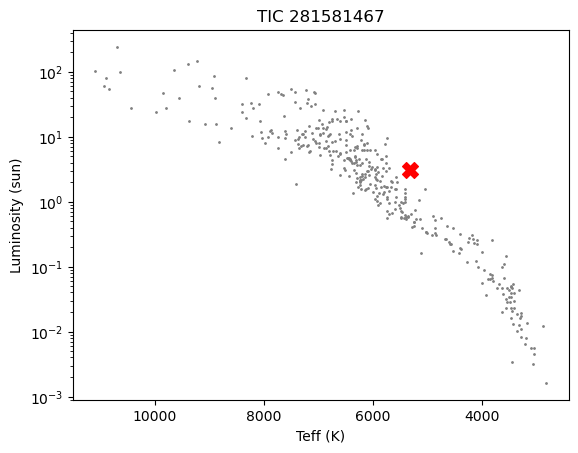

In [6]:
import dashboard_utils  # from ../src, for HD diagram

ax = dashboard_utils.plot_tic_on_hr(tic);

## Variabiility from other catalogs

In [237]:
# Used for display here, but also for later, e.g., in reports
# reload(vetting_utils)
all_meta = catalog_utils.get_all_meta_of_tic(tic)

vetting_utils.display_all_meta_highlights(all_meta)

### SIMBAD&emsp;[live](https://simbad.cds.unistra.fr/simbad/sim-id?Ident=TYC+8911-718-1) , [references](https://simbad.cds.unistra.fr/simbad/sim-id?Ident=TYC+8911-718-1#lab_bib)

MAIN_ID,FLUX_V,OTYPES,V__vartyp
TYC 8911-718-1,12.090000,PM*|*|IR,nan


### VSX&emsp;[live](https://www.aavso.org/vsx/index.php?view=detail.top&oid=838559) 

Name,Type
ASASSN-V J074356.39-602347.2,ROT:


### ASAS-SN&emsp;[live](https://asas-sn.osu.edu/variables/AP39600700)

ASASSN-V,Vmag,Type,Prob,Per
J074356.31-602347.0,11.740000,VAR,0.943000,NON PERIODIC


### TESS EB&emsp;[live](http://tessebs.villanova.edu/0281581467)

TIC,Per,Epochp,Epochs-pf,Morph,Sectors


### Gaia DR3 / DR3 Variable&emsp;[live](https://vizier.cds.unistra.fr/viz-bin/VizieR-4?-ref=VIZ6553efc5ee22b&-to=-4b&-from=-3&-this=-4&%2F%2Fsource=%2BI%2F355%2Fgaiadr3%2BI%2F355%2Fparamp&%2F%2Fc=07%3A43%3A56.28+-60%3A23%3A47&%2F%2Ftables=I%2F355%2Fgaiadr3&%2F%2Ftables=I%2F355%2Fparamp&-out.max=50&%2F%2FCDSportal=http%3A%2F%2Fcdsportal.u-strasbg.fr%2FStoreVizierData.html&-out.form=HTML+Table&-out.add=_r&%2F%2Foutaddvalue=default&-sort=_r&-order=I&-oc.form=sexa&-out.src=I%2F355%2Fgaiadr3%2CI%2F355%2Fparamp&-nav=cat%3AI%2F355%26tab%3A%7BI%2F355%2Fgaiadr3%7D%26tab%3A%7BI%2F355%2Fparamp%7D%26key%3Asource%3D%2BI%2F355%2Fgaiadr3%2BI%2F355%2Fparamp%26key%3Ac%3D07%3A43%3A56.28+-60%3A23%3A47%26pos%3A07%3A43%3A56.28+-60%3A23%3A47%28+15+arcsec%29%26HTTPPRM%3A&-c=07%3A43%3A56.28+-60%3A23%3A47&-c.eq=J2000&-c.r=+15&-c.u=arcsec&-c.geom=r&-source=&-x.rs=10&-source=I%2F355%2Fgaiadr3+I%2F355%2Fparamp&-out.orig=standard&-out=RA_ICRS&-out=DE_ICRS&-out=Source&Source=5292492417071590528&-out=Plx&-out=PM&-out=pmRA&-out=pmDE&-out=sepsi&-out=RUWE&-out=Dup&-out=Gmag&-out=BPmag&-out=RPmag&-out=BP-RP&-out=RV&-out=e_RV&-out=Vbroad&-out=GRVSmag&-out=VarFlag&-out=NSS&-out=XPcont&-out=XPsamp&-out=RVS&-out=EpochPh&-out=EpochRV&-out=MCMCGSP&-out=MCMCMSC&-out=Teff&-out=logg&-out=%5BFe%2FH%5D&-out=Dist&-out=A0&-out=HIP&-out=PS1&-out=SDSS13&-out=SKYM2&-out=TYC2&-out=URAT1&-out=AllWISE&-out=APASS9&-out=GSC23&-out=RAVE5&-out=2MASS&-out=RAVE6&-out=RAJ2000&-out=DEJ2000&-out=Pstar&-out=PWD&-out=Pbin&-out=ABP&-out=ARP&-out=GMAG&-out=Rad&-out=SpType-ELS&-out=Rad-Flame&-out=Lum-Flame&-out=Mass-Flame&-out=Age-Flame&-out=Flags-Flame&-out=Evol&-out=z-Flame&-meta.ucd=2&-meta=1&-meta.foot=1&-usenav=1&-bmark=GET) , [variable](https://vizier.cds.unistra.fr/viz-bin/VizieR-4?-ref=VIZ63a395c22729a4&-to=-4b&-from=-4&-this=-4&%2F%2Fsource=I%2F358%2Fvclassre&%2F%2Ftables=I%2F358%2Fvarisum&%2F%2Ftables=I%2F358%2Fvclassre&%2F%2Ftables=I%2F358%2Fveb&%2F%2Ftables=I%2F358%2Fvst&-out.max=50&%2F%2FCDSportal=http%3A%2F%2Fcdsportal.u-strasbg.fr%2FStoreVizierData.html&-out.form=HTML+Table&%2F%2Foutaddvalue=default&-order=I&-oc.form=sexa&-nav=cat%3AI%2F358%26tab%3A%7BI%2F358%2Fvarisum%7D%26tab%3A%7BI%2F358%2Fvclassre%7D%26tab%3A%7BI%2F358%2Fveb%7D%26tab%3A%7BI%2F358%2Fvst%7D%26key%3Asource%3DI%2F358%2Fvclassre%26HTTPPRM%3A&-c=&-c.eq=J2000&-c.r=++2&-c.u=arcmin&-c.geom=r&-source=&-source=+I%2F358%2Fvarisum+I%2F358%2Fvclassre+I%2F358%2Fveb+I%2F358%2Fvst&-out.src=I%2F358%2Fvclassre&-out.orig=standard&-out=Source&-out=SolID&-out=Classifier&-out=Class&-out=ClassSc&-out=RA_ICRS&-out=DE_ICRS&-out=_RA.icrs&-out=_DE.icrs&-meta.ucd=2&-meta=1&-meta.foot=1&-usenav=1&-bmark=GET&Source=5292492417071590528)

Source,RAJ2000,DEJ2000,Gmag,BP-RP,Teff,RUWE,sepsi,e_RV,Dup,Class,ClassSc
5292492417071590400,115.984978,-60.396447,11.521368,1.089938,nan,0.970000,16.893000,10.490000,0,RS,0.089806



### Misc. EB Catalogs from TESS observations
- [TESS OBA-type eclipsing binaries (IJspeert+, 2021)](https://vizier.cds.unistra.fr/viz-bin/VizieR-4?-ref=VIZ655788c4386ef3&-to=-4b&-from=-3&-this=-4&%2F%2Fsource=J%2FA%2BA%2F652%2FA120%2Feb-cat&%2F%2Ftables=J%2FA%2BA%2F652%2FA120%2Feb-cat&-out.max=50&%2F%2FCDSportal=http%3A%2F%2Fcdsportal.u-strasbg.fr%2FStoreVizierData.html&-out.form=HTML+Table&%2F%2Foutaddvalue=default&-order=I&-oc.form=sexa&-out.src=J%2FA%2BA%2F652%2FA120%2Feb-cat&-nav=cat%3AJ%2FA%2BA%2F652%2FA120%26tab%3A%7BJ%2FA%2BA%2F652%2FA120%2Feb-cat%7D%26key%3Asource%3DJ%2FA%2BA%2F652%2FA120%2Feb-cat%26HTTPPRM%3A&-c=&-c.eq=J2000&-c.r=++2&-c.u=arcmin&-c.geom=r&-source=&-source=J%2FA%2BA%2F652%2FA120%2Feb-cat&-out=TIC&TIC=281581467&-out=RAJ2000&-out=DEJ2000&-out=Jmag&-out=Hmag&-out=Kmag&-out=Gmag&-out=Tmag&-out=LumClass&-out=BPmag&-out=RPmag&-out=WDFlag&-out=SimbadOtype&-out=SimbadSptype&-out=tsupcon&-out=eclPer&-out=eclScore&-out=DepthP&-out=DepthS&-out=WidthP&-out=WidthS&-out=tsupconT&-out=eclPerT&-out=FlagS&-out=FlagVar&-out=FlagCont&-out=FlagHeart&-out=dupl-group&-out=Simbad&-meta.ucd=2&-meta=1&-meta.foot=1&-usenav=1&-bmark=GET)
- [TESS Close Binaries in the southern hemisphere (Justesen+, 2021)](https://vizier.cds.unistra.fr/viz-bin/VizieR-4?-ref=VIZ655789fb3aa4f3&-to=-4b&-from=-3&-this=-4&%2F%2Fsource=J%2FApJ%2F912%2F123&%2F%2Ftables=J%2FApJ%2F912%2F123%2Ftable2&%2F%2Ftables=J%2FApJ%2F912%2F123%2Ftable3&-out.max=50&%2F%2FCDSportal=http%3A%2F%2Fcdsportal.u-strasbg.fr%2FStoreVizierData.html&-out.form=HTML+Table&%2F%2Foutaddvalue=default&-order=I&-oc.form=sexa&-out.src=J%2FApJ%2F912%2F123%2Ftable2%2CJ%2FApJ%2F912%2F123%2Ftable3&-nav=cat%3AJ%2FApJ%2F912%2F123%26tab%3A%7BJ%2FApJ%2F912%2F123%2Ftable2%7D%26tab%3A%7BJ%2FApJ%2F912%2F123%2Ftable3%7D%26key%3Asource%3DJ%2FApJ%2F912%2F123%26HTTPPRM%3A&-c=&-c.eq=J2000&-c.r=++2&-c.u=arcmin&-c.geom=r&-source=&-source=J%2FApJ%2F912%2F123%2Ftable2+J%2FApJ%2F912%2F123%2Ftable3&-out=TIC&TIC=281581467&-out=Per&-out=t1&-out=t2&-out=ecosw&-out=d1&-out=d2&-out=Tmag&-out=Simbad&-out=_RA&-out=_DE&-out=rp&-out=a%2FR1&-out=esinw&-out=inc&-out=fp&-out=Teff1&-out=Teff2&-out=f_Teff&-meta.ucd=2&-meta=1&-meta.foot=1&-usenav=1&-bmark=GET)
- [δ Scuti Pulsators in EBs from TESS (Chen+, 2022)](https://vizier.cds.unistra.fr/viz-bin/VizieR-4?-ref=VIZ65578b153bda7e&-to=-4b&-from=-2&-this=-4&%2F%2Fsource=J%2FApJS%2F263%2F34&%2F%2Ftables=J%2FApJS%2F263%2F34%2Ftable1&-out.max=50&%2F%2FCDSportal=http%3A%2F%2Fcdsportal.u-strasbg.fr%2FStoreVizierData.html&-out.form=HTML+Table&%2F%2Foutaddvalue=default&-order=I&-oc.form=sexa&-out.src=J%2FApJS%2F263%2F34%2Ftable1&-nav=cat%3AJ%2FApJS%2F263%2F34%26tab%3A%7BJ%2FApJS%2F263%2F34%2Ftable1%7D%26key%3Asource%3DJ%2FApJS%2F263%2F34%26HTTPPRM%3A&-c=&-c.eq=J2000&-c.r=++2&-c.u=arcmin&-c.geom=r&-source=&-source=J%2FApJS%2F263%2F34%2Ftable1&-out=TIC&TIC=281581467&-out=RAJ2000&-out=DEJ2000&-out=Tmag&-out=Porb&-out=Pdom&-out=TeffT&-out=loggT&-out=TeffG&-out=loggG&-out=Lbol&-out=EType&-out=PType&-out=NewPB&-out=Ref&-out=S22&-out=P22&-out=Simbad&-meta.ucd=2&-meta=1&-meta.foot=1&-usenav=1&-bmark=GET)
- [Pulsating Stars in EA-type eclipsing binaries observed by TESS (Shi+, 2022)](https://vizier.cds.unistra.fr/viz-bin/VizieR-4?-ref=VIZ65578bc23c6846&-to=-4b&-from=-3&-this=-4&%2F%2Fsource=J%2FApJS%2F259%2F50%2Ftable1&%2F%2Ftables=J%2FApJS%2F259%2F50%2Ftable1&-out.max=50&%2F%2FCDSportal=http%3A%2F%2Fcdsportal.u-strasbg.fr%2FStoreVizierData.html&-out.form=HTML+Table&%2F%2Foutaddvalue=default&-order=I&-oc.form=sexa&-out.src=J%2FApJS%2F259%2F50%2Ftable1&-nav=cat%3AJ%2FApJS%2F259%2F50%26tab%3A%7BJ%2FApJS%2F259%2F50%2Ftable1%7D%26key%3Asource%3DJ%2FApJS%2F259%2F50%2Ftable1%26HTTPPRM%3A&-c=&-c.eq=J2000&-c.r=++2&-c.u=arcmin&-c.geom=r&-source=&-source=J%2FApJS%2F259%2F50%2Ftable1&-out=TIC&TIC=281581467&-out=f_TIC&-out=Name&-out=RAJ2000&-out=DEJ2000&-out=Cons&-out=Per&-out=u_Per&-out=mag1&-out=mag2&-out=n_mag&-out=l_mag&-out=Filter&-out=Sep&-out=Simbad&-meta.ucd=2&-meta=1&-meta.foot=1&-usenav=1&-bmark=GET)
- [Multiply eclipsing candidates from TESS satellite (Zasche+, 2022)](https://vizier.cds.unistra.fr/viz-bin/VizieR-4?-ref=VIZ65578c393cd155&-to=-4b&-from=-3&-this=-4&%2F%2Fsource=J%2FA%2BA%2F664%2FA96&%2F%2Ftables=J%2FA%2BA%2F664%2FA96%2Ftable1&%2F%2Ftables=J%2FA%2BA%2F664%2FA96%2Ftablea1&-out.max=50&%2F%2FCDSportal=http%3A%2F%2Fcdsportal.u-strasbg.fr%2FStoreVizierData.html&-out.form=HTML+Table&%2F%2Foutaddvalue=default&-order=I&-oc.form=sexa&-out.src=J%2FA%2BA%2F664%2FA96%2Ftable1%2CJ%2FA%2BA%2F664%2FA96%2Ftablea1&-nav=cat%3AJ%2FA%2BA%2F664%2FA96%26tab%3A%7BJ%2FA%2BA%2F664%2FA96%2Ftable1%7D%26tab%3A%7BJ%2FA%2BA%2F664%2FA96%2Ftablea1%7D%26key%3Asource%3DJ%2FA%2BA%2F664%2FA96%26HTTPPRM%3A&-c=&-c.eq=J2000&-c.r=++2&-c.u=arcmin&-c.geom=r&-source=&-x.rs=10&-source=J%2FA%2BA%2F664%2FA96%2Ftable1+J%2FA%2BA%2F664%2FA96%2Ftablea1&-out=RAJ2000&-out=DEJ2000&-out=VSX&-out=n_VSX&-out=TIC&TIC=281581467&-out=magmax&-out=JD0A&-out=Per&-out=DP&-out=n_DP&-out=DS&-out=n_DS&-out=JD0O&-out=Com&-out=SimbadName&-out=EBtype&-out=PerA&-out=DPA&-out=DSA&-out=PerB&-out=DPB&-out=DSB&-meta.ucd=2&-meta=1&-meta.foot=1&-usenav=1&-bmark=GET)


## Lightcurves - all sectors
<a name="lc-all">

Obs span: 1007.2360641587809  ; num. of days: 464
Sectors 1, 3-4, 7-11, 13, 27-28, 30-31, 33-37:


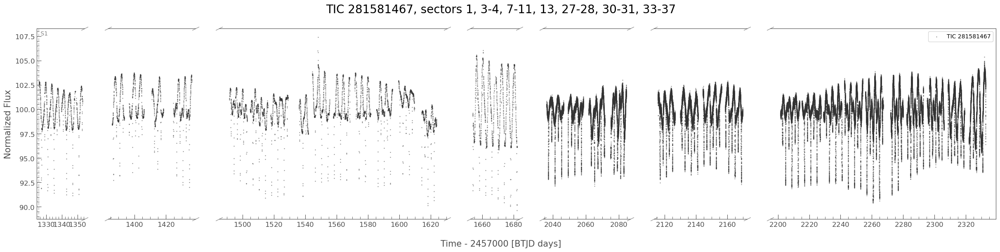

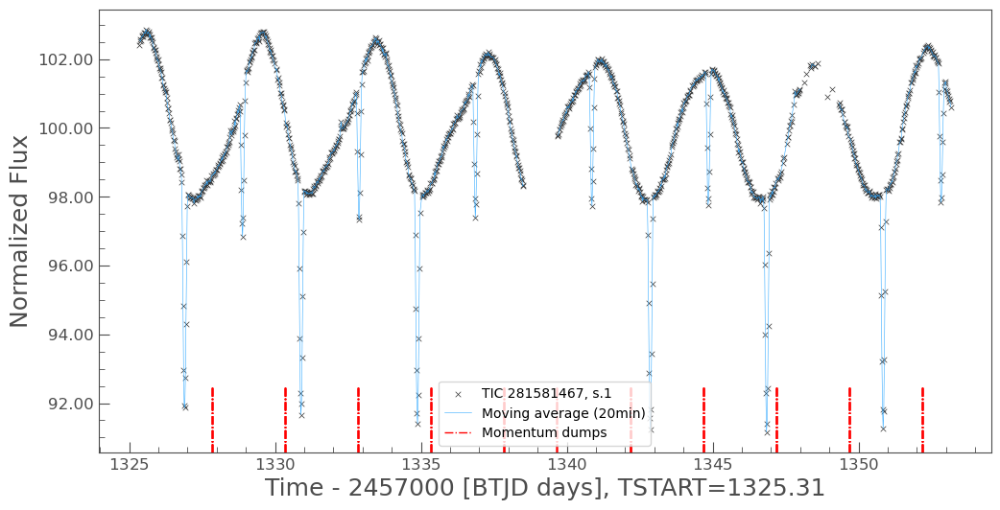

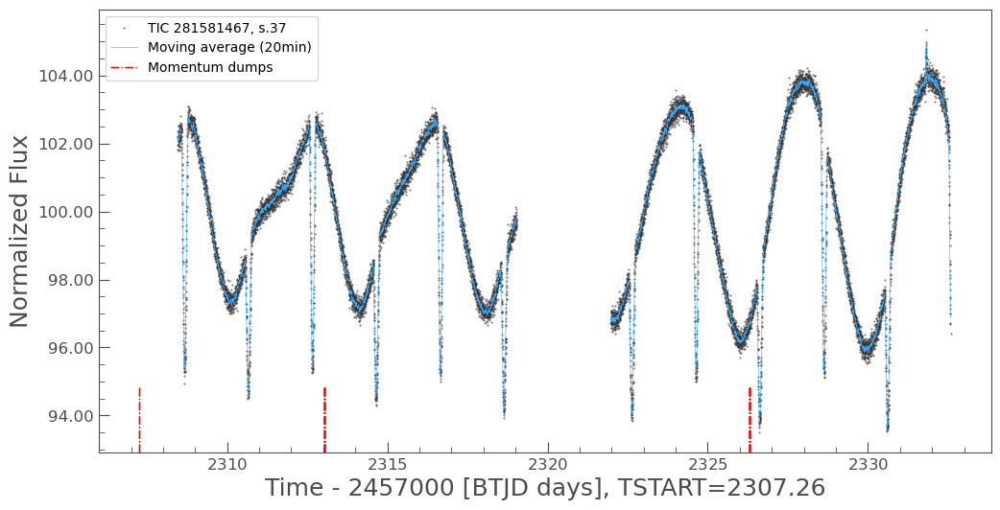

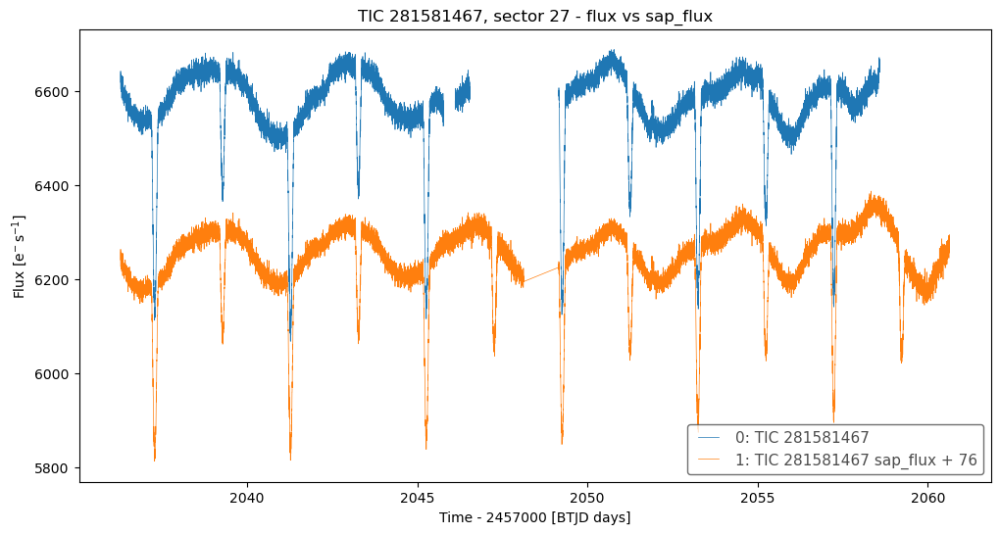

In [14]:
obs_span, num_days = lke.get_obs_date_range(lcf_coll)
print(f"Obs span: {obs_span}  ; num. of days: {num_days}")


# ---

lc = lke.stitch(
    lcf_coll,
    corrector_func=lambda lc: (
        lc
#         .select_flux("sap_flux")
#         .remove_outliers(sigma=7)
        .normalize(unit="percent")
    ),
    ignore_incompatible_column_warning=True,
).normalize(unit="percent")

print(f"Sectors {lke.abbrev_sector_list(lc.meta['SECTORS'])}:")
axs = tplt.plot_skip_data_gap(lc, figsize=(30,6), s=2, alpha=0.5);
axs[0].get_figure().suptitle(f"{lc.label}, sectors {lke.abbrev_sector_list(lc.meta['SECTORS'])}", fontsize=20);
# [ax.set_ylim(99.8, None) for ax in axs];


# Zoom in to the first and the last known sectors

figsize=(12, 6)
if len(lcf_coll) >= 2:
    lcf_coll_first_last = lk.LightCurveCollection([lcf_coll[0], lcf_coll[-1], ])
else:
    lcf_coll_first_last = lk.LightCurveCollection([lcf_coll[0]])

axs = tplt.plot_all(
    lcf_coll_first_last,
    moving_avg_window='20min',
    ax_fn=lambda: tplt.lk_ax(figsize=figsize),
    use_relative_time=False,
    mark_quality_issues=False,
    mark_momentum_dumps=True,
    set_title=False,
)

# as a sanity check, in case PDCSAP_FLUX has some anomaly (e.g., remvoing a good dip)
ax_flux_cmp = tplt.plot_flux_sap_flux_comparison(of_sector(lcf_coll, sector), ax=plt.figure(figsize=figsize).gca(),
                                                 offset=None)


### Manual exclude problematic cadences, if any

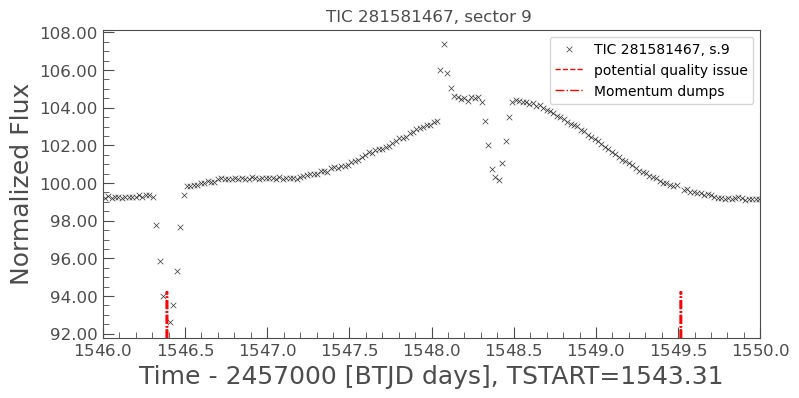

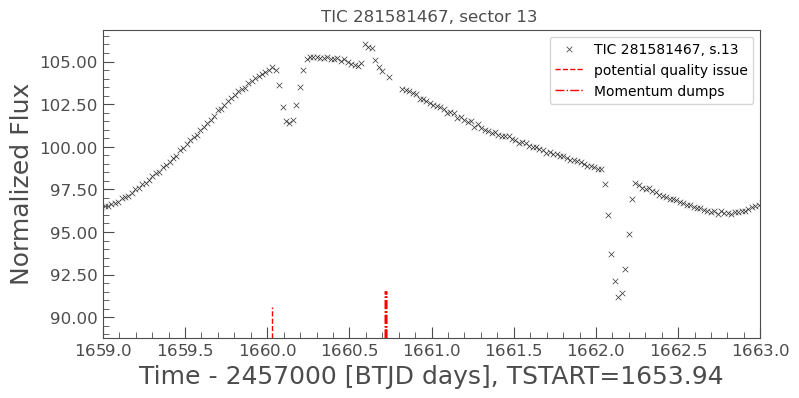

In [9]:
display(HTML("The 2 small spikes are probably flares. So no exclusion is needed."))

axs = tplt.plot_all(of_sectors(lcf_coll, 9, 13))

axs[0].set_xlim(1546, 1550);
axs[1].set_xlim(1659, 1663);

In [10]:
to_mask_out_cadences = False

if to_mask_out_cadences:
    # a new collection that I'd modify
    lcf_coll = lk.LightCurveCollection(lcf_coll_original.data)
    # custom codes to mask out problematic cadences
    #
    # the flux in sector 9 QLP lc at the beginning of an orbit does not appear to be reliable
    # it seems background is not subtracted sufficiently
    idx = -1 # FILL IN
    lc = lcf_coll[idx]  
    lc = lke.exclude_range(lc, )   # FILL IN
    lcf_coll[idx] = lc

    # plot all lightcurves again for visual validation
    axs = tplt.plot_skip_data_gap(
        lke.stitch(lcf_coll, corrector_func=tplt.normalize_percent, ignore_incompatible_column_warning=True),
        figsize=(30,6), s=2, alpha=0.5
        );


In [11]:
# SO used 2459036 to 2459332, 
for lc in lcf_coll:
    print(lc.sector, round(lc.time[0].to_value('jd'), 1), round(lc.time[-1].to_value('jd'), 1))

1 2458325.3 2458353.2
3 2458386.0 2458406.2
4 2458410.9 2458436.8
7 2458491.7 2458516.1
8 2458517.4 2458542.0
9 2458543.3 2458568.4
10 2458569.5 2458595.7
11 2458596.8 2458623.9
13 2458653.9 2458682.3
27 2459036.3 2459060.6
28 2459061.8 2459087.1
30 2459115.9 2459143.2
31 2459144.5 2459169.9
33 2459201.7 2459227.6
34 2459228.8 2459254.1
35 2459255.0 2459280.0
36 2459280.9 2459306.0
37 2459307.3 2459332.6
61 2459962.8 2459988.2
62 2459988.4 2460014.2
63 2460014.4 2460040.9
64 2460041.1 2460068.0


## Identify initial period with BLS

C:\dev\_juypter\pht_eb_stats2\vetting\lightkurve_ext_pg.py:343: UserWarning: validate_bls_n_report() cannot calculate FAP, because the depdent package transitleastsquares is not installed
  warnings.warn(


BLS run time: 174.4s


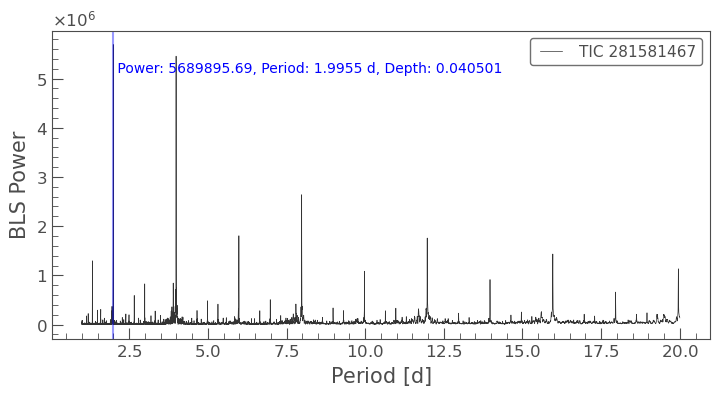

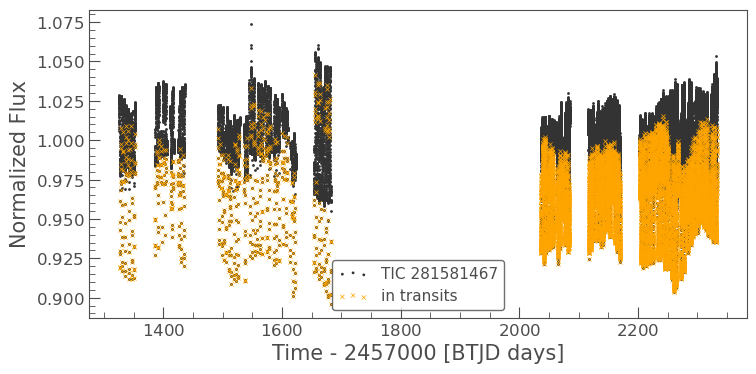

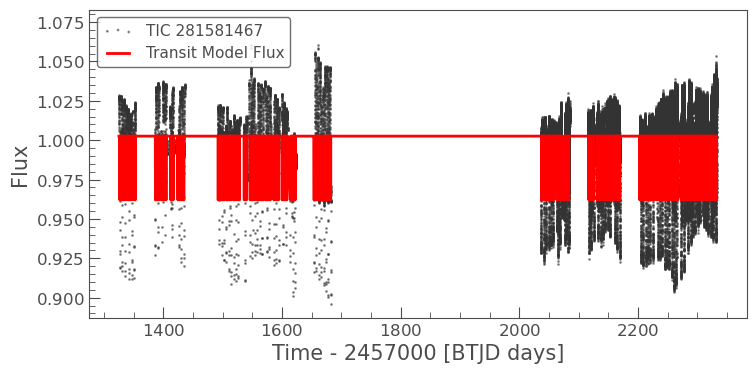

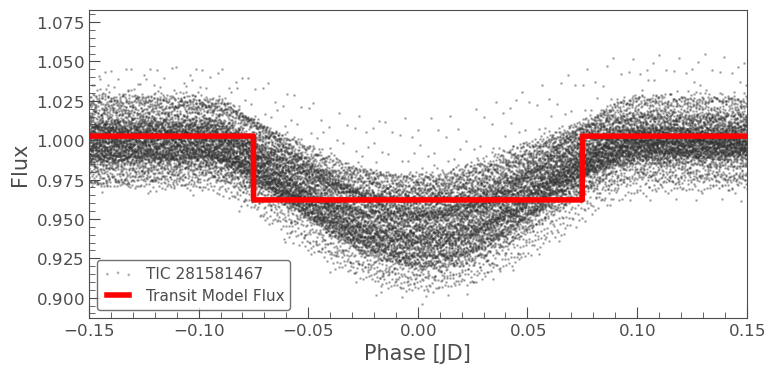

In [23]:
run_bls = False


if run_bls:
    lc = lke.stitch(
        lcf_coll, 
        corrector_func=lambda lc: lc.normalize(unit="percent"),
        ignore_incompatible_column_warning=True,
    )
    # data points for BLS run time
    # for a 18-sector LC (~half 30-min, ~half 2-min), with 163328 data points
    # - minimum_period=1, maximum_period=20, frequency_factor=1000:
    #   - run_time: 18.6s, period grize size: 19277
    # - minimum_period=1, maximum_period=20, frequency_factor=100:
    #   - run_time: 174s, period grize size: 192761
    #   - period: 1.995467302777175 , epoch=1326.8983504171797, duration=0.15
    t_bls_start = time.time()
    result = lke_pg_runner.run_bls(lc, pg_kwargs=dict(
        minimum_period=1, maximum_period=20,
        frequency_factor=100,
    ))
    t_bls_end = time.time()
    # TODO: BLS run time is available at  result.pg.elapsed_time
    print(f"BLS run time: {round(t_bls_end - t_bls_start, 1)}s")
#     lc.normalize().interact_bls(notebook_url=notebook_url)

## Magnitude Range / Amplitude

Sectors 1, 3-4, 7-11, 13, 27-28, 30-31, 33-37:
Max/Min (normalized): 1.0740507 0.8962814
Max/Min (magnitude) : 10.872738 11.069189


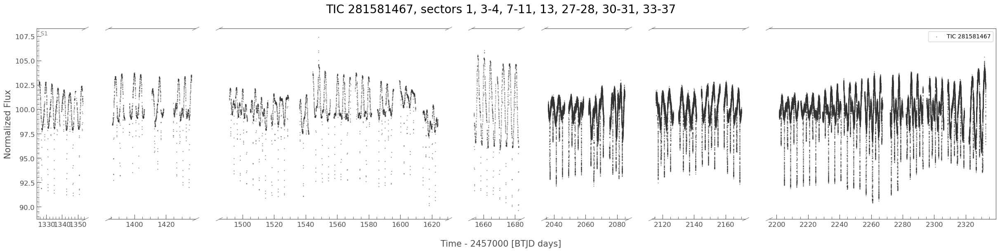

In [25]:
res = lket.calc_flux_range(lcf_coll)

# they'll be used in reports at the end
flux_range_pct = res.flux_range_pct
flux_range_mag = res.flux_range_mag

# report and visualzie the results
lc = res.lc_stitched
print(f"Sectors {lke.abbrev_sector_list(lc.meta['SECTORS'])}:")
print("Max/Min (normalized):", flux_range_pct[0], flux_range_pct[1])
print("Max/Min (magnitude) :", flux_range_mag[0], flux_range_mag[1])

axs = tplt.plot_skip_data_gap(lc, figsize=(30,6), s=2, alpha=0.5);
axs[0].get_figure().suptitle(f"{lc.label}, sectors {lke.abbrev_sector_list(lc.meta['SECTORS'])}", fontsize=20);

## Lightcurve - interactive
<a name="lc-interactive">

In [7]:
# interactively view a lightcurve 
lcf = of_sector(lcf_coll, sector)


lket.display_crowdsap(lcf)
display(HTML(f"TSTART: {lcf.meta.get('TSTART')}"))  # To aid relative time conversion


# make zoom in to a specific dip eaiser
tplt.plot_transit_interactive(lcf, figsize=(30, 10)
#                               ,flux_col='sap_flux'
                             );

Output(layout=Layout(border_bottom='1px solid lightgray', border_left='1px solid lightgray', border_right='1px…

Output(layout=Layout(padding='1em'))

## Lightcurve - zoomed in
<a name="lc-zoomed-in"></a>

- Eclipse specification is defined here in `transit_specs`

Transits, zoomed-in


label,epoch,duration_hr,period
str25,float64,float64,float64
"deep, s0001-s0039:TCE1",2037.2852,4.7531,3.990926
"shallow, s0001-s0039:TCE1",2039.280663,4.7531,3.990926


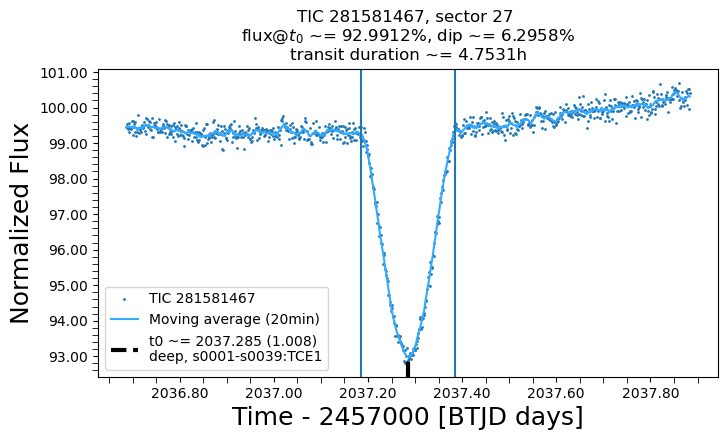

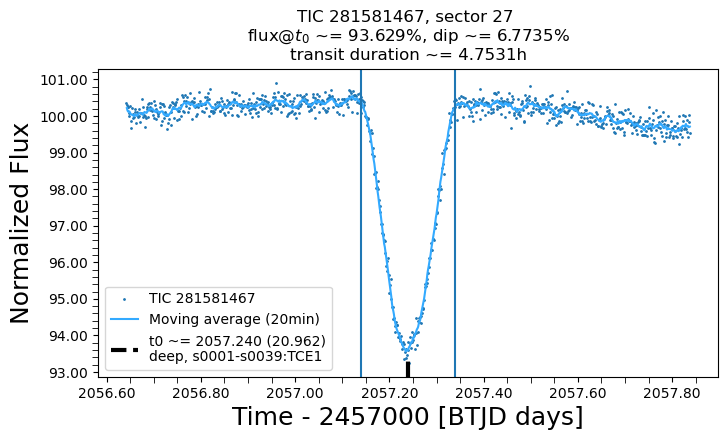

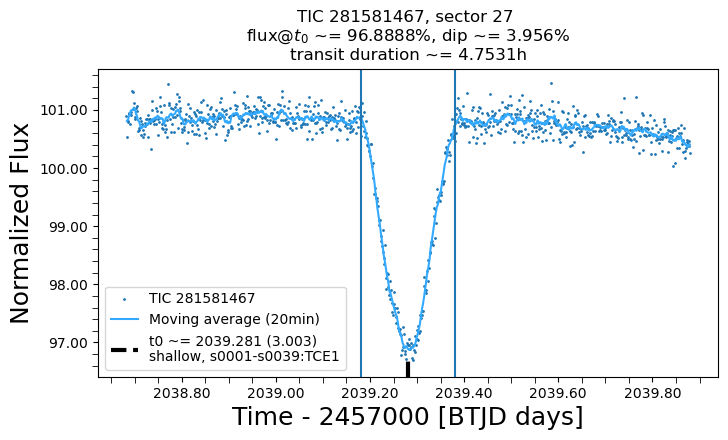

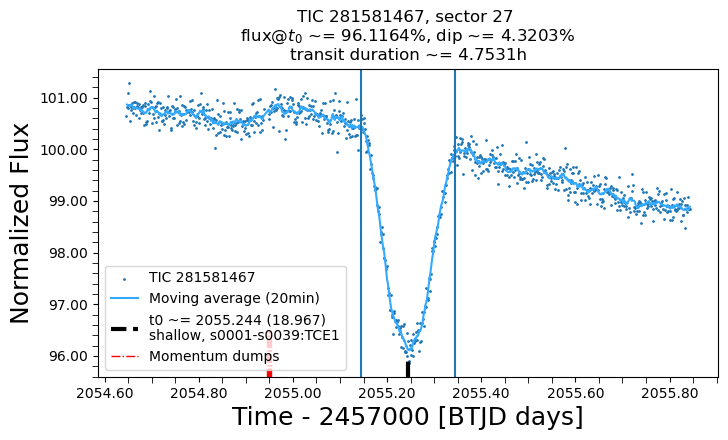

In [26]:
# Plots, zoomed-in around selected dips / transits

transit_specs = TransitTimeSpecList(
    dict(epoch=2037.2852, duration_hr=4.7531, period=3.990926, label="deep, s0001-s0039:TCE1",  # period is 2X of TCE period 1.995463 * 2
         sector=27, steps_to_show=[0, 5],
        ),
    dict(epoch=2039.280663, duration_hr=4.7531, period=3.990926, label="shallow, s0001-s0039:TCE1",  # epoch is 2037.2852 + 1.995463, deep's epoch + 1/2 period
         sector=27, steps_to_show=[0, 4],
        ),    
    defaults=dict(surround_time=1.0)
)


def custom_lc_tweak(lc):
    res = lc
    # res = res.remove_outliers(sigma=7)
    # res = res.bin(time_bin_size=20 * u.min)
    return res

figsize = (8, 4) # (16, 4)
axs = tplt.plot_transits(    
                         lcf_coll # [of_sectors(lcf_coll, 27)[1], of_sectors(lcf_coll, 28)[1]]
                         , transit_specs
#                          , flux_col = "sap_flux"
                         , ax_fn=lambda: plt.figure(figsize=figsize).gca()    
                         , t0mark_ymax=0.05
#                          , lc_tweak_fn=lambda lc: lc.remove_outliers(sigma=7)
                         , lc_tweak_fn=custom_lc_tweak
                         , moving_avg_window='20min' # None # '30min' # '10min' # None, '20min' #  '30min'
#                          , set_title=False
                         , show_r_obj_estimate=False
                         , title_fontsize=12
                        )
# axs[0].set_ylim(None, 100.15)
print('Transits, zoomed-in');
display(transit_specs.to_table());

## Lightcurves - eclipses marked
<a name="lc-transits">

[{'epoch': 2037.2852, 'period': 3.990926, 'duration_hr': 4.7531, 'sector': 27, 'steps_to_show': [0, 5], 'surround_time': None, 'label': 'deep, s0001-s0039:TCE1'}, {'epoch': 2039.280663, 'period': 3.990926, 'duration_hr': 4.7531, 'sector': 27, 'steps_to_show': [0, 4], 'surround_time': None, 'label': 'shallow, s0001-s0039:TCE1'}]
[[[1326.900372, 1330.891298, 1334.882224, 1342.864076, 1346.855002, 1350.8459280000002], [1328.895835, 1332.886761, 1336.877687, 1340.868613, 1344.859539, 1352.841391]], [[1386.7642620000001, 1390.755188, 1398.73704, 1402.727966], [1388.759725, 1392.7506509999998, 1396.741577, 1400.732503, 1404.723429]], [[1414.700744, 1426.673522, 1430.664448, 1434.655374], [1412.705281, 1416.696207, 1424.6780589999998, 1428.6689849999998, 1432.6599109999997]], [[1494.519264, 1498.51019, 1502.501116, 1506.492042, 1510.482968, 1514.473894], [1492.523801, 1496.514727, 1500.505653, 1508.487505, 1512.478431]], [[1518.4648200000001, 1522.455746, 1526.446672, 1538.41945], [1520.46028

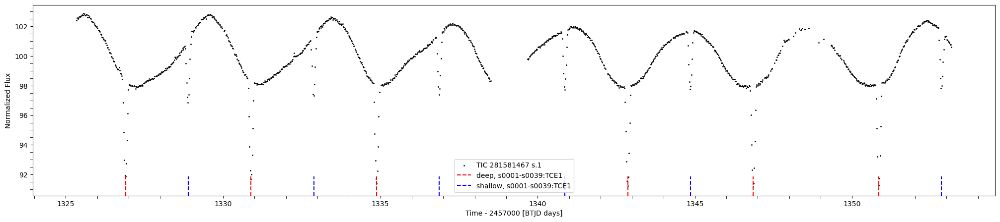

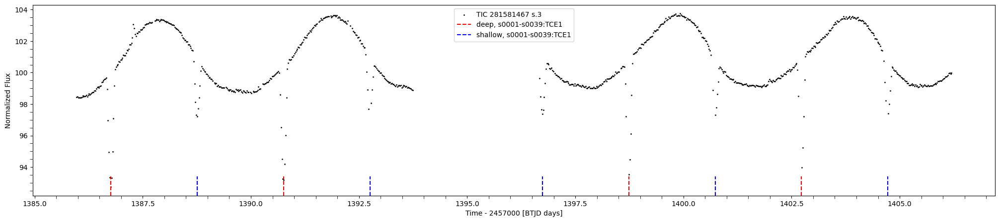

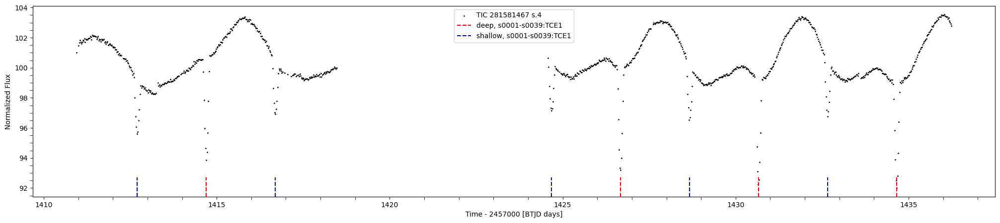

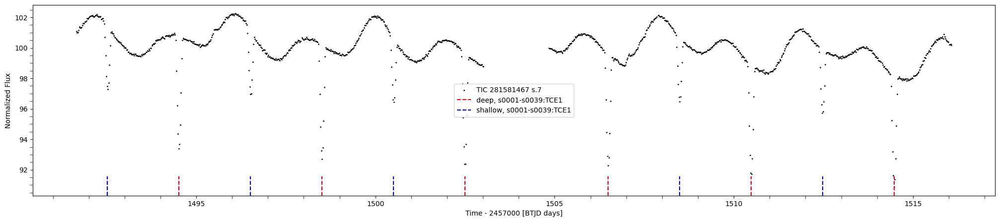

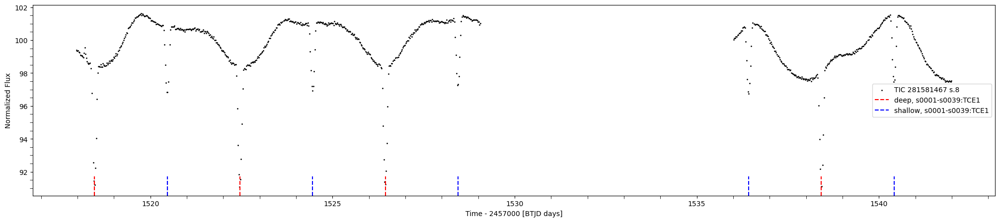

...

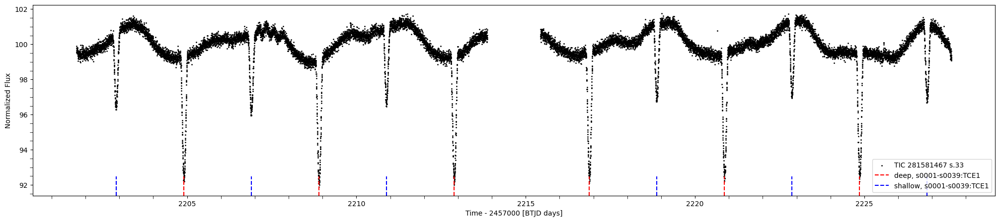

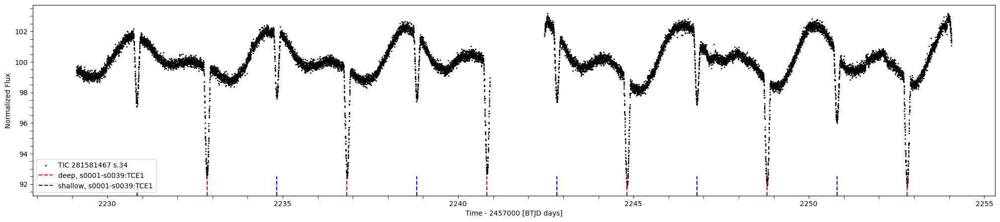

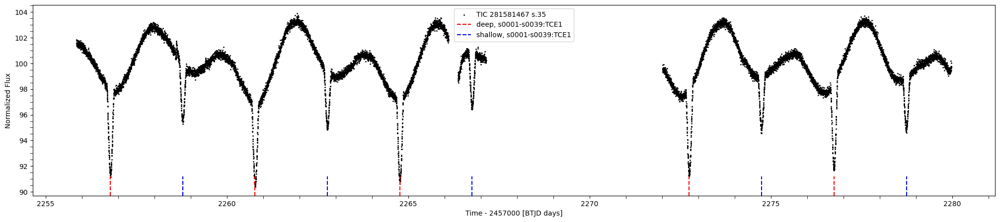

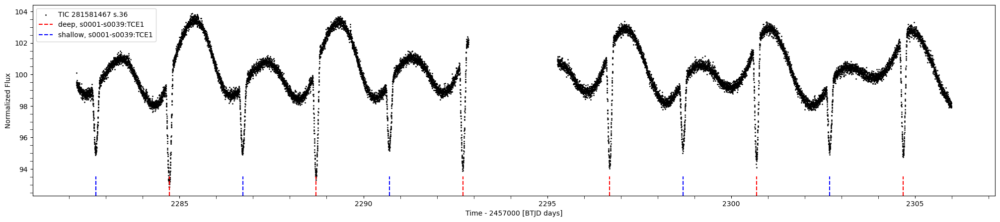

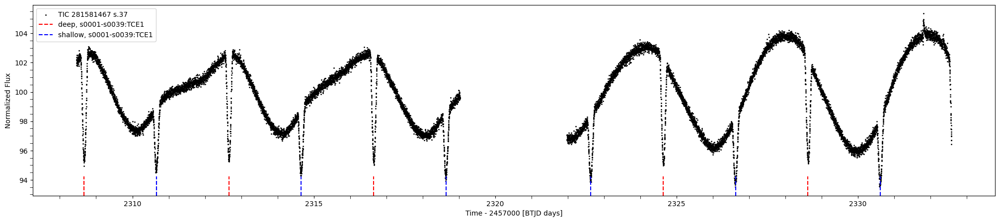

In [27]:
red_marks = dict(linestyle='--', color="red")
blue_marks = dict(linestyle='--', color="blue")
yellow_marks = dict(linestyle='--', color="yellow", ymin=0.1, ymax=0.3, linewidth=2)  # , ymax=0.5
orange_marks = dict(linestyle=':', color="orange", ymin=0.1, ymax=0.3)  # , ymax=0.8
green_marks = dict(linestyle='--', color="green", ymax=0.4)  # , ymax=0.8
purple_marks = dict(linestyle=':', color="purple", ymax=0.4)  # , ymax=0.5

# customize these parameters if needed
lcf_coll_to_use = lcf_coll
tt_specs = transit_specs


axvline_kwargs_specs = [
    red_marks,
    blue_marks
]
skip_no_transit_plot = True

# Now do the marking
axs, tt_lists = [], []
for lc_to_use in lcf_coll_to_use :
    with warnings.catch_warnings():
        # avoid warnings about repeated normalization
        warnings.filterwarnings("ignore", category=lk.LightkurveWarning, message=".*in relative units.*")
#         lc_to_use = tplt._to_lc_with_flux(lc_to_use, "sap_flux")
        lc_to_use = lc_to_use.normalize(unit="percent")  # .remove_outliers(sigma=7)
    ax = plt.figure(figsize=(25, 5)).gca()
    ax1, tt_list = tplt.mark_transit_times(lc_to_use, tt_specs,
                                           axvline_kwargs_specs=axvline_kwargs_specs,
                                           ax=ax,
                                           skip_no_transit_plot=skip_no_transit_plot,
#                                            lc_plot_func_name="plot",
                                          )
    if ax1 is not None:
        axs.append(ax1), tt_lists.append(tt_list)
    else:
        plt.close(ax.figure)

print(tt_specs);
print(tt_lists);
# axs[-1].set_ylim(None, 100.5)

### Plot marked dips, zoomed in

period:  3.990926 , t0:  2037.2852


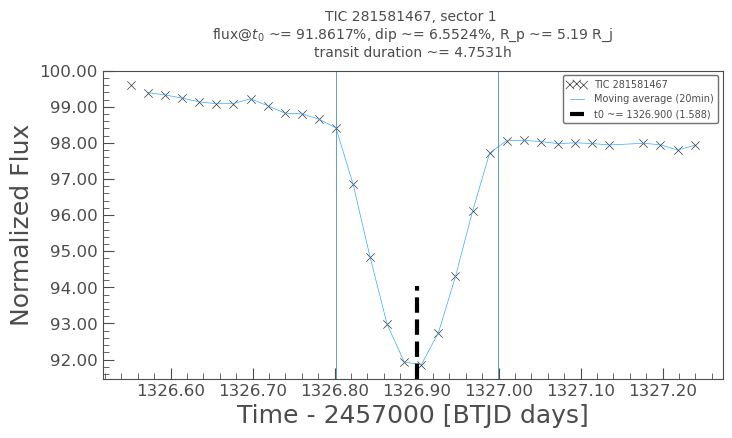

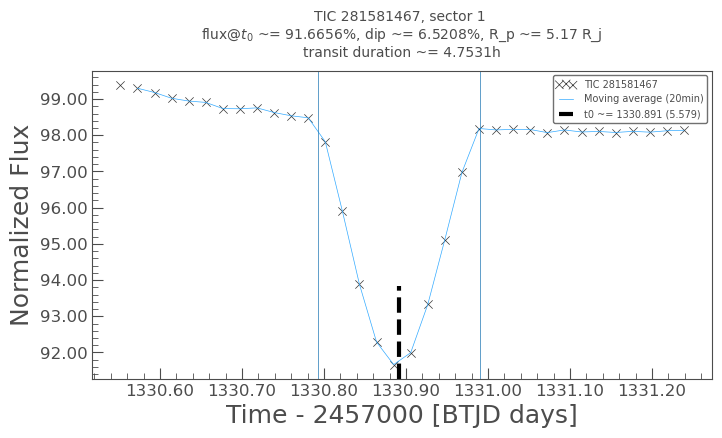

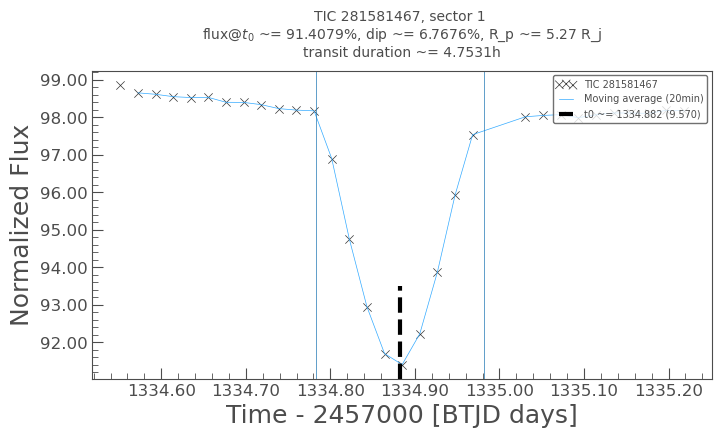

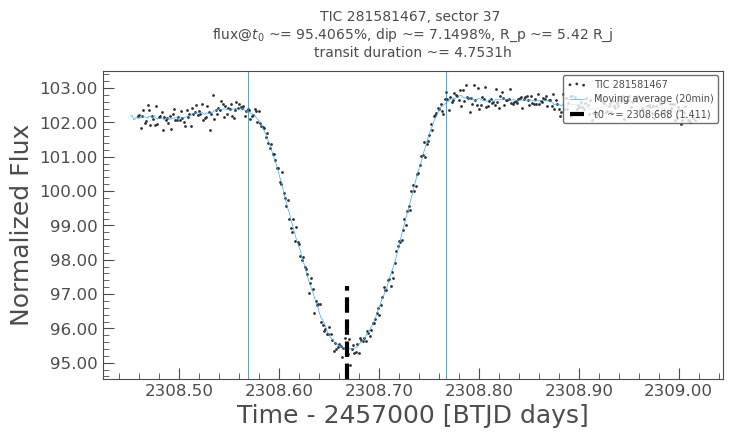

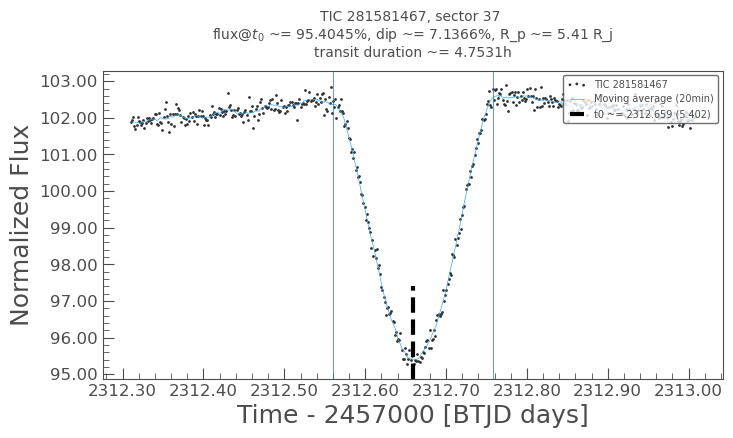

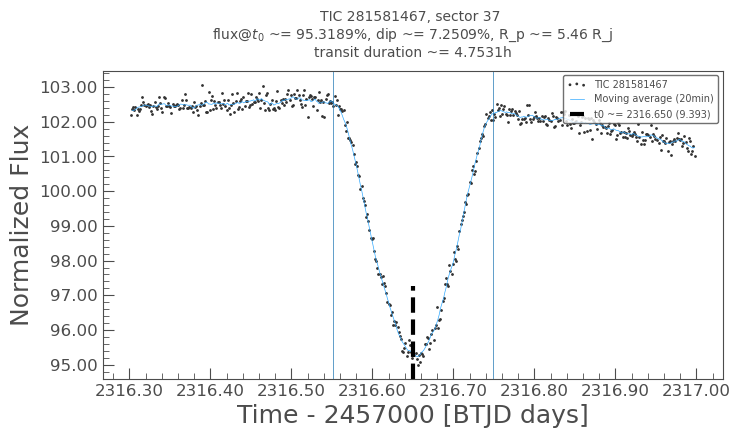

In [28]:
surround_time = 0.5
specs_idx = 0  # deep eclipses

t0, period, duration_hr, label = tt_specs[specs_idx]["epoch"], tt_specs[specs_idx]["period"], tt_specs[specs_idx]["duration_hr"], tt_specs[specs_idx]["label"]

figsize = (8, 4)

def tweak_axs(axs):
#     [ax.set_ylim(axs[-1].get_ylim()) for ax in axs];
#     [ax.set_ylim(99.7, 100.2) for ax in axs];
    return axs;

print("period: ", period, ", t0: ", t0)

axs = []
# check how well the predicted dips fit with observation, using the first and the last sector in the collection
for lc in of_sectors(lcf_coll_to_use[:], lcf_coll_to_use[0].sector, lcf_coll_to_use[-1].sector):
    lc = lke.select_flux(lc, ["flux"])  # ["kspsap_flux", "flux"] #  "sap_flux"
    lc_sap = lc.select_flux("sap_flux") #  use SAP_FLUX to calc transit time to get dips only in SAP_FLUX
    transit_times = lke.get_transit_times_in_lc(lc_sap, t0, period, return_string=False,
#                                                 break_tolerance=1e7,  # also mark data gap, by setting large break_tolerance
                                               )
    for tt in transit_times[:3]:  # limit to 3 per sector for clarity
        with plt.style.context(lk.MPLSTYLE):
            if True:   # for FLUX
                ax = plt.figure(figsize=figsize).gca()
                tplt.plot_transit(lc, ax, tt, duration_hr / 24, surround_time,
                                  moving_avg_window="20min", 
                                  title_fontsize=10,                              
                                  show_r_obj_estimate=True,        
                                  legend_kwargs=dict(fontsize=7, loc="upper right")
                                 )
                axs.append(ax)
        
tweak_axs(axs);    

## Lightcurves - folded
<a name="lc-fold">

# days: 464 ; # cycles: 125


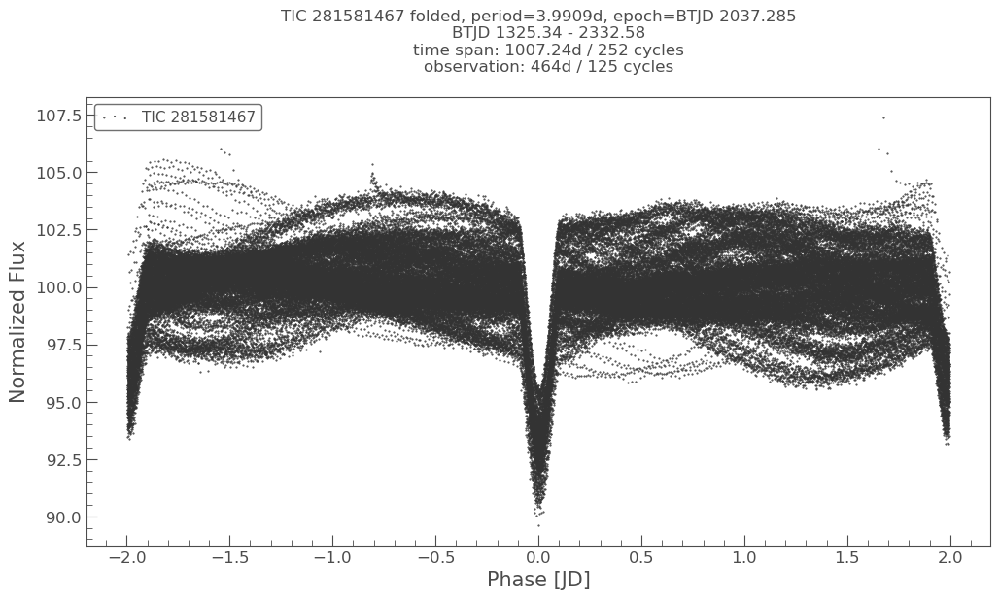

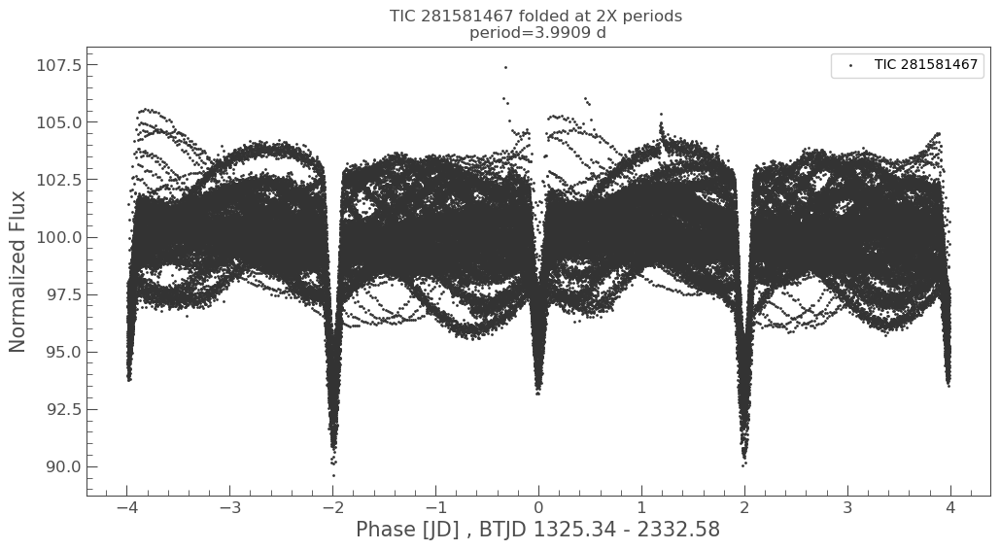

In [29]:
# Fold lightcurves

# use all LCs  to see better ensure the period is good
lc = lke.stitch(lcf_coll, corrector_func=tplt.normalize_percent, ignore_incompatible_column_warning=True)

t0 = transit_specs[0]["epoch"]
period = transit_specs[0]["period"]

figsize = (12, 6)
time_bin_size = None  # 10 * u.minute 

if time_bin_size is not None:
    lc_b = lke.bin_flux(time_bin_size=time_bin_size)
else:
    lc_b = lc


ax1, lc_f1 = tplt.fold_and_plot(lc_b, period, t0, figsize=figsize)
ax2, lc_f2 = tplt.fold_2x_periods_and_plot(lc_b, period, t0, figsize=figsize)

# used by subsequent cells
obs_actual_days = len(set([int(v) for v in lc_f1.time_original.value]))
obs_actual_cycles = len(set(lc_f1.cycle))
print(f"# days: {obs_actual_days} ; # cycles: {obs_actual_cycles}")

In [17]:
to_animate_folded_lc = False

if to_animate_folded_lc:
    ax = tplt.lk_ax(figsize=(10, 5))
    with plt.style.context(lk.MPLSTYLE):  # needed to main lightkurve style in animation
        lc_to_use = lc_f1
        tplt.animate_folded_lightcurve(lc_to_use, ax=ax, interval=750, num_frames=240, plot_kwargs=dict(s=9));
    lc_to_use.meta.get("TARGETID"), len(np.unique(tplt.calc_cycles(lc_to_use)))

## Eclipse Depth from observation
- use folded, detrended, normalized lightcurve
- calculate flux at minimum as the median flux of a 10 minute window of the minimum (possibly many data points due to folding)
- eclipse depth is `1 - flux_at_minimum`, assuming regular (out of eclipse) flux is 100%

In [30]:
# Detrend then fold,
# - eclipses masked out during detrend to preserve them

# use 2 min cadence lightcurves only to make flattening easier (with consistent cadence)
lc = of_lcs(lcf_coll, lambda lc: lc.author == "SPOC").stitch(corrector_func=tplt.normalize_percent)

window_length_days = 2 / 24
lc_flattened = lc.flatten(window_length=lke.to_window_length_for_2min_cadence(window_length_days),
                          mask=lc.create_transit_mask(transit_time=transit_specs.epoch, period=transit_specs.period, duration=transit_specs.duration)
                         ).normalize(unit="percent")

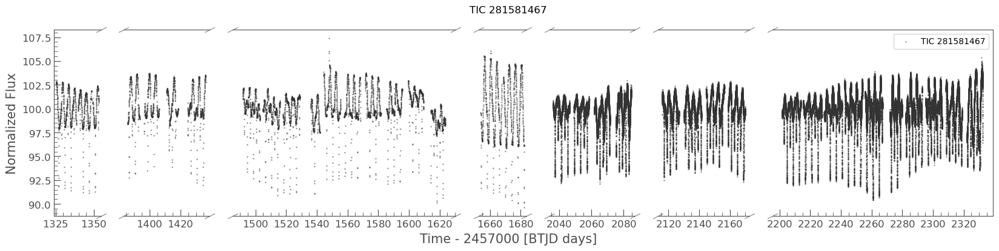

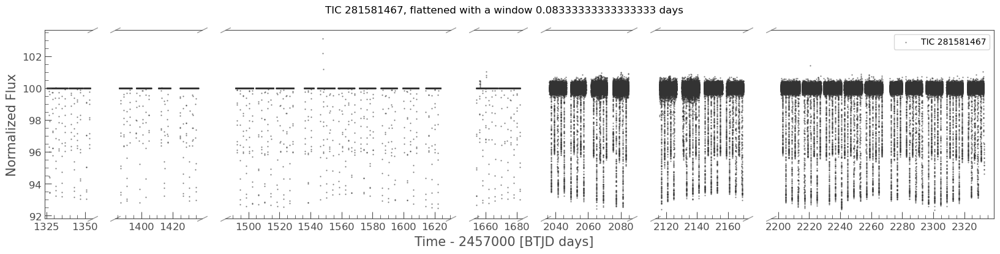

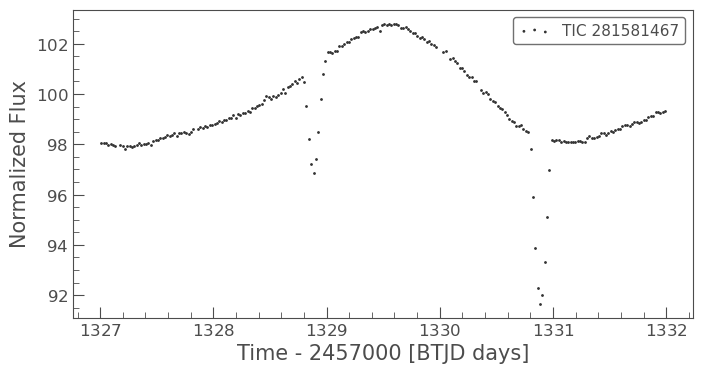

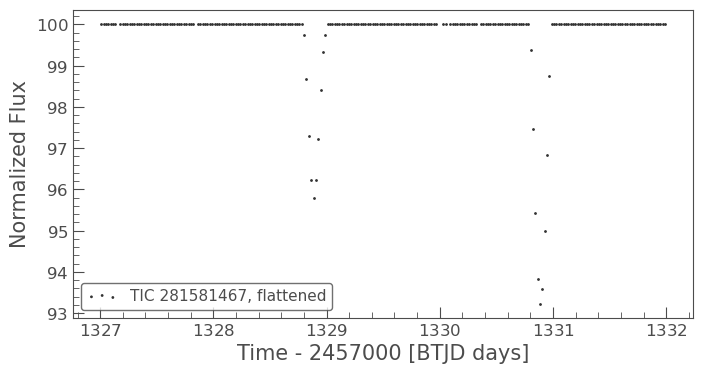

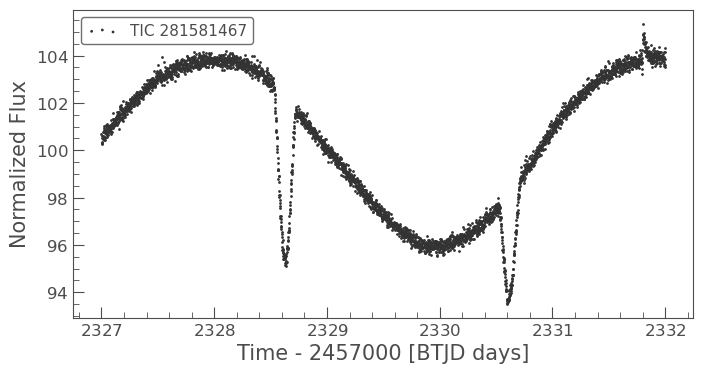

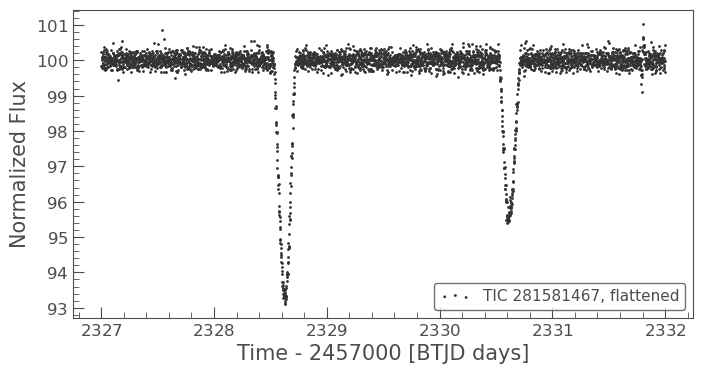

In [31]:
# visualize the detrended lightcurve 

figsize = (20, 4)
figsize_z = (8, 4)

axs = tplt.plot_skip_data_gap(lc, figsize=figsize, s=2, alpha=0.5);
axs[0].get_figure().suptitle(f'{lc.label}')

axs = tplt.plot_skip_data_gap(lc_flattened, figsize=figsize, s=2, alpha=0.5);
axs[0].get_figure().suptitle(f'{lc_flattened.label}, flattened with a window {window_length_days} days')

zoom_window = 5

zoom_b, zoom_e = np.ceil(lc_flattened.time.min().value) + 1, np.ceil(lc_flattened.time.min().value) + 1 + zoom_window
lc.truncate(zoom_b, zoom_e).scatter(ax=tplt.lk_ax(figsize=figsize_z));
ax = lc_flattened.truncate(zoom_b, zoom_e).scatter(ax=tplt.lk_ax(figsize=figsize_z), label=f'{lc.label}, flattened');

zoom_b, zoom_e = np.ceil(lc_flattened.time.max().value) - 1 - zoom_window, np.ceil(lc_flattened.time.max().value) - 1
lc.truncate(zoom_b, zoom_e).scatter(ax=tplt.lk_ax(figsize=figsize_z));
ax = lc_flattened.truncate(zoom_b, zoom_e).scatter(ax=tplt.lk_ax(figsize=figsize_z), label=f'{lc.label}, flattened');

### Deep Eclipse depth

Deep eclipse depth: 6.837% ; num. data points: 265


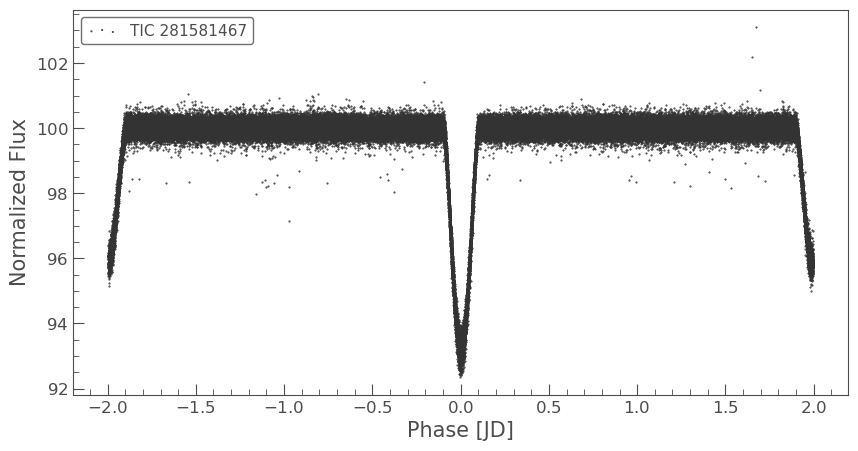

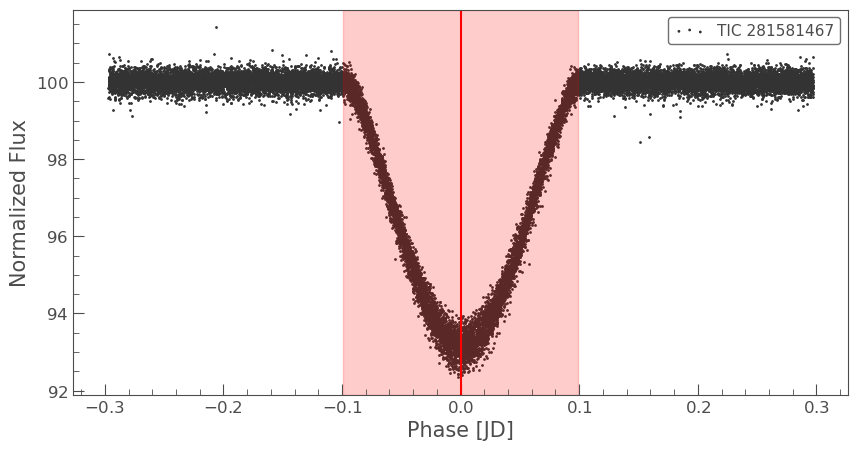

In [32]:
t0 = transit_specs[0]["epoch"]
period = transit_specs[0]["period"]
duration = transit_specs[0]["duration_hr"] / 24

lc_ff_deep = lc_flattened.fold(epoch_time=t0, period=period)

flux_min_deep, flux_min_deep_sample_size = lke.calc_flux_at_minimum(lc_ff_deep)
depth_deep = 1 - flux_min_deep
print(f"Deep eclipse depth: {100*depth_deep:.3f}% ; num. data points: {flux_min_deep_sample_size}")

ax, ax_z = tplt.plot_n_annotate_folded(lc_ff_deep, annotate=False, also_plot_zoom_transit=True, duration=duration)

### Shallow Eclipse Depth

Shallow eclipse depth: 4.102% ; num. data points: 261


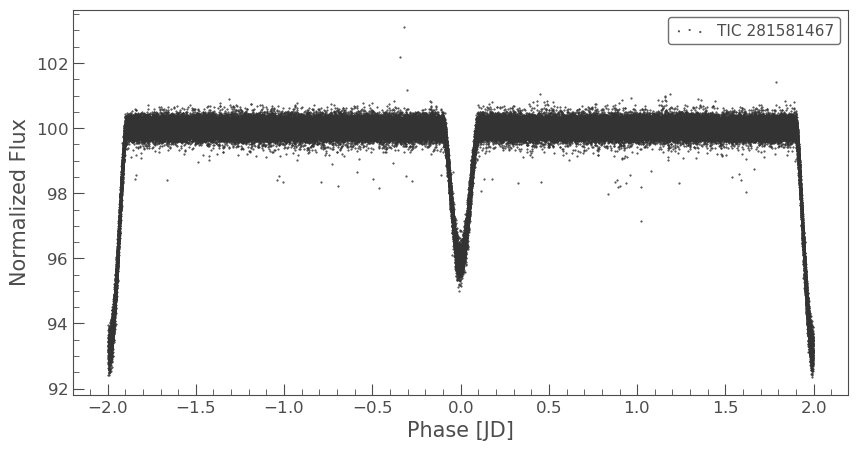

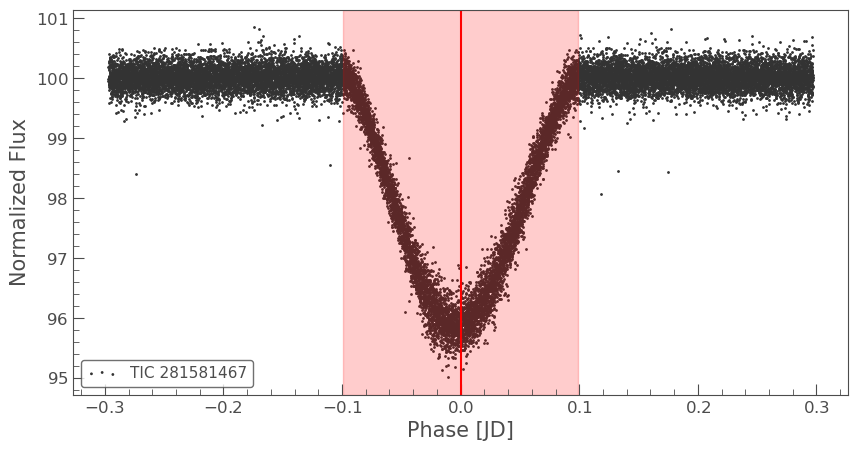

In [33]:
t0 = transit_specs[1]["epoch"]
period = transit_specs[1]["period"]
duration = transit_specs[1]["duration_hr"] / 24

lc_ff_shallow = lc_flattened.fold(epoch_time=t0, period=period)

flux_min_shallow, flux_min_shallow_sample_size = lke.calc_flux_at_minimum(lc_ff_shallow)
depth_shallow = 1 - flux_min_shallow
print(f"Shallow eclipse depth: {100*depth_shallow:.3f}% ; num. data points: {flux_min_shallow_sample_size}")

ax, ax_z = tplt.plot_n_annotate_folded(lc_ff_shallow, annotate=False, also_plot_zoom_transit=True, duration=duration)

## Identify additional variability
<a name="lc-period">

### Mask out eclipses
to visualize the remaining fluctuations

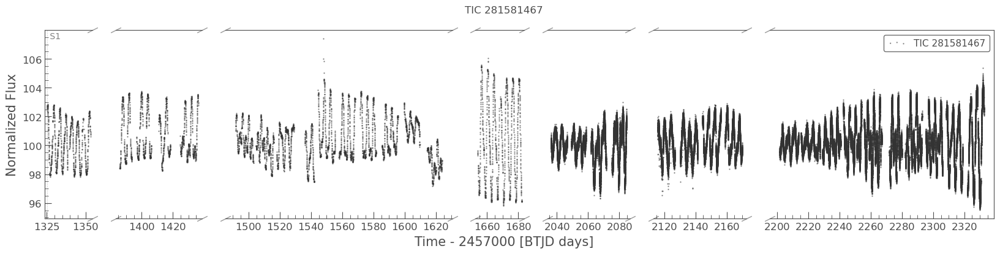

In [34]:
# use LCs with all cadences
lc = lke.stitch(lcf_coll, corrector_func=lambda lc: lc.remove_nans().normalize(unit="percent"), ignore_incompatible_column_warning=True)

## use LCs with flux in electron/s only, to calculate FAP
# lc = lke.stitch(lke.select(lcf_coll, lambda lc: lc.author in ["SPOC", "TESS-SPOC"]), corrector_func=lambda lc: lc.remove_nans(), ignore_incompatible_column_warning=True)

t_mask = lc.create_transit_mask(transit_time=transit_specs.epoch, period=transit_specs.period, duration=transit_specs.duration)
lc_masked = lc[~t_mask]

with plt.style.context(lk.MPLSTYLE):
    figsize = (20, 4)
    axs = tplt.plot_skip_data_gap(lc_masked, figsize=figsize, s=2, alpha=0.5);
    axs[0].get_figure().suptitle(f'{lc_masked.label}')

### Lomb Scargle Periodogram

In [35]:
pg = (
    lc_masked
    .to_periodogram(method="lombscargle"
#                        , minimum_period=.01, maximum_period=25,
                      )
     )
pg.show_properties();

lightkurve.Periodogram properties:
      Attribute                   Description            Units
---------------------- --------------------------------- -----
                nterms                                 1      
              targetid                         281581467      
          default_view                         frequency      
                 label                     TIC 281581467      
             ls_method                              fast      
frequency_at_max_power                            0.2552 1 / d
             max_power                            1.1514     %
               nyquist                          359.9969 1 / d
   period_at_max_power                             3.919     d
             frequency                  array (1812891,) 1 / d
                period                  array (1812891,)     d
                 power                  array (1812891,)     %
                  meta <class 'collections.OrderedDict'>      


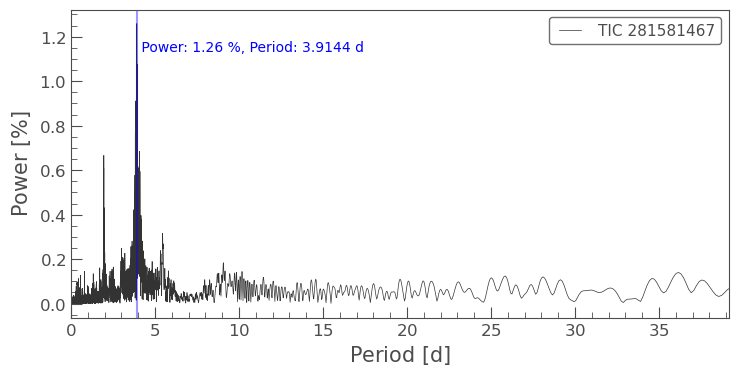

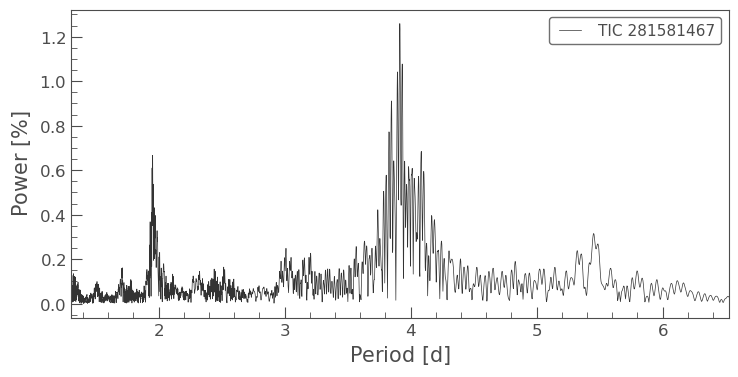

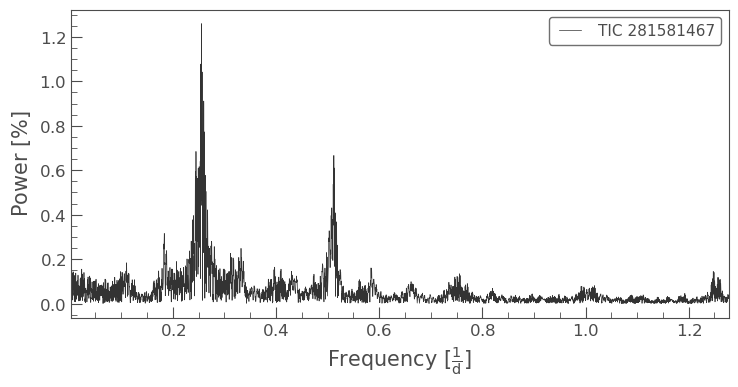

In [16]:
lke_pg.plot_pg_n_mark_max(pg, max_period_factor=10);

ax = pg.plot(view="period")  # period view, zoom in around peak
ax.set_xlim(pg.period_at_max_power.value / 3 , pg.period_at_max_power.value * 5/3);

ax = pg.plot(view="frequency");  # frequency view
ax.set_xlim(pg.frequency_at_max_power.value / 100 , pg.frequency_at_max_power.value * 5);

if not lc.meta.get("NORMALIZED") and pg.nterms == 1:
    # calc FAP. Somehow it does not work with normalized flux (always return 1.0 for normalized flux)
    pg_fap = pg._LS_object.false_alarm_probability(pg.max_power, method="baluev")  # the FAP is often useless if the lc is normalized
    print("False Alarm Probability:", pg_fap)

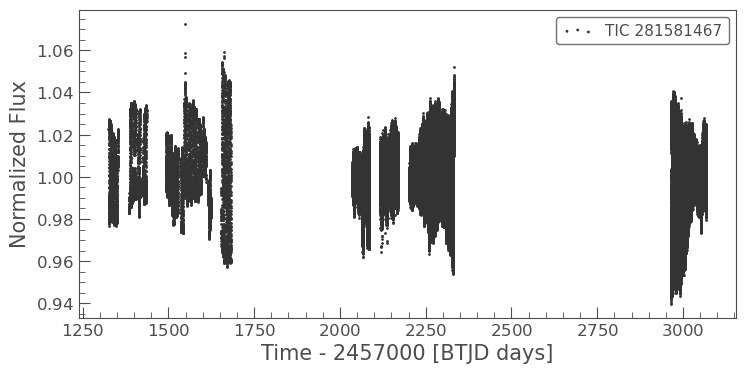

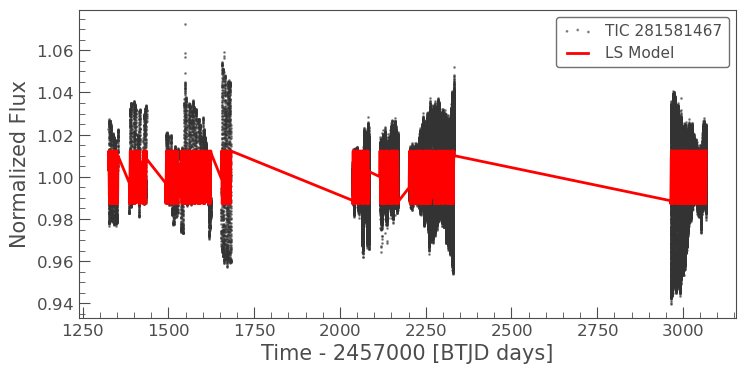

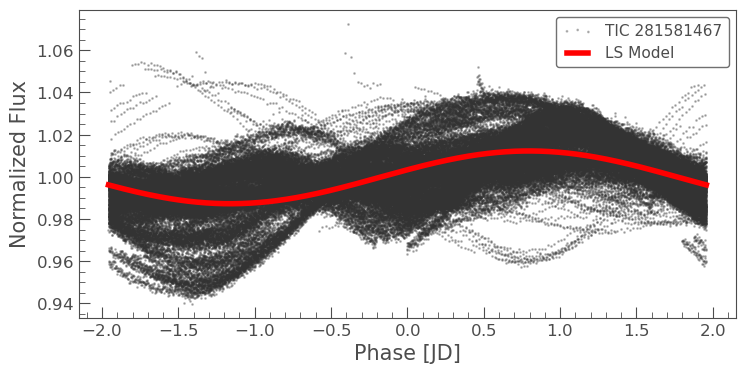

In [17]:
axs = lke_pg.plot_lc_with_model(lc_masked.normalize(), pg);

Animated folded lightcurve 

If the target has additional rotational variability,
- the period holds across sectors
- but the pattern within a period evolves over time. 

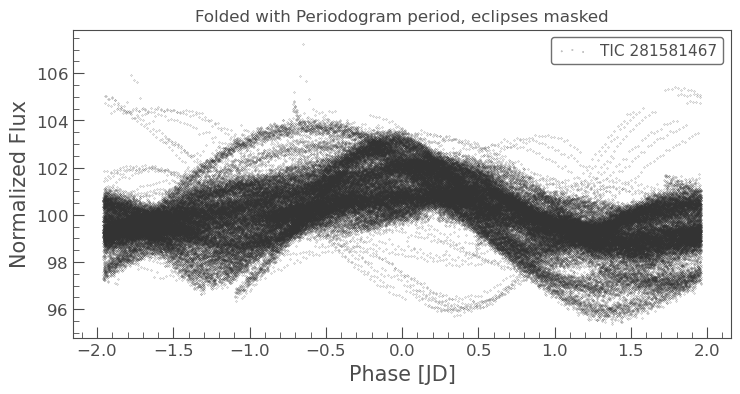

In [39]:
lc_add_var_f = lc_masked.normalize(unit="percent").fold(epoch_time=lc_masked.time.min(), period=pg.period_at_max_power)
ax = lc_add_var_f.scatter(alpha=1.0, s=0.1);
ax.set_title("Folded with Periodogram period, eclipses masked");

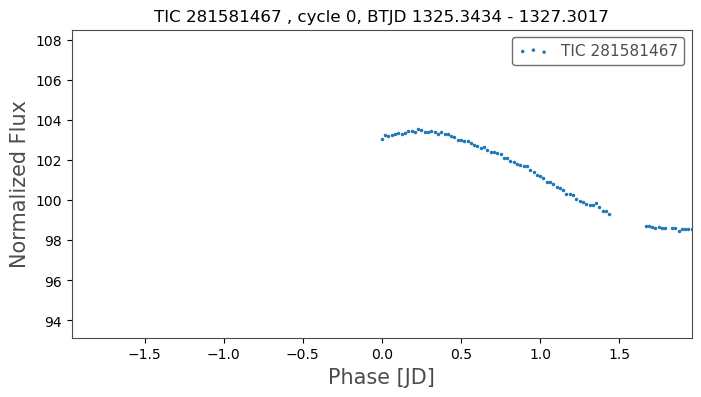

In [27]:
# animate the folded lightcurve (with periodogram period)
to_animate_folded_lc = True

if to_animate_folded_lc:
    ax = tplt.lk_ax(figsize=(8, 4))
    with plt.style.context(lk.MPLSTYLE):  # needed to main lightkurve style in animation
        lc_to_use = lc_add_var_f
        tplt.animate_folded_lightcurve(lc_to_use, ax=ax, interval=750, num_frames=240, plot_kwargs=dict(s=9));
    lc_to_use.meta.get("TARGETID"), len(np.unique(tplt.calc_cycles(lc_to_use)))

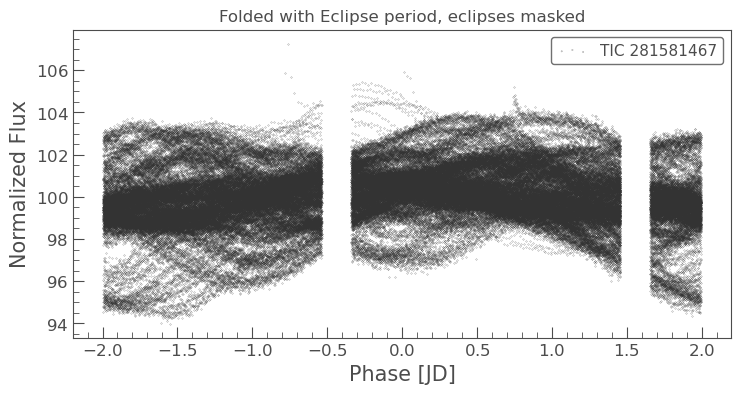

In [19]:
lc_add_var_f_e = lc_masked.normalize(unit="percent").fold(epoch_time=lc_masked.time.min(), period=transit_specs[0]["period"])
ax = lc_add_var_f_e.scatter(alpha=1.0, s=0.1);
ax.set_title("Folded with Eclipse period, eclipses masked");

In [29]:
# animate the folded lightcurve (with eclipse period)
to_animate_folded_lc = False

if to_animate_folded_lc:
    ax = tplt.lk_ax(figsize=(8, 4))
    with plt.style.context(lk.MPLSTYLE):  # needed to main lightkurve style in animation
        lc_to_use = lc_add_var_f_e
        tplt.animate_folded_lightcurve(lc_to_use, ax=ax, interval=750, num_frames=240, plot_kwargs=dict(s=9));    

## Contamination Check
<a name="contamination"></a>

### Lightcurve - background
<a name="lc-background-sso">

t0= 2037.2852


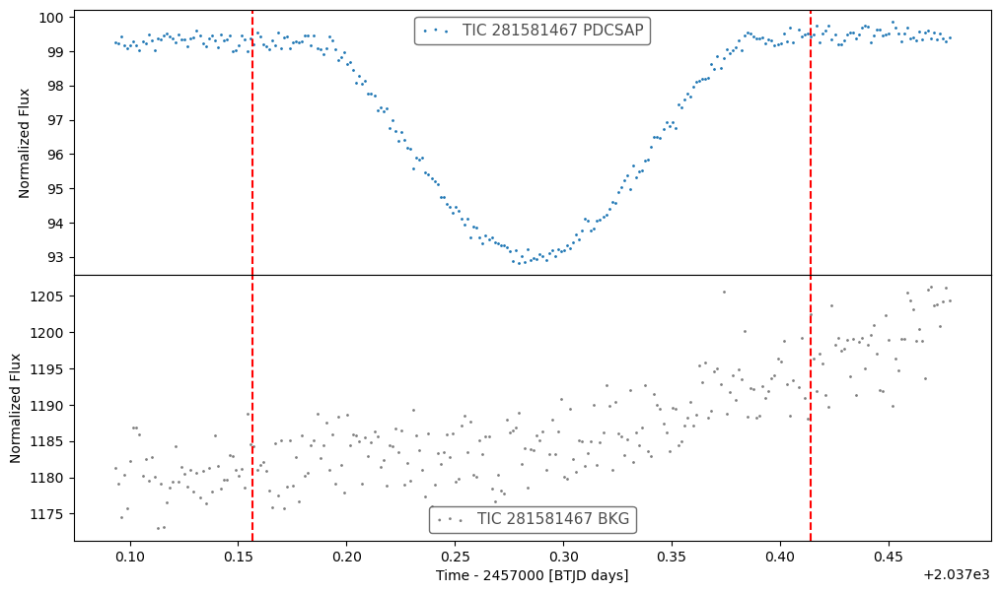

In [36]:
specs_idx, step_idx = 0, 0

lc = of_sector(lcf_coll,  transit_specs[specs_idx]["sector"])
lc = lc.normalize(unit='percent')

# Check the background flux for the duration in question
t0 = transit_specs[specs_idx]["epoch"]
period = transit_specs[specs_idx]["period"]
search_period = transit_specs[specs_idx]["duration_hr"] * 1.3 / 24
plot_period = search_period * 1.5 

steps_to_show = transit_specs[specs_idx]["steps_to_show"]
t0 = t0 + period *  steps_to_show[step_idx]

search_start, search_end = t0 - search_period /2, t0 + search_period /2
plot_start, plot_end = t0 - plot_period /2, t0 + plot_period /2

plot_binned = False
plot_sap_flux = False

fig, axs = plt.subplots(3 if plot_binned else 2, 1, sharex=True, figsize=(12, 10.5 if plot_binned else 7))
fig.subplots_adjust(hspace=0)

time_mask = (lc.time.value >= plot_start) & (lc.time.value <= plot_end)
if plot_binned:
    lc_b = lke.bin_flux(lc, time_bin_size = 30 * u.minute)  # bin it to speed up SSO search
    lc_b[(lc_b.time.value >= plot_start) & (lc_b.time.value <= plot_end)].scatter(ax=axs[0], label=lc.label + ' binned')

if plot_sap_flux:
    lc_sap[time_mask].scatter(column='sap_flux', ax=axs[-2], c='orange', label=lc.label + 'SAP')
else:
    lc[time_mask].scatter(ax=axs[-2], label=lc.label + ' PDCSAP')
    
lc_bkg = lke.get_bkg_lightcurve(lc)
lc_bkg[time_mask].scatter(ax=axs[-1], color='gray')

if True and search_start is not None:
    for ax in axs:
        ax.axvline(search_start, linestyle='--', c='r')
        ax.axvline(search_end, linestyle='--', c='r')

print('t0=', t0);

### TPF Download
<a name="tpf_download">

#,mission,year,author,exptime,target_name,distance,proposal_id
,,,,s,,arcsec,
0,TESS Sector 27,2020,SPOC,120,281581467,0.0,G03166


TessTargetPixelFile(TICID: 281581467)  , sector 27
     time: 2036.2947784333564 - 2060.640204209615
cadenceno: 582365 - 599894


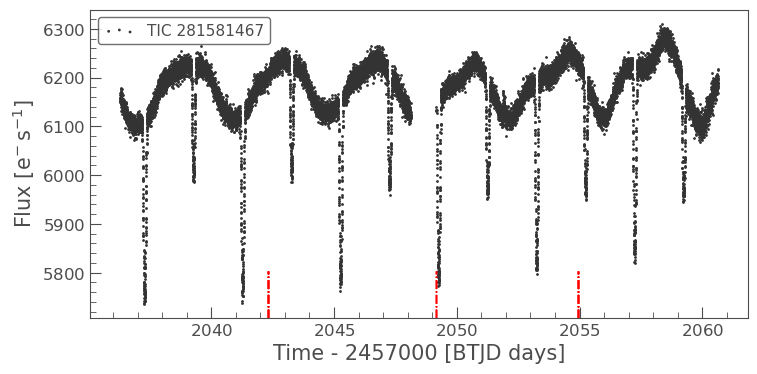

In [37]:
# Google colab user: this cell will fail with SyntaxError in await
# use the next cell instead.

global tpf_task  # need to define it as global, otherwise UnboundLocalError would occur
if tpf_task is None:
    tpf_task = lke.create_download_tpf_task(f"TIC{tic}", sector=sector, exptime="short", author='SPOC', mission="TESS", download_dir="data")
# else the download has been previoulsy initiated (in "Enter TIC" section, no need to do it),
#      no need to do it again

try:
    tpf_coll, sr_tpf = await tpf_task
    display(sr_tpf)
    
    if tpf_coll is not None and len(tpf_coll) > 0: 
        tpf_original =  tpf_coll[0]
        # data around a momentum dump is often very noisy, exclude them to avoid skewing subsequent plots
        tpf = lket.MomentumDumpsAccessor.exclude_around(tpf_original, window_before=15/60/24, window_after=15/60/24)

        print(tpf, " , sector", tpf.sector)
        print("     time:", tpf.time.min() , "-", tpf.time.max())
        print("cadenceno:", tpf.cadenceno.min() , "-", tpf.cadenceno.max())

        lc = tpf.to_lightcurve().remove_outliers(sigma=8)
        ax = lc.scatter();
        tplt.plot_momentum_dumps(lc, ax)
finally: 
    tplt.beep()
    tpf_task = None  # once task result is consumed, reset it so that one can run it again in the next run

### TPF Zoom in, deep eclipse
<a name="tpf_zoom_in">

In [23]:
ylim_func = lambda lc: (np.nanmin(lc.flux), np.nanmax(lc.flux))
# ylim_func = lambda lc: (np.nanpercentile(lc.flux, 0.1), np.nanpercentile(lc.flux, 99.9))

specs_idx, step_idx = 0, 0
t0 = transit_specs[specs_idx]["epoch"]
duration = transit_specs[specs_idx]["duration_hr"] / 24
period = transit_specs[specs_idx]["period"]
steps_to_show = transit_specs[specs_idx]["steps_to_show"]
t0 = t0 + period * steps_to_show[step_idx]
surround_time = 2.0

plot_start, plot_end = t0 - duration / 2 - surround_time / 2,  t0 + duration /2 + surround_time / 2


print('t0 =', t0);

# zoomed in to the time around the dip 
tpf_trunc = tpf[(tpf.time.value >= plot_start) & (tpf.time.value <= plot_end)]  # for Lightkurve 2 API

# zoom to arbitrary date range
# tpf_trunc = tpf[(tpf.time >= tpf.time.min() + 3) & (tpf.time <= tpf.time.min() + 12)]

if len(tpf_trunc) < 1:
    display(HTML("""<font style="background-color: red;">WARNGING:</font> the truncated TPF is zero length. Sunsequent operations would fail."""))


if (tpf_trunc.time.max() - tpf_trunc.time.min()) > 3 * u.day:
    display(HTML(('<span style="background-color: yellow">Note:</span> The TPF spans over a long time. Consider to zoom in. Duration: '
                  f'{(tpf_trunc.time.max() -tpf_trunc.time.min()).to(u.day)}')))

if 'google.colab' in str(get_ipython()):
    tpf_trunc.to_lightcurve().scatter();
else: 
    tpf_trunc.interact(ylim_func=ylim_func,
#                        aperture_mask=tpf.background_mask
                       transform_func=tplt.normalize_percent,
                       notebook_url=notebook_url,
                      );

t0 = 2037.2852


In [78]:
tpf_mag = tpf_trunc.meta.get("TESSMAG")
print('Target magnitude: ', tpf_mag)
magnitude_limit = tpf_mag + 8 if tpf_mag is not None else 18

tplt.show_tpf_orientation(tpf)
tplt.interact_sky(tpf_trunc, aperture_mask="pipeline", magnitude_limit = magnitude_limit, notebook_url=notebook_url,);
tplt.show_nearby_tic_summary_form();

Target magnitude:  10.95030022


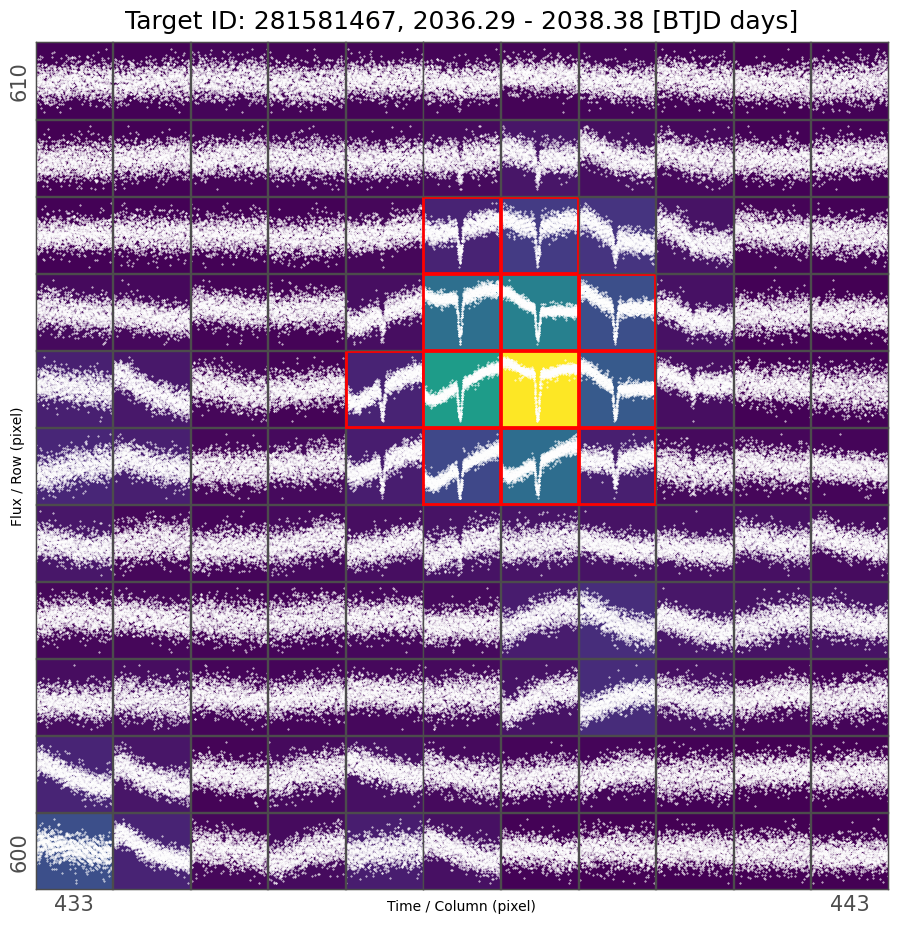

In [24]:
pixel_size_inches, markersize = 1.0, 0.8
fig = plt.figure(figsize=(tpf.flux[0].shape[1] * pixel_size_inches, tpf.flux[0].shape[0] * pixel_size_inches))
ax = tpf_trunc.plot_pixels(ax=fig.gca(), aperture_mask=tpf_trunc.pipeline_mask, show_flux=True, markersize=markersize);
tplt.beep();

### TPF Zoom In, shallow eclipses

In [25]:
ylim_func = lambda lc: (np.nanmin(lc.flux), np.nanmax(lc.flux))
# ylim_func = lambda lc: (np.nanpercentile(lc.flux, 0.1), np.nanpercentile(lc.flux, 99.9))

specs_idx, step_idx = 1, 0
t0 = transit_specs[specs_idx]["epoch"]
duration = transit_specs[specs_idx]["duration_hr"] / 24
period = transit_specs[specs_idx]["period"]
steps_to_show = transit_specs[specs_idx]["steps_to_show"]
t0 = t0 + period *  steps_to_show[step_idx]
surround_time = 2.0

plot_start, plot_end = t0 - duration / 2 - surround_time / 2,  t0 + duration /2 + surround_time / 2


print('t0 =', t0);

# zommed in to the time around the dip 
tpf_trunc = tpf[(tpf.time.value >= plot_start) & (tpf.time.value <= plot_end)]  # for Lightkurve 2 API

# zoom to arbitrary date range
# tpf_trunc = tpf[(tpf.time >= tpf.time.min() + 3) & (tpf.time <= tpf.time.min() + 12)]

if len(tpf_trunc) < 1:
    display(HTML("""<font style="background-color: red;">WARNGING:</font> the truncated TPF is zero length. Sunsequent operations would fail."""))


if (tpf_trunc.time.max() - tpf_trunc.time.min()) > 3 * u.day:
    display(HTML(('<span style="background-color: yellow">Note:</span> The TPF spans over a long time. Consider to zoom in. Duration: '
                  f'{(tpf_trunc.time.max() -tpf_trunc.time.min()).to(u.day)}')))

if 'google.colab' in str(get_ipython()):
    tpf_trunc.to_lightcurve().scatter();
else: 
    tpf_trunc.interact(ylim_func=ylim_func,
#                        aperture_mask=tpf.background_mask
                       transform_func=tplt.normalize_percent,
                       notebook_url=notebook_url,
                      );

t0 = 2039.280663


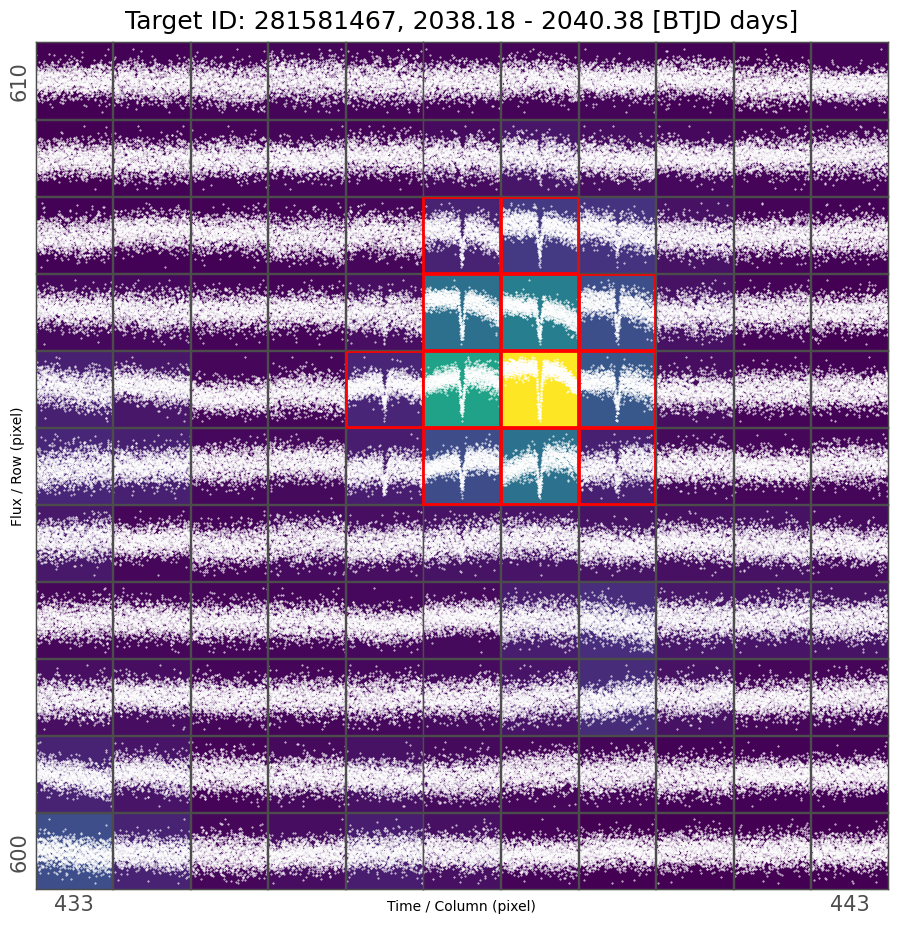

In [81]:
fig = plt.figure(figsize=(tpf.flux[0].shape[1] * pixel_size_inches, tpf.flux[0].shape[0] * pixel_size_inches))
ax = tpf_trunc.plot_pixels(ax=fig.gca(), aperture_mask=tpf_trunc.pipeline_mask, show_flux=True, markersize=markersize);
tplt.beep();

## Reports
<a name="reports"></a>

In [40]:
# Common elements for reports

def get_mag_range_mag_text():
    return f"Mag. range: {flux_range_mag[0]:.2f} - {flux_range_mag[1]:.2f} TESS"


# Fill in for this target
variable_type = "EA+BY"
remarks = f"{get_mag_range_mag_text()} . Rotational period: {lc_add_var_f.meta['PERIOD']:.5f} . Some flares."

# Common helpers, no need to modify
def report_to_df(report):
    df = pd.DataFrame()
    df["Field"] = report.keys()
    df["Value"] = report.values()
    return df

### EB Report 
<a name="eb_report"></a>

In [41]:
obs_span_cycles = obs_span / transit_specs[0]["period"]
sectors_all = ",".join([str(s) for s in sr.table["sequence_number"]])
sectors_short_cadence = ",".join([str(s) for s in sr[sr.author == "SPOC"].table["sequence_number"]])  # it could include fast cadence in theory, but not relevant for our usage here.

eb_report = dict(
    tic_id=tic,
    variable_type=variable_type,
    period=transit_specs[0]["period"],
    epoch_deep=transit_specs[0]["epoch"],
    duration_hr_deep=transit_specs[0]["duration_hr"],
    depth_deep=depth_deep,
    epoch_shallow=transit_specs[1]["epoch"],
    duration_hr_shallow=transit_specs[1]["duration_hr"],
    depth_shallow=depth_shallow,
    observation_span_days=obs_span,
    observation_span_cycles=obs_span_cycles,
    observation_actual_days=obs_actual_days,
    observation_actual_cycles=obs_actual_cycles,
    sectors=sectors_all,  # used to determine period, epoch, duration 
    sectors_short_cadence=sectors_short_cadence,  # used to deteremine depth
    remarks=remarks,  
)

with pd.option_context('display.max_colwidth', None):
    display(report_to_df(eb_report))

,Field,Value
0,tic_id,281581467
1,variable_type,EA+BY
2,period,3.990926
3,epoch_deep,2037.2852
4,duration_hr_deep,4.7531
5,depth_deep,0.06836997486768293
6,epoch_shallow,2039.280663
7,duration_hr_shallow,4.7531
8,depth_shallow,0.04102066556878681
9,observation_span_days,1007.236064


### VSX Preparation

In [42]:
# needed for combined plot and final report
if len(all_meta.gaia) > 0:
    target_ra = all_meta.gaia['RAJ2000'].iloc[0]
    target_dec = all_meta.gaia['DEJ2000'].iloc[0]
    target_position = f"{target_ra}, {target_dec}"
    target_position_src = "Gaia DR3"
else:
    print("No Gaia DR3 position available. Use custom one")
    target_ra = "fo fill in"
    target_dec = "fo fill in"
    target_position = "to fill in"
    target_position_src = "to fill in"


# heuristics to determine primary name for VSX
if len(all_meta.vsx) > 0:
    print("INFO: case updating an existing VSX entry. Use existing primary name")
    primary_name = all_meta.vsx["Name"].iloc[0]
elif len(all_meta.simbad) > 0:  # OPEN: for new VSX entry, one might want to use TIC ID
    primary_name = all_meta.simbad["MAIN_ID"].iloc[0]
elif len(all_meta.asas_sn) > 0:
    primary_name = f"""ASASSN-V {all_meta.asas_sn["ASASSN-V"].iloc[0]}"""
else:
    primary_name = "to fill in"

INFO: case updating an existing VSX entry. Use existing primary name


In [43]:
import os
from astropy.coordinates import SkyCoord
from astropy.table import QTable

def to_time_in_hjd_utc(lc, target_coord, cache_dir="."):
    def get_cache_key(lc):        
        sectors_str = "_".join([str(s) for s in lc.meta.get("SECTORS", [])])
        if sectors_str == "":
            sectors_str = lc.meta.get("SECTOR", "na")
        return f"""hjd_tic{lc.ticid}_{sectors_str}.txt"""
            
    
    def time_in_hjd_utc(lc, target_coord, cache_dir):
        # actual time conversion to HJD UTC
        # it can be take a while (close to 1 minute for 160K)
        # so we support caching the result persistently
        hjd_time_val = None
        cache_file = f"{cache_dir}/hjd/{get_cache_key(lc)}"
        if (os.path.exists(cache_file)) and (os.path.getsize(cache_file) > 0):
            hjd_time_val = np.genfromtxt(cache_file)
            #  ensure the cached time is compatible with the input LC
            if len(lc) == len(hjd_time_val):                
                return hjd_time_val
            else:
                print(f"The cached HJD time in {cache_file} has different length. discard it.")
                hjd_time_val = None
        
        
        # else cache miss        
        if target_coord is not SkyCoord: 
            target_coord = SkyCoord(target_coord["ra"], target_coord["dec"], unit=(u.deg, u.deg), frame="icrs")
        hjd_time_val = lke.to_hjd_utc(lc.time, target_coord).value
        
        # write to cache
        os.makedirs(os.path.dirname(cache_file), exist_ok=True)
        np.savetxt(cache_file, hjd_time_val, fmt="%f", header="hjd")
        return hjd_time_val

    # the main logic
    hjd_time_val = time_in_hjd_utc(lc, target_coord, cache_dir)
    
    # create a new LC object with the HJD time. 
    # It does not modify the time of an existing LC object, because it is extremely slow.
    data = QTable(data=lc)
    data.remove_column("time")    
    lc_hjd = lc.__class__(time=Time(hjd_time_val, format="jd", scale="utc"), data=data)
    lc_hjd.meta.update(lc.meta)
    
    return lc_hjd


In [44]:
# Get ASAS-SN data to increase the baseline

import lightkurve_ext_readers as lker
reload(lker)

# local version of https://asas-sn.osu.edu/sky-patrol/coordinate/829f5083-de42-46df-b29d-aefdca8ec627
# SkyPatrol version of ASASSN-V J074356.31-602347.0 , from 2014-04-29 to 2023-01-17
lc_asassn = lker.read_asas_sn_csv("data/asas-sn/asas-sn_tic281581467_light_curve_829f5083-de42-46df-b29d-aefdca8ec627.csv")
lc_asassn.meta.update(dict(
    ASASSN_NAME=f"""ASASSN-V {all_meta.asas_sn["ASASSN-V"].iloc[0]}""",
    # the following is from the SkyPatrol page
    ASASSN_MEDIAN_MAG_V=11.76,
    ASASSN_MEDIAN_MAG_G=12.15,
    ASASSN_RMS_V=0.03,
    ASASSN_RMS_G=0.04,    
))
lc_asassn.meta["LABEL"] = lc_asassn.meta["ASASSN_NAME"]

lc_asassn = lc_asassn.select_flux("mag")
# tplt.scatter_partition_by(lc_asassn, "filter");


# comparable TESS data, in TESS magnitude

lc_tess = lke.stitch(lcf_coll, corrector_func=tplt.normalize_percent, ignore_incompatible_column_warning=True)
# lc_tess = lke.stitch(lcf_coll, corrector_func=lambda lc: lc.select_flux("sap_flux").normalize(), ignore_incompatible_column_warning=True)  # if SAP_FLUX is better suited
lc_tess= lke.to_flux_in_mag_by_normalization(lc_tess)
lc_tess = to_time_in_hjd_utc(lc_tess, dict(ra=target_ra, dec=target_dec), cache_dir="data")
# lc_tess.scatter();


def shift_flux(lc, lc_ref, inplace=False):
    shift = np.nanmedian(lc_ref.flux) -  np.nanmedian(lc.flux)
    if not inplace:
        lc = lc.copy()
    lc.flux += shift
    lc.meta["FLUX_SHIFT"] = shift
    if inplace:
        return
    else:
        return lc
    
    
def combine_tess_n_asassn(lc_tess, lc_asassn, shift_to_v=True):
    lc_tess = lc_tess.copy()  # ensure users who furtrher modify the result won't affect the source
    if "filter" in lc_asassn.colnames:
        lc_asassn_v = lc_asassn[lc_asassn["filter"] == "V"]
        lc_asassn_g = lc_asassn[lc_asassn["filter"] == "g"]
        if len(lc_asassn_g) < 1:
            lc_asassn_g = None
    else:
        lc_asassn_v = lc_asassn
        lc_asassn_g = None
    
    if shift_to_v:
        shift_flux(lc_tess, lc_ref=lc_asassn_v, inplace=True)
        if lc_asassn_g is not None:
            shift_flux(lc_asassn_g, lc_ref=lc_asassn_v, inplace=True)
    
    return {"TESS": lc_tess, "ASAS-SN_V": lc_asassn_v, "ASAS-SN_g": lc_asassn_g}


lc_combined_dict = combine_tess_n_asassn(lc_tess, lc_asassn, shift_to_v=True)
for k in lc_combined_dict.keys():
    print(f"{k} # data points:", len(lc_combined_dict[k]))

TESS # data points: 163328
ASAS-SN_V # data points: 1039
ASAS-SN_g # data points: 3709


#### Combined Lightcurve

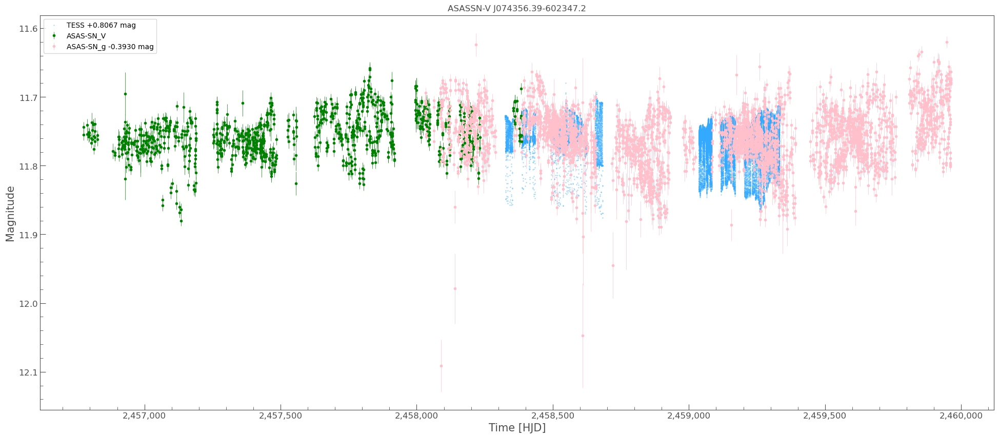

In [45]:
from  matplotlib.ticker import FuncFormatter

def get_label_of_source(lc_dict, source):
    lc = lc_dict[source]
    mag_shift = lc.meta.get("FLUX_SHIFT", None)
    if mag_shift is not None and mag_shift != 0:        
        sign_str = "+" if mag_shift > 0 else ""
        return f"{source} {sign_str}{mag_shift:.4f}"
    else:
        return source

    
def plot_tess_n_asassn(lc_combined_dict, figsize, target_name):        
    ax = tplt.lk_ax(figsize=figsize)
    ax.invert_yaxis();

    # scatter plot for the dense TESS data, error is relatively small
    lc = lc_combined_dict["TESS"]
    ax.scatter(lc.time.value, lc.flux.value, c="#3AF", s=0.1, alpha=1.0, label=get_label_of_source(lc_combined_dict, "TESS"));

    # use errorbar for the more sparse ASAS-SN data
    lc = lc_combined_dict["ASAS-SN_V"]
    ax.errorbar(
        x=lc.time.value, y=lc.flux.value,  yerr=lc.flux_err.value, 
        marker=".", c="green", linewidth=0.5, ls="none", 
        label=get_label_of_source(lc_combined_dict, "ASAS-SN_V")
    );

    lc = lc_combined_dict["ASAS-SN_g"]
    if lc is not None:
        ax.errorbar(
            x=lc.time.value, y=lc.flux.value,  yerr=lc.flux_err.value, 
            marker=".", c="pink", linewidth=0.5, ls="none", 
            label=get_label_of_source(lc_combined_dict, "ASAS-SN_g")
        );
    
    ax.legend();
    ax.set_xlabel("Time [HJD]");
    ax.set_ylabel("Magnitude");
    ax.set_title(f"""{target_name}""");
    ax.xaxis.set_major_formatter(FuncFormatter(lambda x, p: format(int(x), ",")))  # thousands separator
    return ax

# Actual plots
ax= plot_tess_n_asassn(
    lc_combined_dict,
    figsize=(24, 10),
    target_name=primary_name, # use VSX-preferred name    
);

In [76]:
plot_interactive = False
if plot_interactive:
    %matplotlib widget

    ax= plot_tess_n_asassn(
        lc_combined_dict,
        figsize=(20, 8),
        target_name=primary_name, # use VSX-preferred name    
    );

#### BLS on Combined Lightcurve

In [82]:
def stitch_from_multi_bands(lc_by_band, band_column="band", **stitch_kwargs):
    lcs = []
    # annotate each band with a band column
    for band in lc_by_band.keys():
        lc = lc_by_band[band]
        if band_column is not None:
            lc = lc.copy()
            lc[band_column] = band
        lcs.append(lc)
    lcc = lk.LightCurveCollection(lcs)
    # TODO: return  shift data from lc.meta.get("FLUX_SHIFT")
    return lke.stitch(lcc, ignore_incompatible_column_warning=True, **stitch_kwargs)


In [75]:
def mag_to_normalized_lc(lc, **normalize_kwargs):
    """Convert a lightcurve in magnitude to normalized flux"""
    # reverse of
    # mag = base_mag + 2.5 * np.log10(1 / flux_val)
    if lc.flux.unit is not u.mag:
        raise ValueError(f"The lighcurve's flux must be in unit magnitude. Actual: {lc.flux.unit}")
    mag = lc.flux.value
    mag_err = lc.flux_err.value
    
    # convert magnitude to linear-scale flux
    # (the actual value is meaningless, but it can serve as the basis of normalization)
    flux_val = 1 / (10 ** (mag/2.5))
    flux_err_val =  1 / (10 ** (mag/2.5))
    
    res_lc = lc.copy()
    res_lc.flux = flux_val
    res_lc.flux_err = mag_err
    return res_lc.normalize(**normalize_kwargs)


C:\dev\_juypter\pht_eb_stats2\vetting\lightkurve_ext_pg.py:343: UserWarning: validate_bls_n_report() cannot calculate FAP, because the depdent package transitleastsquares is not installed
  warnings.warn(


BLS run time: 185.0s


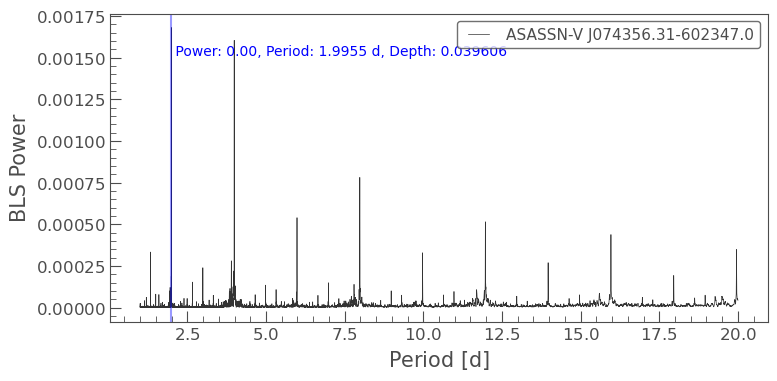

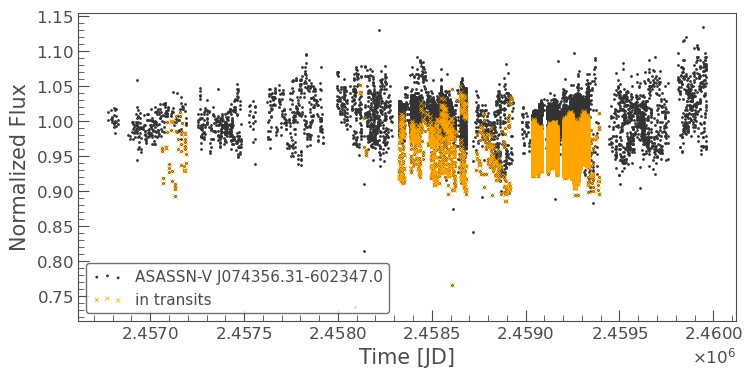

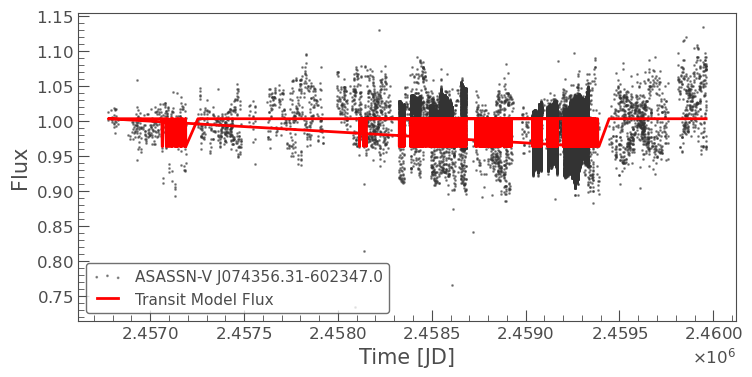

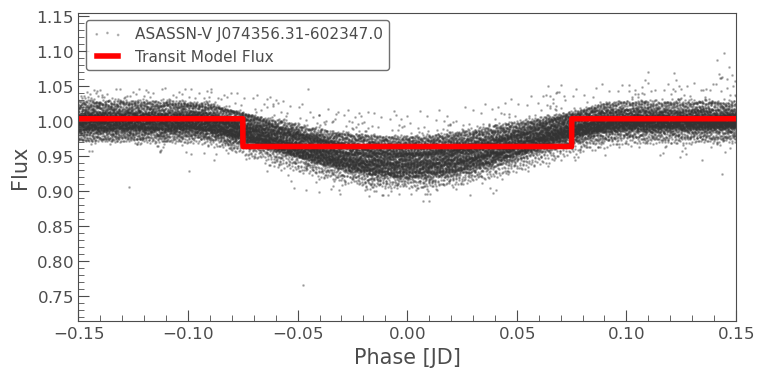

In [74]:
run_bls = False

if run_bls:
    lc_combined = stitch_from_multi_bands(lc_combined_dict, corrector_func=lambda lc: lc)
#     tplt.scatter(lc_combined);    

    # data points for BLS run time
    # for a ASAS-SN + TESS LC, spanning 1636 days, with 168076 data points
    # - minimum_period=1, maximum_period=20, frequency_factor=1000:
    #   - run_time: 185s, period grize size: 192758
    t_bls_start = time.time()
    result = lke_pg_runner.run_bls(mag_to_normalized_lc(lc_combined), pg_kwargs=dict(
        minimum_period=1, maximum_period=20,
        frequency_factor=1000,
    ))
    t_bls_end = time.time()
    print(f"BLS run time: {round(t_bls_end - t_bls_start, 1)}s")


##### Phase Plot for eclipses

In [92]:
# rounded to the needed precision, to ensure the report and the plot use the same precision
main_period_to_report = round(transit_specs[0]["period"], 5)
main_period_to_report

main_epoch_to_report_hjd = lket.btjd_to_hjd_utc(transit_specs[0]["epoch"], target_position)
main_epoch_to_report = Time(round(main_epoch_to_report_hjd, 4), format="jd", scale="utc")


# Override the period from TESS EB analysis
# the following is from Sebastián, based on TESS (2 minute cadence) + ASAS-SN data with Period04
main_period_to_report = 3.99095
main_epoch_to_report_hjd = 2459037.287
main_epoch_to_report = Time(round(main_epoch_to_report_hjd, 3), format="jd", scale="utc")


(main_period_to_report, main_epoch_to_report)

(3.99095, <Time object: scale='utc' format='jd' value=2459037.287>)

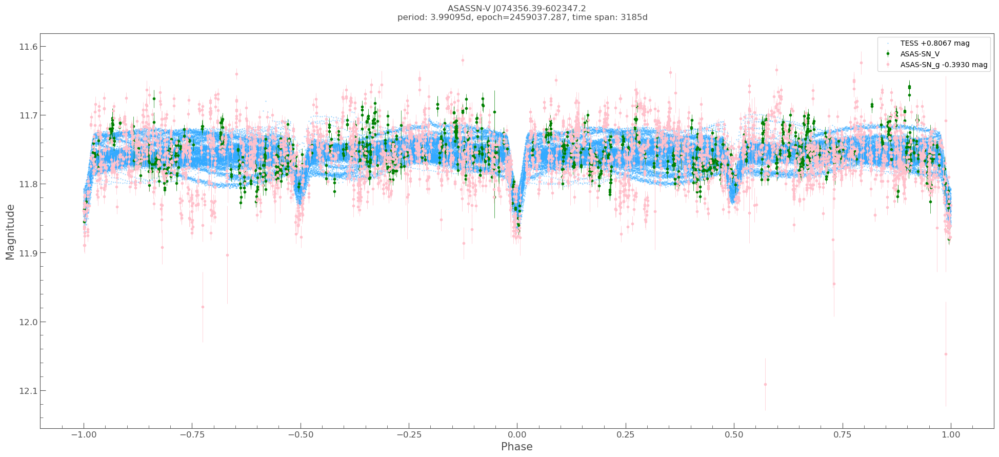

In [96]:
%matplotlib inline

# Eclipse phase plot of TESS and ASAS-SN


def fold_n_plot_tess_n_asassn(lc_combined_dict, period, epoch: Time, phase_scale, target_coord, figsize=(8,4), target_name=None, ax=None):
    def fold_at_scale(lc, **kwargs):
        if lc is None:
            return None
        kwargs = kwargs.copy()
        kwargs["period"] = kwargs["period"] * phase_scale
        lc_f = lc.fold(**kwargs)
        return lc_f

    from astropy.coordinates import SkyCoord
    
    if epoch.format == "jd" and epoch.scale == "utc":
        # if already in HJD UTC, avoid unnecesary conversion which would also have underisable effect on precision
        epoch_hjd = epoch
    else:
        epoch_hjd = lke.to_hjd_utc(epoch, SkyCoord(target_coord["ra"], target_coord["dec"], unit=(u.deg, u.deg), frame="icrs"))

    lc_tess_f = fold_at_scale(lc_combined_dict.get("TESS"), epoch_time=epoch_hjd, period=period, normalize_phase=True)
    lc_asassn_v_f = fold_at_scale(lc_combined_dict.get("ASAS-SN_V"), epoch_time=epoch_hjd, period=period, normalize_phase=True)
    lc_asassn_g_f = fold_at_scale(lc_combined_dict.get("ASAS-SN_g"), epoch_time=epoch_hjd, period=period, normalize_phase=True)
    
    if ax is None:
        ax = tplt.lk_ax(figsize=figsize)
    
    ax.invert_yaxis();
    
    if lc_tess_f is not None and len(lc_tess_f) > 0:
        ax.scatter(lc_tess_f.time * phase_scale, lc_tess_f.flux.value, c="#3AF", s=0.1, alpha=1.0, label=get_label_of_source(lc_combined_dict, "TESS"));

    if lc_asassn_v_f is not None and len(lc_asassn_v_f) > 0:
        ax.errorbar(
            x=lc_asassn_v_f.time * phase_scale, y=lc_asassn_v_f.flux.value,  yerr=lc_asassn_v_f.flux_err.value, 
            marker=".", c="green", linewidth=0.5, ls="none", 
            label=get_label_of_source(lc_combined_dict, "ASAS-SN_V")
        );

    if lc_asassn_g_f is not None and len(lc_asassn_g_f) > 0:
        ax.errorbar(
            x=lc_asassn_g_f.time * phase_scale, y=lc_asassn_g_f.flux.value,  yerr=lc_asassn_g_f.flux_err.value, 
            marker=".", c="pink", linewidth=0.5, ls="none", 
            label=get_label_of_source(lc_combined_dict, "ASAS-SN_g")
        );
    

    ax.legend();
    ax.set_xlabel("Phase");
    ax.set_ylabel("Magnitude");
    time_all = np.array([])
    if lc_tess_f is not None:
        time_all = np.concatenate([time_all, lc_tess_f.time_original.to_value("jd")])
    if lc_asassn_v_f is not None:
        time_all = np.concatenate([time_all, lc_asassn_v_f.time_original.to_value("jd")])
    if lc_asassn_g_f is not None:
        time_all = np.concatenate([time_all, lc_asassn_g_f.time_original.to_value("jd")])
    plot_time_span = time_all.max() - time_all.min()
    ax.set_title(f"""{target_name}
    period: {period}d, epoch={epoch_hjd.value}, time span: {plot_time_span:.0f}d
    """);
    
    return ax, {"TESS": lc_tess_f, "ASAS-SN_V": lc_asassn_v_f, "ASAS-SN_g": lc_asassn_g_f}


ax, lc_f_res = fold_n_plot_tess_n_asassn(
    lc_combined_dict,
    period=main_period_to_report, 
    epoch=main_epoch_to_report,
    phase_scale=2,  #  fold at  period, i.e., plot from phase -1 to +1
    target_coord=dict(ra=target_ra, dec=target_dec),
    figsize=(24, 10),
    target_name=primary_name, # use VSX-preferred name    
);

C:\dev\_juypter\pht_eb_stats2\vetting\tic_plot.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  return plt.figure(*args, **kwargs).gca()


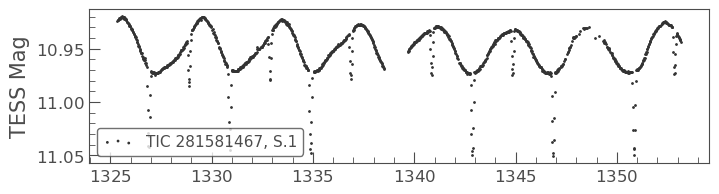

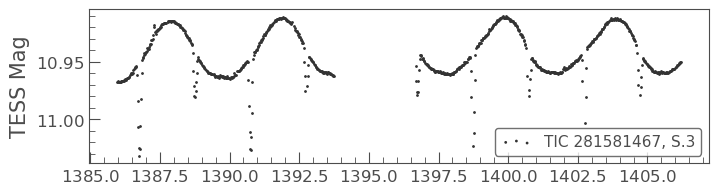

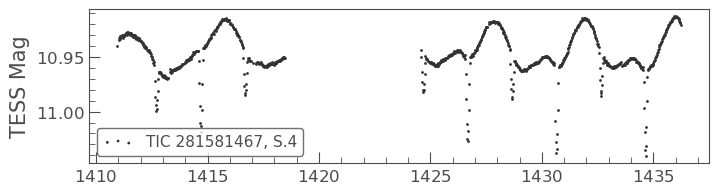

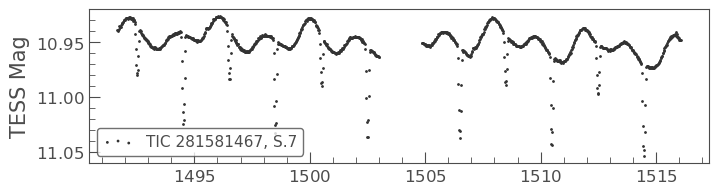

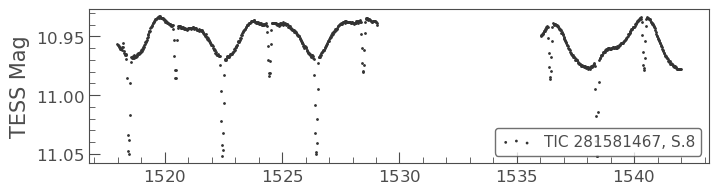

...

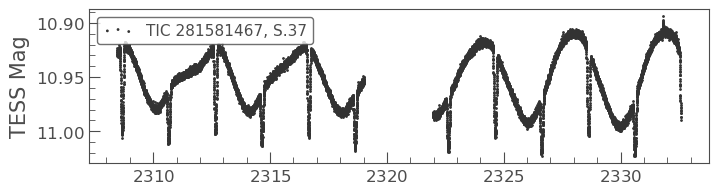

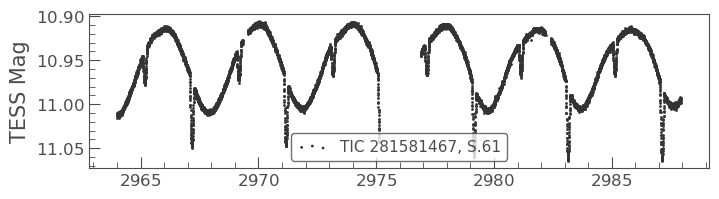

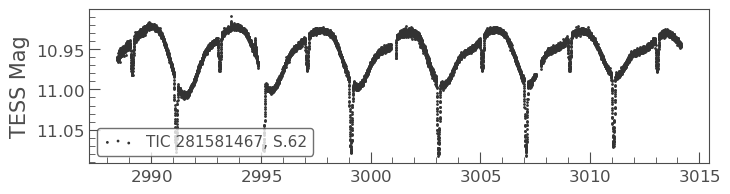

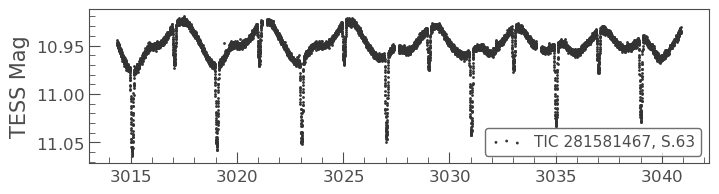

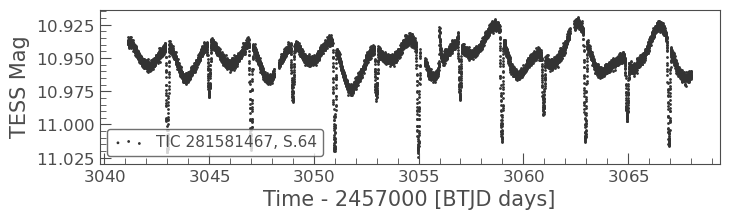

In [39]:
# Identify flares magnitude

lcf_coll_mag = lk.LightCurveCollection([lke.to_flux_in_mag_by_normalization(lc) for lc in lcf_coll])

def plot_all():
    axs = []
    lcf_subset = lcf_coll_mag
    lcf_subset = of_sectors(lcf_coll_mag, )  # 1, 3, 7, 8, 36, 37
    for i, lc in enumerate(lcf_subset):
        ax = tplt.lk_ax(figsize=(8, 2))
        ax = tplt.scatter(lc, ax=ax, label=f"{lc.label}, S.{lc.sector}")
        ax.set_ylabel('TESS Mag')
        if i < len(lcf_subset) - 1:
            ax.set_xlabel('')
        axs.append(ax)
    return axs

axs = plot_all();

##### Zoom In Plot for the larget flare

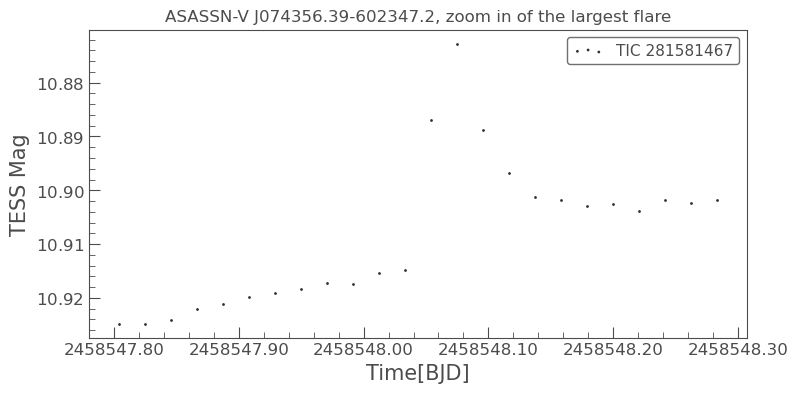

In [40]:
lc_flare_z = of_sector(lcf_coll_mag, 9).truncate(1547.8, 1548.3)
lc_flare_z.time.format = "jd"
ax = tplt.scatter(lc_flare_z)
ax.xaxis.set_major_formatter(FormatStrFormatter("%.2f"));
ax.set_xlabel("Time[BJD]")
ax.set_ylabel("TESS Mag");
ax.set_title(f"{primary_name}, zoom in of the largest flare");

#### Rotational Analysis with ASAS-SN and TESS data

In [41]:
lc_combined_dict_no_shift = combine_tess_n_asassn(lc_tess, lc_asassn, shift_to_v=False)
tmp_shift = -1.1  # to bring them closer for plotting purposes (but not zero-shift it)
lc_combined_dict_no_shift["ASAS-SN_g"].flux += tmp_shift *u.mag
lc_combined_dict_no_shift["ASAS-SN_g"].meta["FLUX_SHIFT"] = tmp_shift

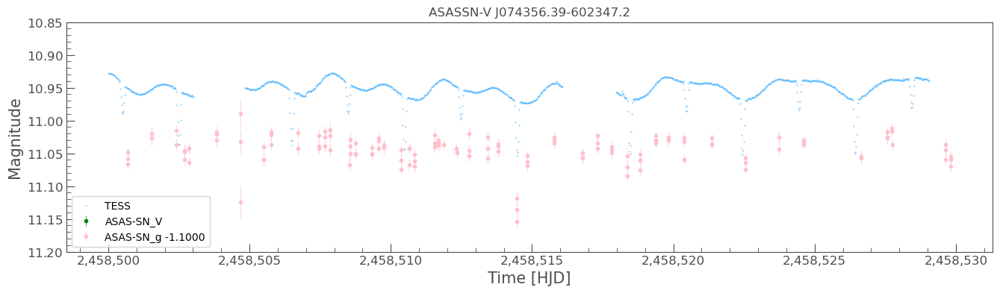

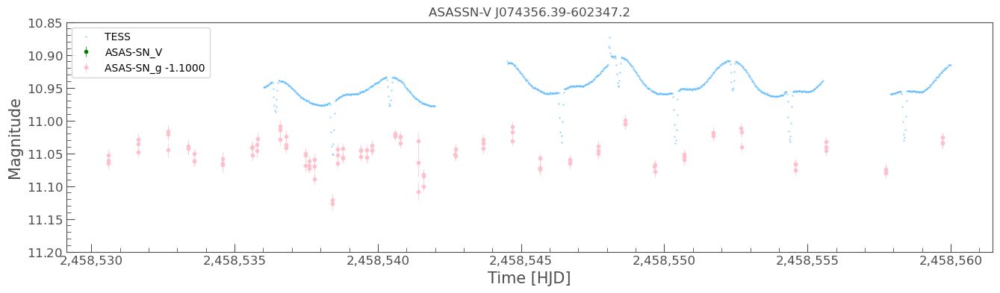

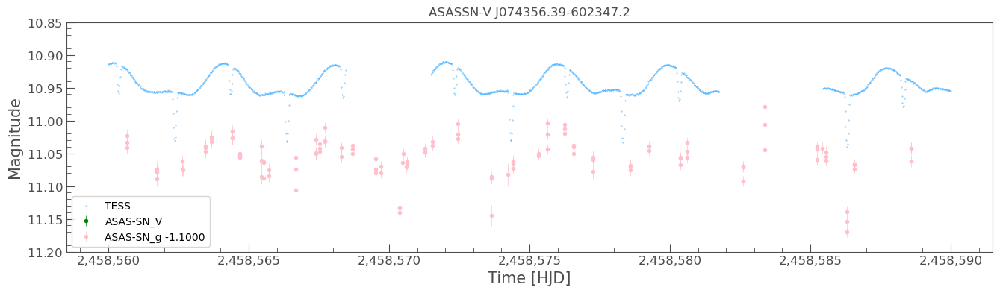

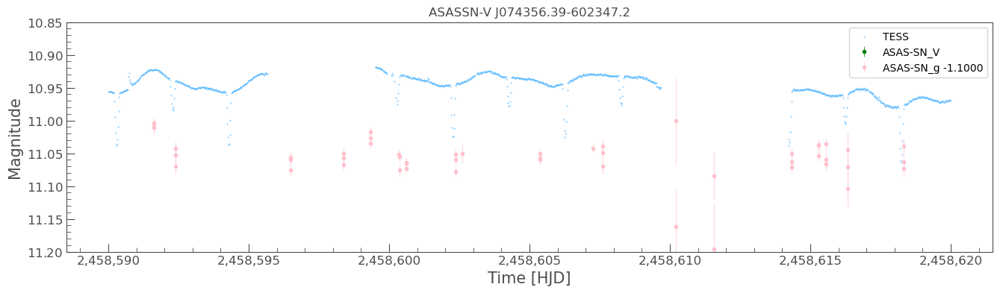

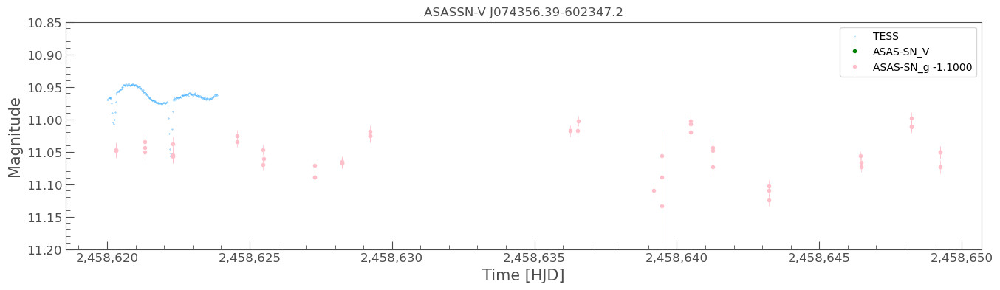

In [42]:
def truncate_lc_dict(lc_dict, *args, **kwargs):
    return { k: lc_dict[k].truncate(*args, **kwargs) for k in lc_dict.keys() }

# zoom in to see how well TESS result fit with ASAS-SN results
for i in range(0, 5):
    ax_z= plot_tess_n_asassn(
        truncate_lc_dict(
            lc_combined_dict_no_shift,
            2458500 + 30 * i, 2458500 + 30 * (i+1),
        ),
        figsize=(16, 4),
        target_name=primary_name, # use VSX-preferred name    
    );
    ax.set_title("")
    ax_z.set_ylim(11.2, 10.85);

In [108]:
def mask_lc_dict(lc_dict, *args, **kwargs):
    res = dict()
    for k in lc_dict.keys():
        lc = lc_dict[k]
        res[k] = lc[~lc.create_transit_mask(*args, **kwargs)]
    return res


# Use the transit times from TESS Analysis
# lc_combined_dict_masked = mask_lc_dict(lc_combined_dict, transit_time=lket.btjd_to_hjd_utc(transit_specs.epoch, target_position), period=transit_specs.period, duration=transit_specs.duration)

# Use the transit times from combined analysis
time_for_mask = [
    main_epoch_to_report_hjd,
    main_epoch_to_report_hjd + main_period_to_report / 2
]
period_for_mask = main_period_to_report

lc_combined_dict_masked = mask_lc_dict(lc_combined_dict, transit_time=lket.btjd_to_hjd_utc(transit_specs.epoch, target_position), period=transit_specs.period, duration=transit_specs.duration)

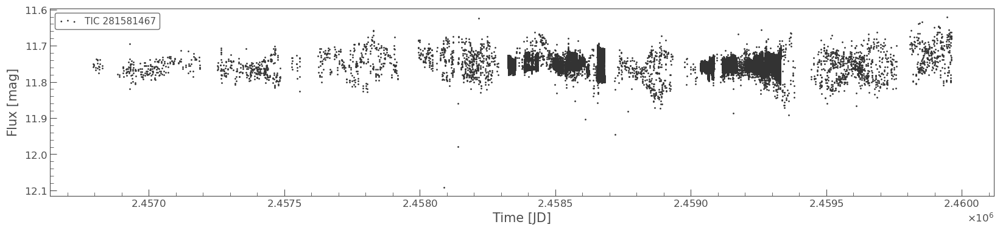

In [113]:
# prepare a combined TESS, ASAS-SN_V, ASAS-SN_g to a single lightcurve, zero-shifted to V for rotational period analysis

lc2 = lk.LightCurveCollection(lc_combined_dict.values()).stitch(corrector_func=lambda lc: lc)
# workaround the issue that the stitched lightcurve is treated as a TessLightCurve , which caused error in to_fits() due to missing expected colkumns
lc2 = lk.LightCurve(time=lc2.time, flux=lc2.flux, flux_err=lc2.flux_err)  
lc2.meta["LABEL"] = f"TIC {tic}"

# eclipse-masked varaint
lc2_masked = lk.LightCurveCollection(lc_combined_dict_masked.values()).stitch(corrector_func=lambda lc: lc)
# workaround the issue that the stitched lightcurve is treated as a TessLightCurve , which caused error in to_fits() due to missing expected colkumns
lc2_masked = lk.LightCurve(time=lc2_masked.time, flux=lc2_masked.flux, flux_err=lc2_masked.flux_err)  
lc2_masked.meta["LABEL"] = f"TIC {tic}"

ax = tplt.scatter(lc2_masked, ax=tplt.lk_ax(figsize=(20, 4)));

In [65]:
export_filename = f"data/lightkurve/lk_tic{tic}_asassn_v_g_tess_shifted.csv"
lc2.to_csv(export_filename, overwrite=True)
print("Exported:", export_filename)

Exported: data/lightkurve/lk_tic281581467_asassn_v_g_tess_shifted.csv


In [45]:
export_filename = f"data/lightkurve/lk_tic{tic}_asassn_v_g_tess_shifted_eclipses_masked.fits"
lc2_masked.to_fits(export_filename, overwrite=True)
print("Exported:", export_filename)

Exported: data/lightkurve/lk_tic281581467_asassn_v_g_tess_shifted_eclipses_masked.fits


In [46]:
export_filename = f"data/lightkurve/lk_tic{tic}_asassn_v_g_tess_shifted_eclipses_masked.csv"
lc2_masked.to_csv(export_filename, overwrite=True)
print("Exported:", export_filename)

Exported: data/lightkurve/lk_tic281581467_asassn_v_g_tess_shifted_eclipses_masked.csv


In [74]:
export_filename = f"data/lightkurve/lk_tic{tic}_asassn_v_g_shifted.csv"                   
lc_asassn = lk.LightCurveCollection([lc_combined_dict['ASAS-SN_V'], lc_combined_dict['ASAS-SN_g']]).stitch(corrector_func=lambda lc: lc);
lc_asassn['time', 'flux', 'flux_err', 'filter'].to_csv(export_filename, overwrite=True)
print("Exported:", export_filename)

Exported: data/lightkurve/lk_tic281581467_asassn_v_g_shifted.csv


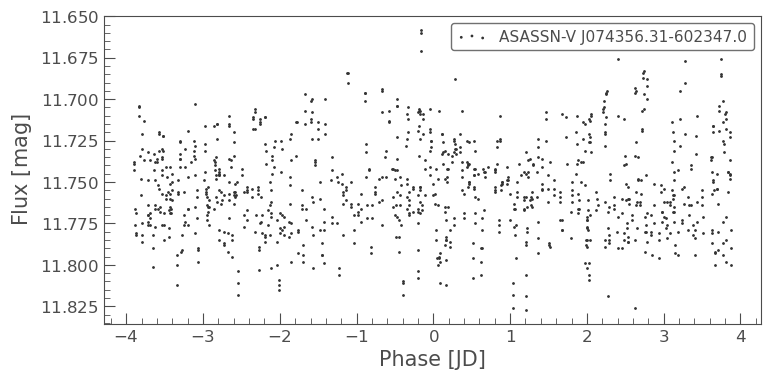

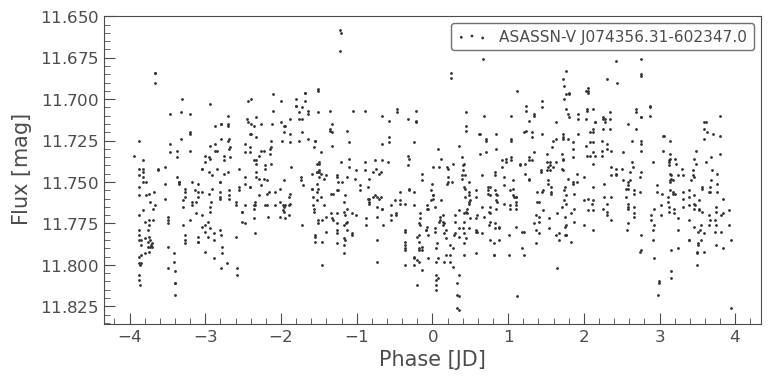

In [151]:
tplt.scatter(lc_combined_dict_masked["ASAS-SN_V"].fold(period=3.914 * 2));
tplt.scatter(lc_combined_dict_masked["ASAS-SN_V"].fold(period=3.9479 * 2));

lightkurve.Periodogram properties:
      Attribute                   Description            Units
---------------------- --------------------------------- -----
                nterms                                 1      
          default_view                         frequency      
                 label                     TIC 281581467      
             ls_method                              fast      
frequency_at_max_power                            0.2553 1 / d
             max_power                            0.0123   mag
               nyquist                          359.9712 1 / d
   period_at_max_power                            3.9165     d
             frequency                  array (2945133,) 1 / d
                period                  array (2945133,)     d
                 power                  array (2945133,)   mag
                  meta <class 'collections.OrderedDict'>      
              targetid                <class 'NoneType'>      


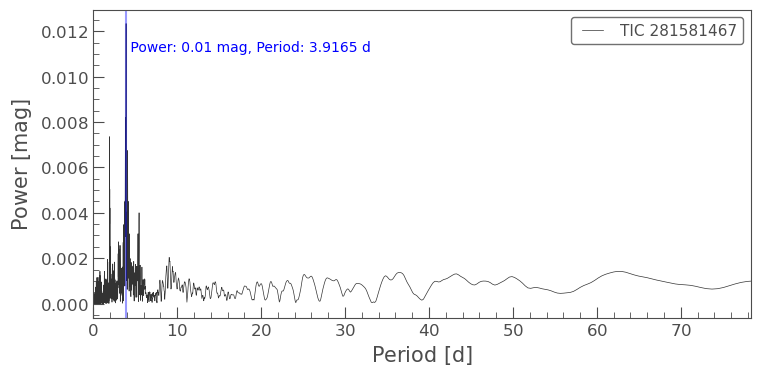

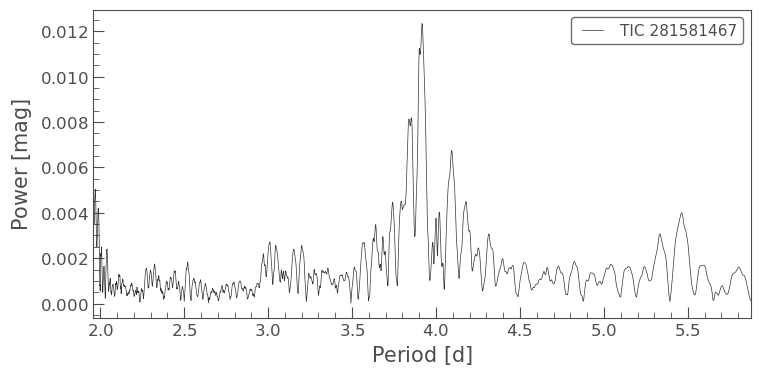

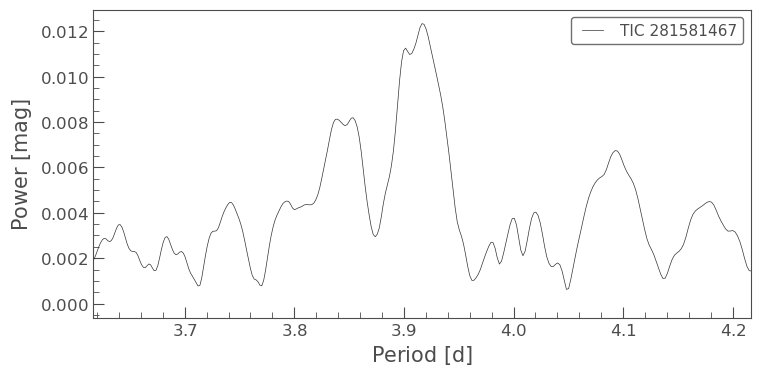

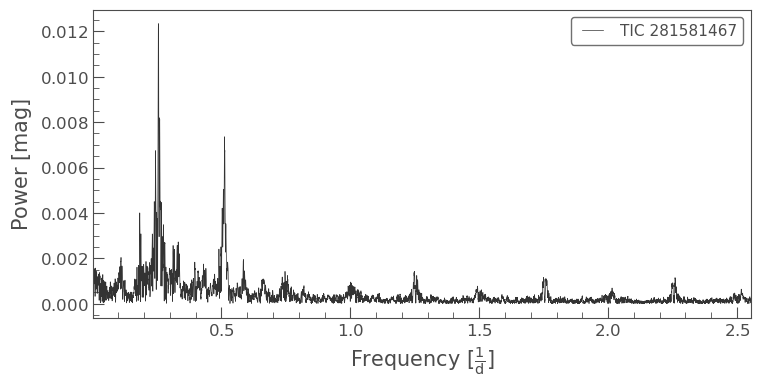

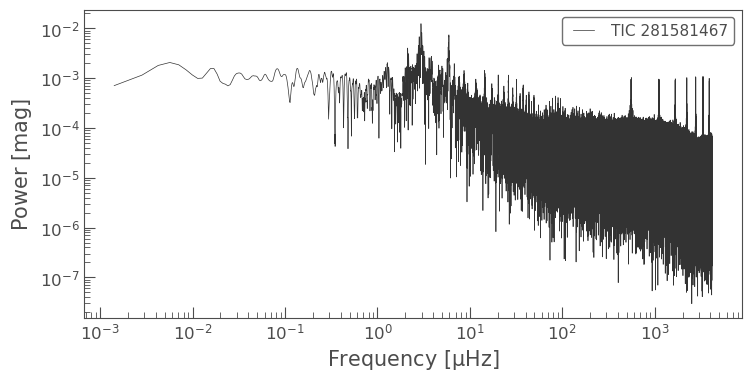

In [182]:
pg2 = (
    lc2_masked
        .to_periodogram(method="lombscargle"
#                        , minimum_period=.01, maximum_period=25,
                      )
)
pg2.show_properties();

lke_pg.plot_pg_n_mark_max(pg2, max_period_factor=20);

ax = pg2.plot(view="period")  # period view, zoom in around peak
ax.set_xlim(pg2.period_at_max_power.value / 2 , pg2.period_at_max_power.value * 3/2);

ax = pg2.plot(view="period")  # period view, further zoom in around peak
ax.set_xlim(pg2.period_at_max_power.value - 0.3 , pg2.period_at_max_power.value + 0.3);

ax = pg2.plot(view="frequency");  # frequency view
ax.set_xlim(pg2.frequency_at_max_power.value / 100 , pg2.frequency_at_max_power.value * 10);

# frequency in log scale / microhertz
ax = pg2.plot(view="frequency", unit=u.microhertz, scale="log");  

##### Possible rotational period changes over time

lightkurve.Periodogram properties:
      Attribute                   Description            Units
---------------------- --------------------------------- -----
                nterms                                 1      
              targetid                         281581467      
          default_view                            period      
                 label                     TIC 281581467      
             ls_method                              fast      
frequency_at_max_power                            0.2553 1 / d
             max_power                            0.0125   mag
               nyquist                          359.9712 1 / d
   period_at_max_power                            3.9172     d
             frequency                   array (503082,) 1 / d
                period                   array (503082,)     d
                 power                   array (503082,)   mag
                  meta <class 'collections.OrderedDict'>      


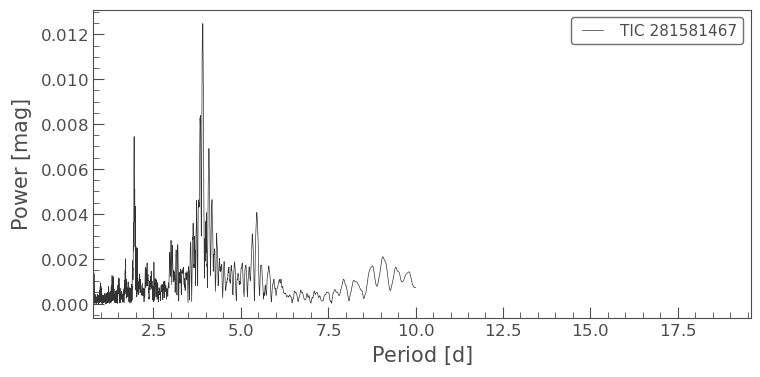

In [127]:
# scracth to try out different parameters / input
# ASAS-SN_V : 3.9479
# ASAS-SN_g : 3.9035
# TESS: 3.9172
_lc = lc_combined_dict_masked["TESS"]  #  ASAS-SN_V  # TESS
# _lc = lk.LightCurveCollection([lc for lc in lc_combined_dict_masked.values()]).stitch(corrector_func=lambda lc: lc)
_pg = (
    _lc
        .to_periodogram(method="lombscargle"
                       , minimum_period=.01, maximum_period=10,
                      )
)
_pg.show_properties();

ax = _pg.plot(view="period")  # period view, zoom in around peak
ax.set_xlim(_pg.period_at_max_power.value / 5 , _pg.period_at_max_power.value * 5);

C:\pkg\_winNonPortables\Anaconda3\envs\pht_eb_stats2\lib\site-packages\astropy\units\quantity.py:673: RuntimeWarning: invalid value encountered in sqrt
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)


lightkurve.Periodogram properties:
      Attribute                   Description            Units
---------------------- --------------------------------- -----
                nterms                                 1      
              targetid                         281581467      
          default_view                            period      
                 label             TIC 281581467 S1 - 13      
             ls_method                              fast      
frequency_at_max_power                            0.2501 1 / d
             max_power                            0.0172      
               nyquist                           24.0002 1 / d
   period_at_max_power                            3.9982     d
             frequency                   array (503115,) 1 / d
                period                   array (503115,)     d
                 power                   array (503115,)      
                  meta <class 'collections.OrderedDict'>      
lightkurve.Periodogr

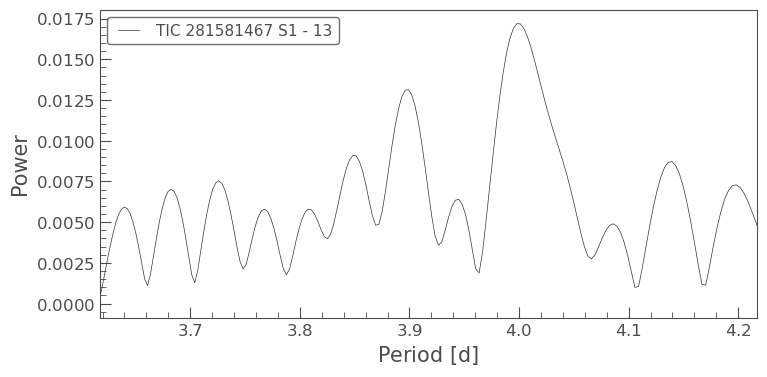

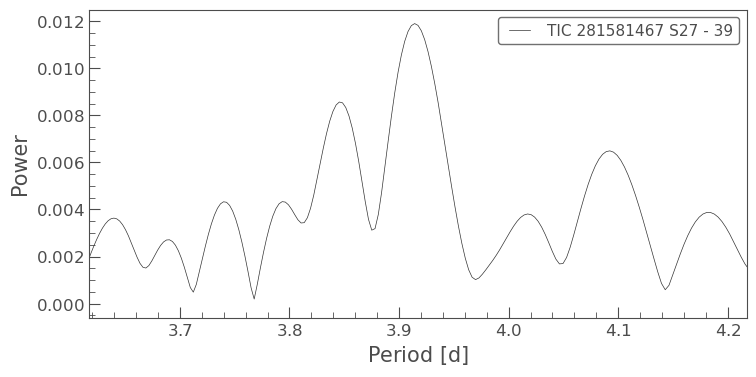

In [177]:
# The earlier TESS data seems to have slightly different period from the later one too
# Use the same period grid for both for fairer comparison
# sectors 1 - 13 (TESS-SPOC): ~4.00 d
# sectors 27 - 39 (SPOC):     ~3.91 d

_lc0 = lke.stitch(lcf_coll)
_pg0 = _lc0.to_periodogram(method="lombscargle", minimum_period=.01, maximum_period=10,)
                  
_lc1 = lke.stitch(lke.select(lcf_coll, lambda lc: lc.sector <= 13))
_lc1.label = f"{_lc0.label} S1 - 13"
# tplt.scatter(_lc1)
_pg1 = _lc1.to_periodogram(method="lombscargle", period=_pg0.period)
_pg1.show_properties();
ax = _pg1.plot(view="period")  # period view, zoom in around peak
ax.set_xlim(_pg0.period_at_max_power.value -0.3,  _pg0.period_at_max_power.value +0.3);

_lc2 = lke.stitch(lke.select(lcf_coll, lambda lc: lc.sector > 13))
_lc2.label = f"{_lc0.label} S27 - 39"
# tplt.scatter(_lc1)
_pg2 = _lc2.to_periodogram(method="lombscargle", period=_pg0.period)
_pg2.show_properties();
ax = _pg2.plot(view="period")  # period view, zoom in around peak
ax.set_xlim(_pg0.period_at_max_power.value -0.3,  _pg0.period_at_max_power.value +0.3);

In [190]:
for t_start in [2458200, 2458600, 2459000, 2459400]:
    lc_trunc = lc_combined.truncate(t_start, t_start + 400)
    pg_trunc = lc_trunc.to_periodogram(method="lombscargle", period=_pg0.period)
    print(f"HJD {t_start}, ~400 d window ({round(lc_trunc.time.max().value - lc_trunc.time.min().value, 0)})")
    pg_trunc.show_properties();    

HJD 2458200, ~400 d window (400.0)
lightkurve.Periodogram properties:
      Attribute                   Description            Units
---------------------- --------------------------------- -----
                nterms                                 1      
              targetid                         281581467      
          default_view                            period      
                 label      ASASSN-V J074356.31-602347.0      
             ls_method                              fast      
frequency_at_max_power                            0.2505 1 / d
             max_power                            0.0166   mag
               nyquist                           24.0004 1 / d
   period_at_max_power                            3.9918     d
             frequency                   array (503115,) 1 / d
                period                   array (503115,)     d
                 power                   array (503115,)   mag
                  meta <class 'collections.Order

##### Final rotation period to use

In [48]:
# ANOVA result from VStar, with period range around LS period above
# range: 3.88 , 3.95 d, resolution: 0.00001, bin: 16
rot_period_aov = 3.9159
rot_period_aov_2nd_peak = 3.9165  # second peak very close, and is approximately the LS Periodgram period

3.914 2459329.97 2459329.97


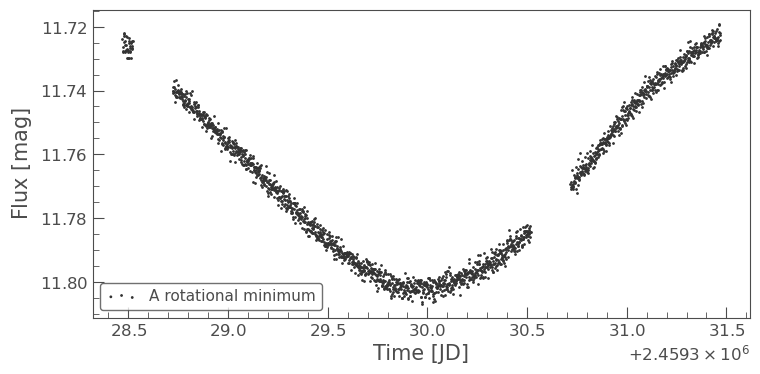

In [210]:
# rotational period to be use in plots and reports
# Note: it should be rounded to the expeced precision so that the plot and the paramters in the table will use the same exact value

# rot_period_to_report = round(pg2.period_at_max_power.to(u.day).value, 3)  # pg2: from TESS + ASAS-SN, zero-shifted to ASAS-SN_V
# rot_period_to_report = round(rot_period_aov, 3)
# rot_epoch_btjd = 2330  # an approximation by visual inspection
# rot_epoch = Time(rot_epoch_btjd, format="btjd") # to feed to the fold plot
# rot_epoch_hjd = round(lket.btjd_to_hjd_utc(rot_epoch, f"{target_ra}, {target_dec}"), 4) # used in VSX report table

# rot_period_to_report = 3.9035  # from Sebastián O.'s analysis based on ASAS-SN
# rot_period_to_report = 3.91409  # AoV top hit from VStar, based on TESS + ASAS-SN (eclipses masked)
# rot_period_to_report = 3.91472  # AoV top hit from VStar, based on TESS + ASAS-SN (including eclipses)
rot_period_to_report = 3.914 # from Sebastián O. considering ASAS-SN and TESS 2-min cadence, knowing the period from the earlier ASAS-SN V is somewhat different

# pick one minimum
lc_tess_masked = lc_combined_dict_masked["TESS"]
lc_tess_masked_min_mag = lc_tess_masked.flux.max()
lc_tess_masked_min_time = round(lc_tess_masked[lc_tess_masked.flux == lc_tess_masked_min_mag].time[0].value, 2)
ax = tplt.scatter(lc_tess_masked.truncate(lc_tess_masked_min_time - 1.5,lc_tess_masked_min_time + 1.5), label="A rotational minimum");

rot_epoch_hjd = lc_tess_masked_min_time 
rot_epoch = Time(rot_epoch_hjd, format="jd", scale="utc") # to feed to the fold plot

print(rot_period_to_report, rot_epoch, rot_epoch_hjd);

##### Phase Plot for rotation

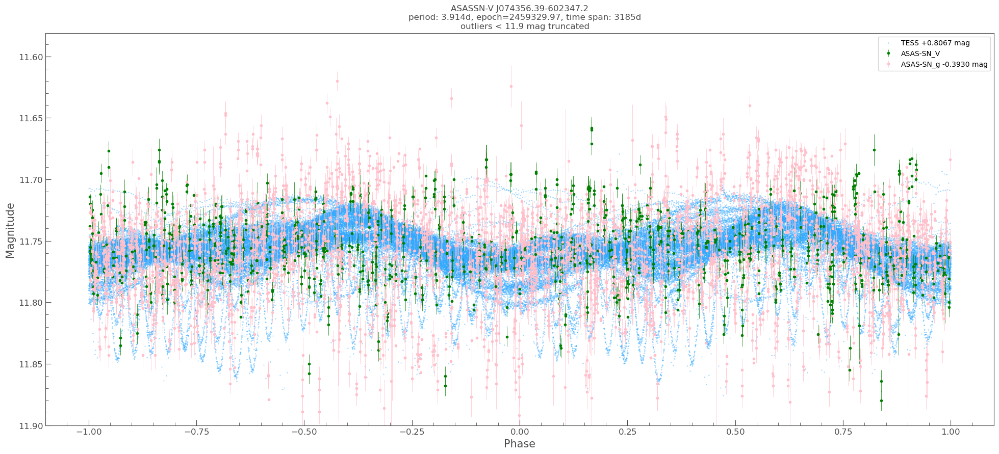

In [211]:
# Phase plot for rotation of TESS and ASAS-SN

ax, lc_f_res = fold_n_plot_tess_n_asassn(
    lc_combined_dict,
    period=rot_period_to_report,
    epoch=rot_epoch,
    phase_scale=2,  #  fold at  period, i.e., plot from phase -1 to +1
    target_coord=dict(ra=target_ra, dec=target_dec),
    figsize=(24, 10),
    target_name=primary_name, # use VSX-preferred name    
);
ax.set_title(ax.get_title() + "outliers < 11.9 mag truncated");
ax.set_ylim(11.9, None);

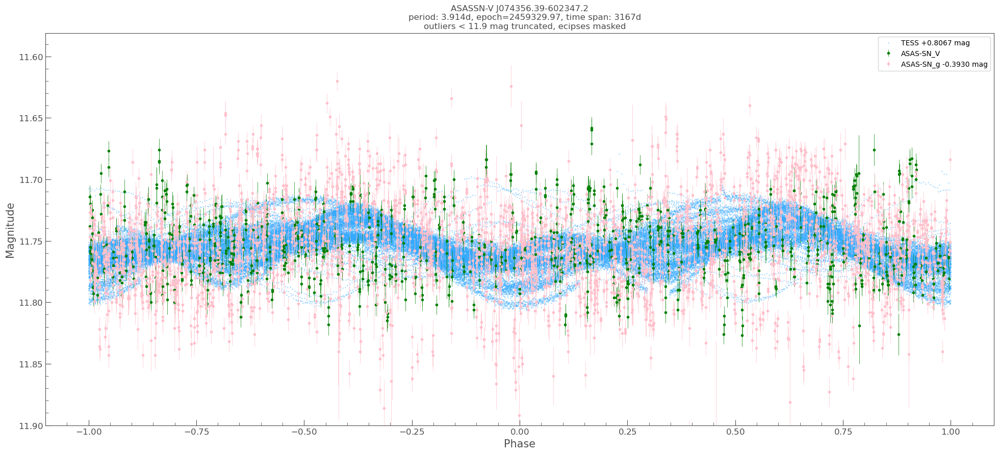

In [212]:
# Phase plot for rotation of TESS and ASAS-SN, eclipses masked

ax, lc_f_res = fold_n_plot_tess_n_asassn(
    lc_combined_dict_masked,
    period=rot_period_to_report,
    epoch=rot_epoch,
    phase_scale=2,  #  fold at  period, i.e., plot from phase -1 to +1
    target_coord=dict(ra=target_ra, dec=target_dec),
    figsize=(24, 10),
    target_name=primary_name, # use VSX-preferred name    
);
ax.set_title(ax.get_title() + "outliers < 11.9 mag truncated, ecipses masked");
ax.set_ylim(11.9, None);

###### Separate TESS / ASAS-SN plots for easier visualization

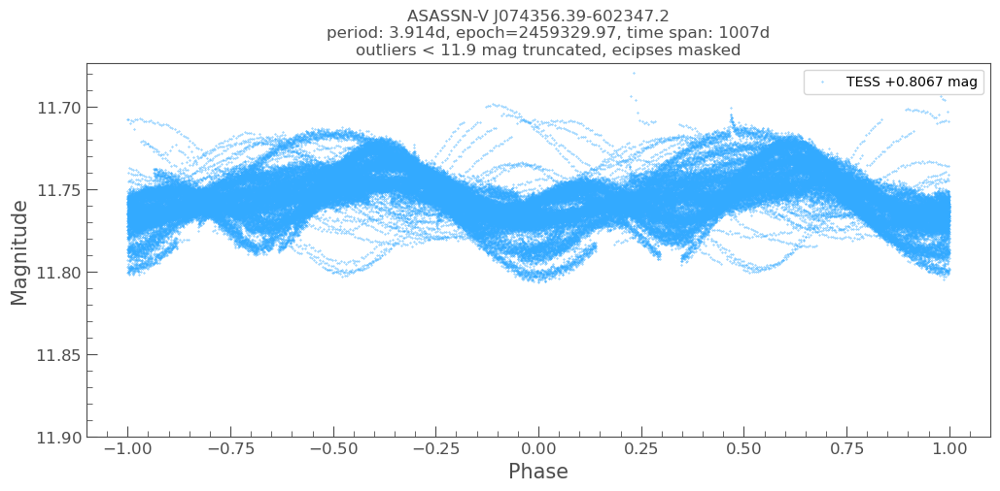

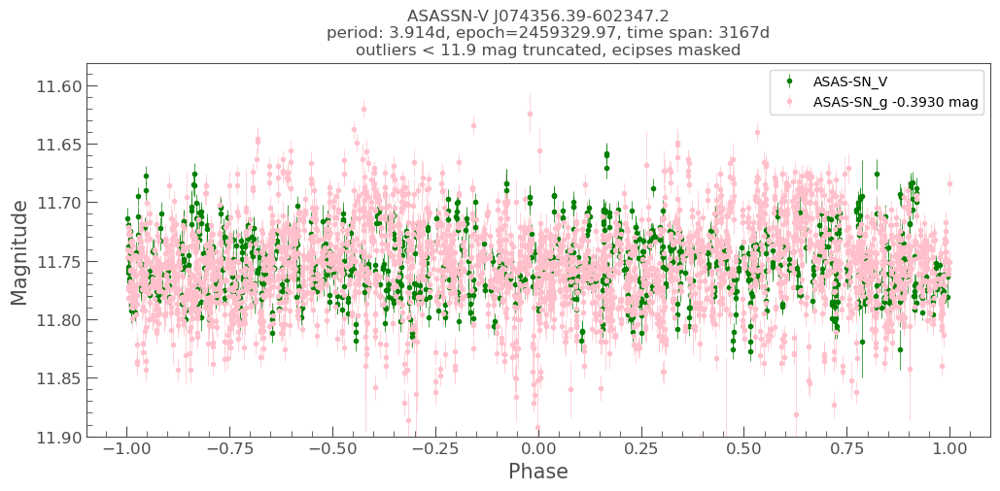

In [216]:
ax, lc_f_res = fold_n_plot_tess_n_asassn(
    {band: lc for (band, lc) in lc_combined_dict_masked.items() if band == "TESS"},
    period=rot_period_to_report,
    epoch=rot_epoch,
    phase_scale=2,  #  fold at  period, i.e., plot from phase -1 to +1
    target_coord=dict(ra=target_ra, dec=target_dec),
    figsize=(12, 5),
    target_name=primary_name, # use VSX-preferred name    
);
ax.set_title(ax.get_title() + "outliers < 11.9 mag truncated, ecipses masked");
ax.set_ylim(11.9, None);

ax, lc_f_res = fold_n_plot_tess_n_asassn(
    {band: lc for (band, lc) in lc_combined_dict_masked.items() if band != "TESS"},
    period=rot_period_to_report,
    epoch=rot_epoch,
    phase_scale=2,  #  fold at  period, i.e., plot from phase -1 to +1
    target_coord=dict(ra=target_ra, dec=target_dec),
    figsize=(12, 5),
    target_name=primary_name, # use VSX-preferred name    
);
ax.set_title(ax.get_title() + "outliers < 11.9 mag truncated, ecipses masked");
ax.set_ylim(11.9, None);

##### Phase Plots for various rotation period candidates

In [85]:
#### Customized fold and plot for ad hoc analysis
def fold_n_plot_tess_n_asassn2(lc_combined_dict, period, epoch: Time, phase_scale, target_coord, figsize=(8,4), target_name=None, ax=None):
    def fold_at_scale(lc, **kwargs):
        if lc is None:
            return None
        kwargs = kwargs.copy()
        kwargs["period"] = kwargs["period"] * phase_scale
        lc_f = lc.fold(**kwargs)
        return lc_f

    from astropy.coordinates import SkyCoord
    
    if epoch.format == "jd" and epoch.scale == "utc":
        # if already in HJD UTC, avoid unnecesary conversion which would also have underisable effect on precision
        epoch_hjd = epoch
    else:
        epoch_hjd = lke.to_hjd_utc(epoch, SkyCoord(target_coord["ra"], target_coord["dec"], unit=(u.deg, u.deg), frame="icrs"))

    lc_tess_f = fold_at_scale(lc_combined_dict.get("TESS"), epoch_time=epoch_hjd, period=period, normalize_phase=True)
    lc_asassn_v_f = fold_at_scale(lc_combined_dict.get("ASAS-SN_V"), epoch_time=epoch_hjd, period=period, normalize_phase=True)
    lc_asassn_g_f = fold_at_scale(lc_combined_dict.get("ASAS-SN_g"), epoch_time=epoch_hjd, period=period, normalize_phase=True)
    
    if ax is None:
        ax = tplt.lk_ax(figsize=figsize)
    
    ax.invert_yaxis();
    
    if lc_tess_f is not None and len(lc_tess_f) > 0:
        ax.scatter(lc_tess_f.time * phase_scale, lc_tess_f.flux.value, c="#3AF", s=0.1, alpha=1.0, label=get_label_of_source(lc_combined_dict, "TESS"));

    if lc_asassn_v_f is not None and len(lc_asassn_v_f) > 0:
        ax.scatter(lc_asassn_v_f.time * phase_scale, lc_asassn_v_f.flux.value, c="green", s=4.0, alpha=1.0, label=get_label_of_source(lc_combined_dict, "ASAS-SN_V"));
#         ax.errorbar(
#             x=lc_asassn_v_f.time * phase_scale, y=lc_asassn_v_f.flux.value,  yerr=lc_asassn_v_f.flux_err.value, 
#             marker=".", c="green", linewidth=0.5, ls="none", 
#             label=get_label_of_source(lc_combined_dict, "ASAS-SN_V")
#         );

    if lc_asassn_g_f is not None and len(lc_asassn_g_f) > 0:
        ax.scatter(lc_asassn_g_f.time * phase_scale, lc_asassn_g_f.flux.value, c="pink", s=4.0, alpha=1.0, label=get_label_of_source(lc_combined_dict, "ASAS-SN_g"));
#         ax.errorbar(
#             x=lc_asassn_g_f.time * phase_scale, y=lc_asassn_g_f.flux.value,  yerr=lc_asassn_g_f.flux_err.value, 
#             marker=".", c="pink", linewidth=0.5, ls="none", 
#             label=get_label_of_source(lc_combined_dict, "ASAS-SN_g")
#         );
    

    ax.legend();
    ax.set_xlabel("Phase");
    ax.set_ylabel("Magnitude");
    time_all = np.array([])
    if lc_tess_f is not None:
        time_all = np.concatenate([time_all, lc_tess_f.time_original.to_value("jd")])
    if lc_asassn_v_f is not None:
        time_all = np.concatenate([time_all, lc_asassn_v_f.time_original.to_value("jd")])
    if lc_asassn_g_f is not None:
        time_all = np.concatenate([time_all, lc_asassn_g_f.time_original.to_value("jd")])
    plot_time_span = time_all.max() - time_all.min()
    ax.set_title(f"""{target_name}
    period: {period}d, epoch={epoch_hjd.value}, time span: {plot_time_span:.0f}d
    """);
    
    return ax, {"TESS": lc_tess_f, "ASAS-SN_V": lc_asassn_v_f, "ASAS-SN_g": lc_asassn_g_f}


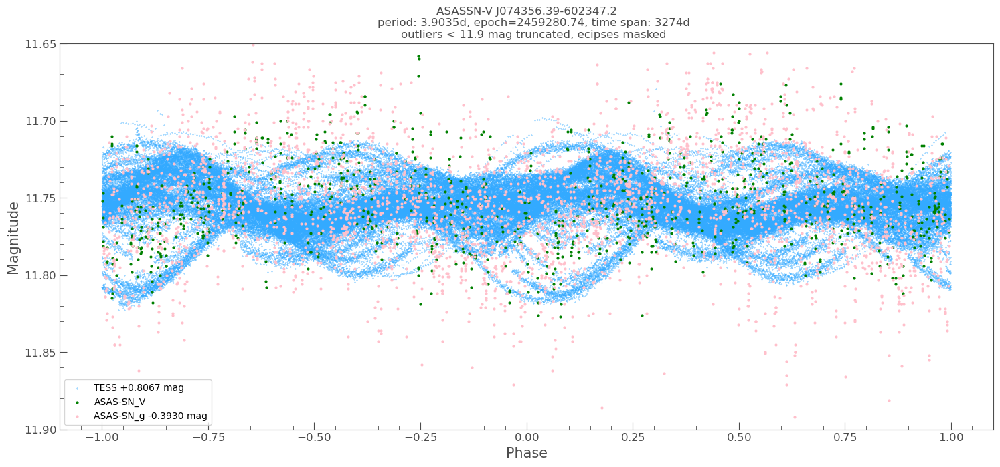

In [88]:
#### 

for period_to_plot in [ 
    3.9035,  # the period from sebastain based on playing ASAS-SN
]:
    ax, lc_f_res = fold_n_plot_tess_n_asassn(
        lc_combined_dict_masked,
        period=period_to_plot,
        epoch=rot_epoch,
        phase_scale=2,  #  fold at  period, i.e., plot from phase -1 to +1
        target_coord=dict(ra=target_ra, dec=target_dec),
        figsize=(18, 7.5),
        target_name=primary_name, # use VSX-preferred name    
    );
    ax.set_title(ax.get_title() + "outliers < 11.9 mag truncated, ecipses masked");
    ax.set_ylim(11.9, None);


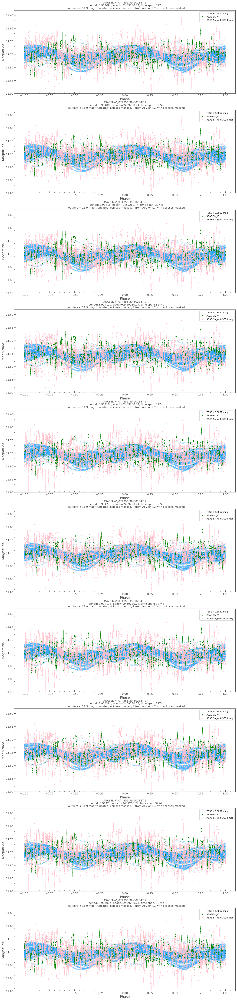

In [126]:
####
periods_to_plot = [
    # top hits from AoV based on TESS+ASAS-SN, with eclipses masked
    3.91409, 3.91408,  3.9141, 3.91411, 3.91418, 3.91427, 3.91417, 3.91428, 3.9142, 3.91407,
]

with plt.style.context(lk.MPLSTYLE):
    fig, axs = plt.subplots(len(periods_to_plot), 1, figsize=(18, (0.5 + 7.5) * len(periods_to_plot)), )

for period_to_plot,ax  in zip(periods_to_plot, axs):
    ax, lc_f_res = fold_n_plot_tess_n_asassn(
        lc_combined_dict_masked,
        period=period_to_plot,
        epoch=rot_epoch,
        phase_scale=2,  #  fold at  period, i.e., plot from phase -1 to +1
        target_coord=dict(ra=target_ra, dec=target_dec),
        ax=ax,
        target_name=primary_name, # use VSX-preferred name    
    );
    ax.set_title(ax.get_title() + "outliers < 11.9 mag truncated, ecipses masked, P from AoV on LC with eclipses masked");
    ax.set_ylim(11.9, None);


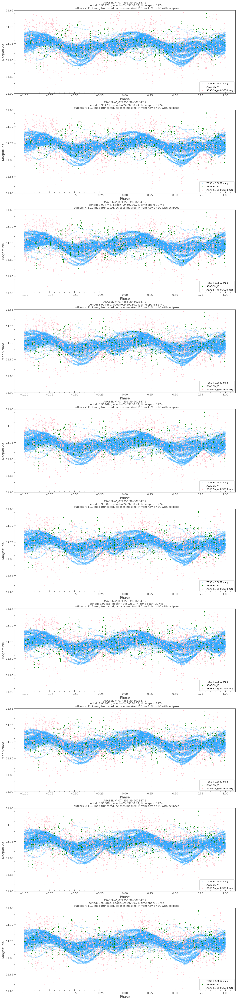

In [102]:
####
periods_to_plot = [
    # top hits from AoV based on TESS+ASAS-SN, including eclipses
    3.91472, 3.91473, 3.91474, 3.91448, 3.91449, 3.91387, 3.9145, 3.91447, 3.91388, 3.91386
]

with plt.style.context(lk.MPLSTYLE):
    fig, axs = plt.subplots(len(periods_to_plot), 1, figsize=(18, (0.5 + 7.5) * len(periods_to_plot)), )

for period_to_plot,ax  in zip(periods_to_plot, axs):
    ax, lc_f_res = fold_n_plot_tess_n_asassn(
        lc_combined_dict_masked,
        period=period_to_plot,
        epoch=rot_epoch,
        phase_scale=2,  #  fold at  period, i.e., plot from phase -1 to +1
        target_coord=dict(ra=target_ra, dec=target_dec),
#         figsize=(18, 7.5),
        ax=ax,
        target_name=primary_name, # use VSX-preferred name    
    );
    ax.set_title(ax.get_title() + "outliers < 11.9 mag truncated, ecipses masked, P from AoV on LC with eclipses");
    ax.set_ylim(11.9, None);

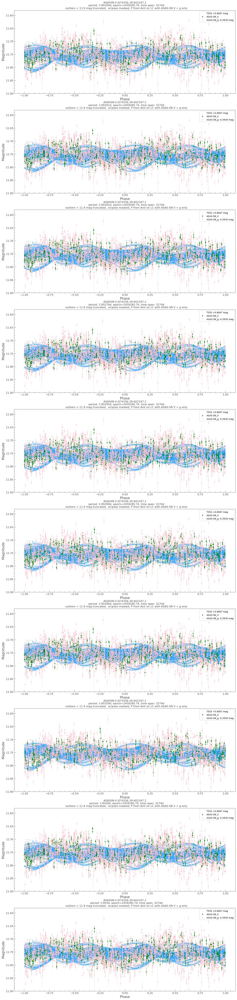

In [127]:
####
periods_to_plot = [
    # top hits from AoV based on ASAS-SN V + g, including eclipses
    3.90294, 3.90281, 3.90291, 3.90279, 3.90295, 3.90299, 3.90286, 3.90359, 3.9028, 3.903
]

with plt.style.context(lk.MPLSTYLE):
    fig, axs = plt.subplots(len(periods_to_plot), 1, figsize=(18, (0.5 + 7.5) * len(periods_to_plot)), )

for period_to_plot,ax  in zip(periods_to_plot, axs):
    ax, lc_f_res = fold_n_plot_tess_n_asassn(
        lc_combined_dict_masked,
        period=period_to_plot,
        epoch=rot_epoch,
        phase_scale=2,  #  fold at  period, i.e., plot from phase -1 to +1
        target_coord=dict(ra=target_ra, dec=target_dec),
#         figsize=(18, 7.5),
        ax=ax,
        target_name=primary_name, # use VSX-preferred name    
    );
    ax.set_title(ax.get_title() + "outliers < 11.9 mag truncated,  ecipses masked, P from AoV on LC with ASAS-SN V + g only");
    ax.set_ylim(11.9, None);

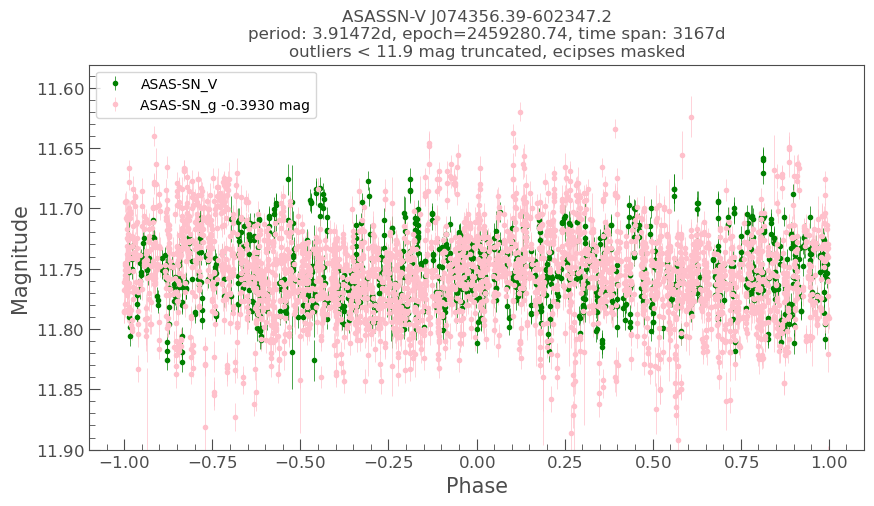

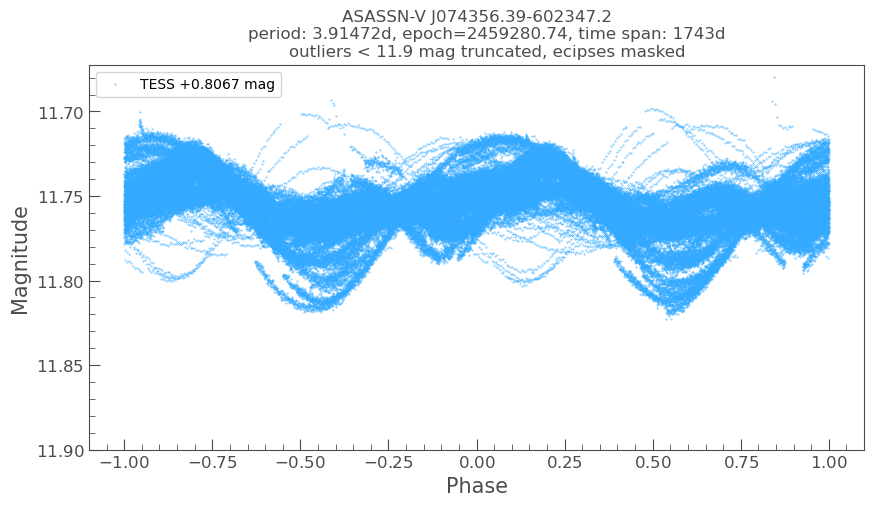

In [125]:
# Visaulize  TESS / ASAS-SN data separately
period_to_plot = 3.91472  # rot_period_to_report

_tmp_lc_dict = lc_combined_dict_masked.copy()
_tmp_lc_dict.pop("TESS")

ax, lc_f_res = fold_n_plot_tess_n_asassn(
    _tmp_lc_dict,
    period=period_to_plot,
    epoch=rot_epoch,
    phase_scale=2,  #  fold at  period, i.e., plot from phase -1 to +1
    target_coord=dict(ra=target_ra, dec=target_dec),
    figsize=(10, 5),
    target_name=primary_name, # use VSX-preferred name    
);
ax.set_title(ax.get_title() + "outliers < 11.9 mag truncated, ecipses masked");
ax.set_ylim(11.9, None);


_tmp_lc_dict = dict(TESS=lc_combined_dict_masked["TESS"])
ax, lc_f_res = fold_n_plot_tess_n_asassn(
    _tmp_lc_dict,
    period=period_to_plot,
    epoch=rot_epoch,
    phase_scale=2,  #  fold at  period, i.e., plot from phase -1 to +1
    target_coord=dict(ra=target_ra, dec=target_dec),
    figsize=(10, 5),
    target_name=primary_name, # use VSX-preferred name    
);
ax.set_title(ax.get_title() + "outliers < 11.9 mag truncated, ecipses masked");
ax.set_ylim(11.9, None);

Windows separated by:  [1400  200  700   80  520]


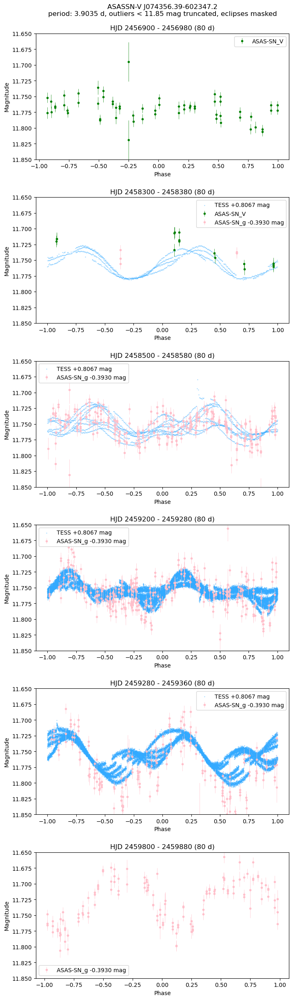

In [53]:
# Phase Plots, zoom over a 80 day window

times_z = np.array([2456900, 2458300, 2458500, 2459200, 2459280, 2459800])
window_z = 80  # ~ 20 cycles

fig, axs = plt.subplots(len(times_z), 1, figsize=(8, 5 * len(times_z)))
plt.subplots_adjust(hspace=0.3);

for ax, t in zip(axs, times_z):
    time_min, time_max = t, t + window_z
    ax, lc_f_res = fold_n_plot_tess_n_asassn(
        truncate_lc_dict(lc_combined_dict_masked, time_min, time_max),
        period=rot_period_to_report,
        epoch=rot_epoch,
        phase_scale=2,  #  fold at  period, i.e., plot from phase -1 to +1
        target_coord=dict(ra=target_ra, dec=target_dec),
        target_name=primary_name, # use VSX-preferred name    
        ax=ax,
    );
    ax.set_title(f"HJD {time_min} - {time_max} ({window_z} d)");
    ax.set_ylim(11.85, 11.65);

axs[0].set_title(f"""{primary_name}\nperiod: {rot_period_to_report} d, outliers < 11.85 mag truncated, eclipses masked\n\n{axs[0].get_title()}""");
print("Windows separated by: ", np.diff(times_z))

##### Redfine some report outputs, after combinding TESS and ASAS-SN data

In [214]:
def calc_mag_range_combined():
    all_mag = np.concatenate([lc_combined_dict["ASAS-SN_V"].flux.value])  # use ASAS-SN V only for now, lc_f_res["TESS"].flux.value, 
    return [all_mag.min(), all_mag.max()]

mag_range_combined = calc_mag_range_combined()
mag_range_combined[1] = 11.87  # override, after vvisual inspection and feedback from Sebastián O


def get_mag_range_mag_text():
    return f"Mag. range: {mag_range_combined[0]:.2f} - {mag_range_combined[1]:.2f} V"


# remarks = f"{get_mag_range_mag_text()} . Rotational period: {lc_add_var_f.meta['PERIOD']:.5f} . Some flares."

def summarize_deep_eclipse():
    return (f"Min I amplitude: {lke.ratio_to_mag(depth_deep):.3f} TESS.")

def summarize_shallow_eclipse():
    return (f"Min II epoch: {lket.btjd_to_hjd_utc(transit_specs[1]['epoch'], target_position):.4f}"
            f", duration: {100 * transit_specs[1]['duration_hr'] / 24 / transit_specs[1]['period']:.0f}%"
            f", amplitude: {lke.ratio_to_mag(depth_shallow):.3f} TESS.")


def print_mag_range_by_band(lc_dict):
    for k in lc_dict.keys():
        mags = lc_dict[k].flux.value
        print(f"{k}:\t {mags.min():.2f} - {mags.max():.2f}")
        
print_mag_range_by_band(lc_combined_dict)  # The TESS, ASAS-SN_g is shifted to ASAS-SN V zero point.
print(f"Mag range to report: {mag_range_combined[0]:.2f} - {mag_range_combined[1]:.2f}" )


# rotational period is in 3 decimals given how imprecise it is.
remarks = f"{summarize_deep_eclipse()} Orbital elements given in the table. Small flares with amplitudes up to 0.04 TESS. Rotational epoch: HJD {rot_epoch_hjd}, period: {rot_period_to_report} d; longer in older ASAS-SN V data." 
# f"{summarize_shallow_eclipse()}"  Min II not needed for circular orbit  
# f"" TODO: re-add it along with epoch of min once it's deteremined
remarks

TESS:	 11.68 - 11.88
ASAS-SN_V:	 11.66 - 11.88
ASAS-SN_g:	 11.62 - 12.09
Mag range to report: 11.66 - 11.87


'Min I amplitude: 0.077 TESS. Orbital elements given in the table. Small flares with amplitudes up to 0.04 TESS. Rotational epoch: HJD 2459329.97, period: 3.914 d; longer in older ASAS-SN V data.'

### VSX Report Table
<a name="vsx_report"></a>

In [215]:
# reload(vetting_utils)


other_names = ",2MASS J07435638-6023471"  # names to be added from TIC
other_names += ",GSC 08911-00718"  # GSC search: https://vizier.cds.unistra.fr/viz-bin/VizieR-5?-ref=VIZ63b8be1817957b&-out.add=.&-source=I/255/out&GSC=0891100718
other_names += ",CD-60 1851"  # CD search: https://vizier.cds.unistra.fr/viz-bin/VizieR-5?-ref=VIZ63b8bd0716ed37&-out.add=.&-source=I/114/cd&recno=565569
# No need to re-add existing names # other_names = ",ASASSN-V J074356.31-602347.0,TYC 8911-718-1,WISEA J074356.30-602347.2" + other_names  # prepend existing other names in the VSX record

# include Gaia DR3 ID if it is in Gaia DR3 Variable
extra_names_gaia_dr3 = ""
if len(all_meta.gaia) > 0 and not pd.isna(all_meta.gaia["Class"].iloc[0]):
    extra_names_gaia_dr3 = f",Gaia DR3 {all_meta.gaia['Source'].iloc[0]}"


BIBS = vetting_utils.BIBS

vsx_report = dict(
    Position=target_position,
    Primary_Name=primary_name,
    Other_Names=f"TIC {tic}{other_names}{extra_names_gaia_dr3}",  # addition to existing ones for updates
    Variable_Type=variable_type,
    Spectral_Type="K",  # from Gaia DR3 astrophysical parameters
    Spectral_Type_Uncertain=False,
    Maximum_Magnitude=f"{mag_range_combined[0]:.2f}",
    Maximum_Magnitude_band="V",
    Minimum_Magnitude=f"{mag_range_combined[1]:.2f}",
    Minimum_Magnitude_band="V",
    Minimum_Is_Amplitude=False,
    Period=main_period_to_report,
    Epoch=main_epoch_to_report,
    Rise_Duration_Pct=f"{100 * transit_specs[0]['duration_hr'] / 24 / main_period_to_report:.0f}",  
    Discoverer="", 
    Remarks=remarks,
    Revision_Comment="Type, periods, epoch, duration, and range from TESS and ASAS-SN data. Spectral type and position from Gaia DR3.", 
    Reference1_Name=BIBS.TESS_N,
    Reference1_Bib=BIBS.TESS_B,
    Reference2_Name=BIBS.TESS_SPOC_N,
    Reference2_Bib=BIBS.TESS_SPOC_B,
# TCE is too much details for submission.
#     Reference3_Name=BIBS.TCE_N(2021),  # published in 2021, per https://archive.stsci.edu/missions/tess/doc/tess_drn/tess_multisector_01_39_drn58_v02.pdf
#     Reference3_Link="https://exo.mast.stsci.edu/exomast_planet.html?planet=TIC281581467S0001S0039TCE1",  # TCE1
    Reference4_Name=BIBS.ASAS_SN_N,
    Reference4_Bib=BIBS.ASAS_SN_B,
    Reference5_Name=BIBS.GAIA_DR3_ASTROPHY_N,
    Reference5_Bib=BIBS.GAIA_DR3_ASTROPHY_B,
#     Reference5_Name=BIBS.GAIA_DR3_N,
#     Reference5_Bib=BIBS.GAIA_DR3_B,
#     Reference6_Name=BIBS.GAIA_DR3_VAR_N,
#     Reference6_Bib=BIBS.GAIA_DR3_VAR_B,
#     Reference7_Name=BIBS.TIC_N,
#     Reference7_Bib=BIBS.TIC_B,
)

def print_long_fields(report):
    other_names_list = report["Other_Names"].split(",")
    print("Other Names (1 line each):")
    print("\n".join(other_names_list))
    print("")
    print(report["Remarks"])
    print("")
    print(report["Revision_Comment"])

print_long_fields(vsx_report)
with pd.option_context('display.max_colwidth', None):
    display(report_to_df(vsx_report))

# Uploaded plots with  descriptions
print("""
tic281581467_combined_lc.png : Combined light curve - Combined light curve with ASAS-SN and TESS data.
tic281581467_phase_plot_eclipses.png : EA Phase Plot - Phase plot for EA variability from ASAS-SN and TESS shifted to V standard.
tic281581467_phase_plot_rotation_eclipses_masked.png : Rotation Phase Plot - Phase plot for rotational variability from ASAS-SN and TESS shifted to V standard, eclipses masked.
tic281581467_lc_flare_zoom.png :  Light curve, (zoomed at a flare) - Light Curve with TESS data, zoomed at a flare.
""")

Other Names (1 line each):
TIC 281581467
2MASS J07435638-6023471
GSC 08911-00718
CD-60 1851
Gaia DR3 5292492417071590528

Min I amplitude: 0.077 TESS. Orbital elements given in the table. Small flares with amplitudes up to 0.04 TESS. Rotational epoch: HJD 2459329.97, period: 3.914 d; longer in older ASAS-SN V data.

Type, periods, epoch, duration, and range from TESS and ASAS-SN data. Spectral type and position from Gaia DR3.


,Field,Value
0,Position,"115.98497785607, -60.39644662543"
1,Primary_Name,ASASSN-V J074356.39-602347.2
2,Other_Names,"TIC 281581467,2MASS J07435638-6023471,GSC 08911-00718,CD-60 1851,Gaia DR3 5292492417071590528"
3,Variable_Type,EA+BY
4,Spectral_Type,K
5,Spectral_Type_Uncertain,False
6,Maximum_Magnitude,11.66
7,Maximum_Magnitude_band,V
8,Minimum_Magnitude,11.87
9,Minimum_Magnitude_band,V



tic281581467_combined_lc.png : Combined light curve - Combined light curve with ASAS-SN and TESS data.
tic281581467_phase_plot_eclipses.png : EA Phase Plot - Phase plot for EA variability from ASAS-SN and TESS shifted to V standard.
tic281581467_phase_plot_rotation_eclipses_masked.png : Rotation Phase Plot - Phase plot for rotational variability from ASAS-SN and TESS shifted to V standard, eclipses masked.
tic281581467_lc_flare_zoom.png :  Light curve, (zoomed at a flare) - Light Curve with TESS data, zoomed at a flare.



## External Supporting Information
<a name="external_docs">

### TCEs

- Many, representative ones: 
  - [s0001-s0039:TCE1](https://exo.mast.stsci.edu/exomast_planet.html?planet=TIC281581467S0001S0039TCE1)
  - it captures both primary  and secondary eclipses. 
  - Epoch / period can be derived from it.
  - Eclipse depth is not trustworthy.
  
- They show the centroid is on target, e.g., 
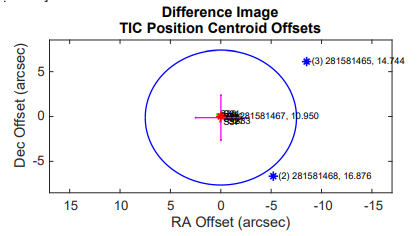

  
### TESS EB Catalog

- In TESS EB Catalog: N/A

### Gaia DR3 Variable

- https://vizier.cds.unistra.fr/viz-bin/VizieR-5?-ref=VIZ637b06ea2cc351&-out.add=.&-source=I/358/vclassre&recno=6259452&-out.orig=o
- it has `RS` classification, with limited additional information (period, magnitude range, etc.)	 
